# How Music Moves Movies

Hit musical numbers from the blockbuster movies ‘Dilwale Dulhania Le Jayenge’ and ‘Titanic’ continue to occupy a special place in people’s hearts even today. This might make you think: What are the secret ingredients of music that enrapture all of us and how does it add magic to the movies? With this thought in mind, we will use the CMU Movie Summary Corpus and our Spotify Dataset to find out the dominant music attributes (danceability, energy, liveness, etc.) in different countries across the world so as to possibly reveal country-specific music styles for the top 3 countries (in our combined movie and music dataset). Subsequently, we will observe the change in music features and their interplay with the changes in the emotions portrayed by movies in the top 2 countries (in our combined movie, music and emotion dataset) across the years. Finally, we will connect all the dots to reveal how music moves movies towards success.

 # Table of Contents  
1. [RQ1: Deciphering the Links between Music Features and Countries](#0)
    1. [Movies Metadata Dataset (from CMU Movie Summary Corpus)](#0)
        1. [Loading the Dataset and Performing Preliminary Data Analysis](#0)
        1. [Removal of Duplicate Records](#1)
        1. [Descriptive Statistics](#3)
        1. [Inflation Adjustment of Box Office Revenues of Movies ](#4)
        1. [Data Visualization](#5)
    1. [Spotify Dataset](#6)
        1. [Loading the Scraped Dataset](#7)
        1. [Data Analysis](#8)
    1. [The Movie Metadata Dataset + Our Spotify Dataset](#9)
        1. [Merging the 2 Datasets](#9)
    1. [Data Visualization and Analysis](#10)
    1. [Performing T-tests for Identifying Country-Specific Music](#11)
1. [RQ2: Connecting Music with Emotions Portrayed by Movies](#12)
    1. [Loading the Movie Plot Summaries Dataset](#12)
        1. [Pre-Processing and Analysis of the Movie Plot Emotions](#13)
        1. [India: Emotions and Music](#14)
            1. [Cointegration Tests](#15)
        1. [USA: Emotions and Music](#16)
1. [RQ3: How does Music Drive Movies Towards Success](#17)
    1. [Initial Pre-Processing and Analysis](#18)
    1. [Thresholding, T-Tests and Confidence Intervals](#19)
    1. [Paired Matching](#20)

In [1]:
#Load the necessary packages
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
from plot_helpers_new import *
from plot_helpers_html import *
from ast import literal_eval
from scipy.stats import pearsonr
from config import MAIN_DATA_PATH
from scipy.stats import ttest_ind
from statsmodels.tsa.stattools import coint
from iteration_utilities import deepflatten
import plotly.graph_objects as go
from dash import Dash, html, dcc, Output, Input
import plotly.express as px
import statsmodels.formula.api as smf
import networkx as nx
import mplcursors
import mpld3
import warnings
warnings.filterwarnings("ignore")

# RQ1: Deciphering the Links between Music Features and Countries
<a id="0"></a>

## Movies Metadata Dataset (from CMU Movie Summary Corpus)

### Loading the Dataset and Performing Preliminary Data Analysis

In the `movie.metadata.tsv` file, the data doesn't have a predefined header describing what data is present in the different columns. Therefore, the column names need to be defined before loading the file into a dataframe

In [2]:
#List of column names/labels to be used while reading the movie metadata file into the dataframe since the file does not contain any column labels

movie_metadata_column_names = ['Wikipedia_Movie_ID',
'Freebase_Movie_ID',
'Movie_Name',
'Movie_Release_Date',
'Movie_Box_Office_Revenue',
'Movie_Runtime',
'Movie_Languages',
'Movie_Countries',
'Movie_Genres']

We now specify converters to ensure that all the dicts are rendered as dicts and not strings in the movie_metadata dataframe for easier analysis.

In [3]:
movie_metadata = pd.read_table(os.path.join(MAIN_DATA_PATH,"movie.metadata.tsv"), header = None, names = movie_metadata_column_names,converters = {'Movie_Languages':literal_eval, 'Movie_Countries':literal_eval, 'Movie_Genres':literal_eval})
display(movie_metadata)

,Wikipedia_Movie_ID,Freebase_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres
0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/01jfsb': 'Thriller', '/m/06n90': 'Science..."
1,3196793,/m/08yl5d,Getting Away with Murder: The JonBenét Ramsey ...,2000-02-16,NaN,95.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/02n4kr': 'Mystery', '/m/03bxz7': 'Biograp..."
2,28463795,/m/0crgdbh,Brun bitter,1988,NaN,83.0,{'/m/05f_3': 'Norwegian Language'},{'/m/05b4w': 'Norway'},"{'/m/0lsxr': 'Crime Fiction', '/m/07s9rl0': 'D..."
3,9363483,/m/0285_cd,White Of The Eye,1987,NaN,110.0,{'/m/02h40lc': 'English Language'},{'/m/07ssc': 'United Kingdom'},"{'/m/01jfsb': 'Thriller', '/m/0glj9q': 'Erotic..."
4,261236,/m/01mrr1,A Woman in Flames,1983,NaN,106.0,{'/m/04306rv': 'German Language'},{'/m/0345h': 'Germany'},{'/m/07s9rl0': 'Drama'}
...,...,...,...,...,...,...,...,...,...
81736,35228177,/m/0j7hxnt,Mermaids: The Body Found,2011-03-19,NaN,120.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},{'/m/07s9rl0': 'Drama'}
81737,34980460,/m/0g4pl34,Knuckle,2011-01-21,NaN,96.0,{'/m/02h40lc': 'English Language'},"{'/m/03rt9': 'Ireland', '/m/07ssc': 'United Ki...","{'/m/03bxz7': 'Biographical film', '/m/07s9rl0..."
81738,9971909,/m/02pygw1,Another Nice Mess,1972-09-22,NaN,66.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/06nbt': 'Satire', '/m/01z4y': 'Comedy'}"
81739,913762,/m/03pcrp,The Super Dimension Fortress Macross II: Lover...,1992-05-21,NaN,150.0,{'/m/03_9r': 'Japanese Language'},{'/m/03_3d': 'Japan'},"{'/m/06n90': 'Science Fiction', '/m/0gw5n2f': ..."


The column of 'Freebase_Movie_ID' won't be used in our analysis. Therefore, we delete it from the dataframe with help of the function .drop()

In [4]:
movie_metadata = movie_metadata.drop(columns = ['Freebase_Movie_ID'])
display(movie_metadata)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres
0,975900,Ghosts of Mars,2001-08-24,14010832.0,98.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/01jfsb': 'Thriller', '/m/06n90': 'Science..."
1,3196793,Getting Away with Murder: The JonBenét Ramsey ...,2000-02-16,NaN,95.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/02n4kr': 'Mystery', '/m/03bxz7': 'Biograp..."
2,28463795,Brun bitter,1988,NaN,83.0,{'/m/05f_3': 'Norwegian Language'},{'/m/05b4w': 'Norway'},"{'/m/0lsxr': 'Crime Fiction', '/m/07s9rl0': 'D..."
3,9363483,White Of The Eye,1987,NaN,110.0,{'/m/02h40lc': 'English Language'},{'/m/07ssc': 'United Kingdom'},"{'/m/01jfsb': 'Thriller', '/m/0glj9q': 'Erotic..."
4,261236,A Woman in Flames,1983,NaN,106.0,{'/m/04306rv': 'German Language'},{'/m/0345h': 'Germany'},{'/m/07s9rl0': 'Drama'}
...,...,...,...,...,...,...,...,...
81736,35228177,Mermaids: The Body Found,2011-03-19,NaN,120.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},{'/m/07s9rl0': 'Drama'}
81737,34980460,Knuckle,2011-01-21,NaN,96.0,{'/m/02h40lc': 'English Language'},"{'/m/03rt9': 'Ireland', '/m/07ssc': 'United Ki...","{'/m/03bxz7': 'Biographical film', '/m/07s9rl0..."
81738,9971909,Another Nice Mess,1972-09-22,NaN,66.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/06nbt': 'Satire', '/m/01z4y': 'Comedy'}"
81739,913762,The Super Dimension Fortress Macross II: Lover...,1992-05-21,NaN,150.0,{'/m/03_9r': 'Japanese Language'},{'/m/03_3d': 'Japan'},"{'/m/06n90': 'Science Fiction', '/m/0gw5n2f': ..."


Moving on, to get a deeper understanding of our data, we display the datatypes of `movie_metadata`. We find that the release dates are in form of an object and not in the DateTime format. Thus, we convert them to the DateTime format for easier analysis. We also determine the release year from the release date which will aid us in further analysis since not all movies have the month and date specified for the release date.

In [5]:
movie_metadata.dtypes

Wikipedia_Movie_ID            int64
Movie_Name                   object
Movie_Release_Date           object
Movie_Box_Office_Revenue    float64
Movie_Runtime               float64
Movie_Languages              object
Movie_Countries              object
Movie_Genres                 object
dtype: object

In [6]:
#Convert Release Dates to the DateTime format for easier analysis
movie_metadata = movie_metadata.assign(Movie_Release_Date = pd.to_datetime(movie_metadata['Movie_Release_Date'], format = 'mixed', errors = 'coerce'))
movie_metadata.dtypes
#Determine Release Year from the Release Date
movie_metadata = movie_metadata.assign(Movie_Release_Year = movie_metadata['Movie_Release_Date'].dt.year)
#Check the new datatypes to ensure that Release Date is now a Datetime object
movie_metadata.dtypes

Wikipedia_Movie_ID                   int64
Movie_Name                          object
Movie_Release_Date          datetime64[ns]
Movie_Box_Office_Revenue           float64
Movie_Runtime                      float64
Movie_Languages                     object
Movie_Countries                     object
Movie_Genres                        object
Movie_Release_Year                 float64
dtype: object

### Removal of Duplicate Records
<a id="1"></a>

In order to affect a sound analysis of our data, we want to remove all the duplicates of films from our dataset. We look for and remove duplicates of the records based on all the attributes except the Wikipedia Movie ID since they serve as a unique identifier of movies in our dataframe.

In [7]:
#Check for and remove duplicate movie records
movie_metadata = movie_metadata[~movie_metadata.astype(str).duplicated(subset = ['Movie_Name','Movie_Release_Date','Movie_Box_Office_Revenue','Movie_Runtime','Movie_Languages','Movie_Countries','Movie_Genres'])]

In [8]:
display(movie_metadata)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year
0,975900,Ghosts of Mars,2001-08-24,14010832.0,98.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/01jfsb': 'Thriller', '/m/06n90': 'Science...",2001.0
1,3196793,Getting Away with Murder: The JonBenét Ramsey ...,2000-02-16,NaN,95.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/02n4kr': 'Mystery', '/m/03bxz7': 'Biograp...",2000.0
2,28463795,Brun bitter,1988-01-01,NaN,83.0,{'/m/05f_3': 'Norwegian Language'},{'/m/05b4w': 'Norway'},"{'/m/0lsxr': 'Crime Fiction', '/m/07s9rl0': 'D...",1988.0
3,9363483,White Of The Eye,1987-01-01,NaN,110.0,{'/m/02h40lc': 'English Language'},{'/m/07ssc': 'United Kingdom'},"{'/m/01jfsb': 'Thriller', '/m/0glj9q': 'Erotic...",1987.0
4,261236,A Woman in Flames,1983-01-01,NaN,106.0,{'/m/04306rv': 'German Language'},{'/m/0345h': 'Germany'},{'/m/07s9rl0': 'Drama'},1983.0
...,...,...,...,...,...,...,...,...,...
81736,35228177,Mermaids: The Body Found,2011-03-19,NaN,120.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},{'/m/07s9rl0': 'Drama'},2011.0
81737,34980460,Knuckle,2011-01-21,NaN,96.0,{'/m/02h40lc': 'English Language'},"{'/m/03rt9': 'Ireland', '/m/07ssc': 'United Ki...","{'/m/03bxz7': 'Biographical film', '/m/07s9rl0...",2011.0
81738,9971909,Another Nice Mess,1972-09-22,NaN,66.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/06nbt': 'Satire', '/m/01z4y': 'Comedy'}",1972.0
81739,913762,The Super Dimension Fortress Macross II: Lover...,1992-05-21,NaN,150.0,{'/m/03_9r': 'Japanese Language'},{'/m/03_3d': 'Japan'},"{'/m/06n90': 'Science Fiction', '/m/0gw5n2f': ...",1992.0


### Checking for Missing Values
<a id="2"></a>

From the previously displayed portions of the `movie_metadata` dataframe it becomes apparent that there are some values which are missing. We therefore want to check the percentage of missing values that are exactly present in the dataframe.

In [9]:
#Display the percentages of missing values
(movie_metadata.isna().sum()/len(movie_metadata))*100

Wikipedia_Movie_ID           0.000000
Movie_Name                   0.000000
Movie_Release_Date           8.437125
Movie_Box_Office_Revenue    89.721536
Movie_Runtime               25.011623
Movie_Languages              0.000000
Movie_Countries              0.000000
Movie_Genres                 0.000000
Movie_Release_Year           8.437125
dtype: float64

We concentrate on the missing values in the `Movie_Box_Office_Revenue` column since we'll be primarily using that as a determinant of movie success. We consider the movie name, runtime and release year (also incorporated in the date) as a unique identifier of a movie and hence, only concentrate on dealing with missing values in the `Movie_Box_Office_Revenue` column since that is the only column for which we can potentially consider dealing with the missing values using the values in the other 3 columns.  While we see that about 89.7% of the values in the `Movie_Box_Office_Revenue` column are missing, removing these values will still leave us with about 8400 movies in the dataset which is still sufficiently high for our further analysis (when we will be addressing the question of how music drives movies towards success). Thus, we go ahead with the dataset as it is.

### Descriptive Statistics
<a id="3"></a>

On the numerical values of our dataset, we can conduct some first statistical analyses to get a better idea of our data. Furthermore, to get a better feeling of our data, we'll make some first plots.

In [10]:
movie_metadata.describe()

,Wikipedia_Movie_ID,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Release_Year
count,8.173400e+04,74838,8.401000e+03,6.129100e+04,74838.000000
mean,1.740692e+07,1977-10-12 11:46:07.610037696,4.799363e+07,1.118192e+02,1977.489457
min,3.300000e+02,1888-01-01 00:00:00,1.000000e+04,0.000000e+00,1888.000000
25%,7.323566e+06,1956-01-01 00:00:00,2.083193e+06,8.100000e+01,1956.000000
50%,1.777709e+07,1985-05-18 12:00:00,1.063969e+07,9.300000e+01,1985.000000
75%,2.715081e+07,2004-01-01 00:00:00,4.071696e+07,1.060000e+02,2004.000000
max,3.750192e+07,2016-06-08 00:00:00,2.782275e+09,1.079281e+06,2016.000000
std,1.098763e+07,NaN,1.121753e+08,4.360070e+03,28.886039


One of our goals (in particular, our 3rd research question) is to analyse what how music impacts the success of a film, and the box office revenue of a film is an important determinant of success. We thus want to have a closer look into it. 

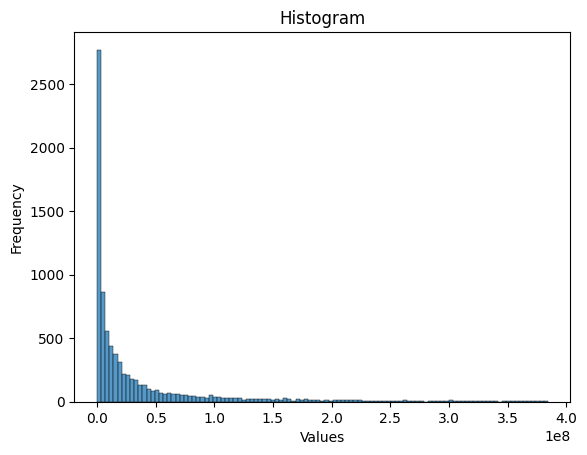

In [11]:
#Distribution of Movie Box Office Revenues (Linear Scale)
histogram(x="Movie_Box_Office_Revenue", data=movie_metadata, remove_outliers=True,yscale='linear')

Using a linear scale for the y-axis, we can see that it resembles a heavy tailed distribution. Therefore, we will now try a log scale plot, which maybe more interpretable and may allow us to clearly see the frequencies of the disproprotionately large values since it uses a scale ordered by magnitude.

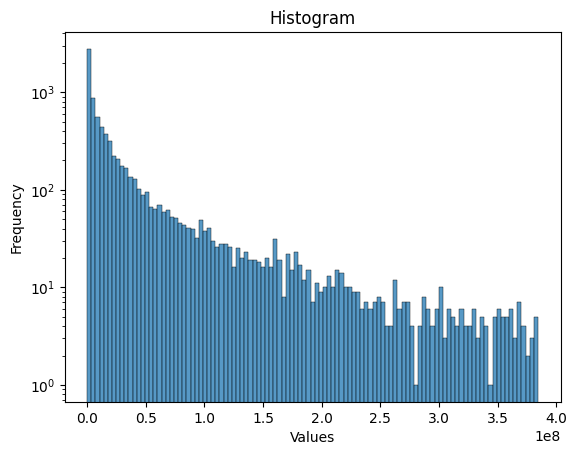

In [12]:
#Distribution of Movie Box Office Revenues
histogram(x="Movie_Box_Office_Revenue", data=movie_metadata, remove_outliers=True, yscale='log')

We observe that there are a quite a lot of films with a low revenue and a substantially lesser number of films with a huge revenue. 

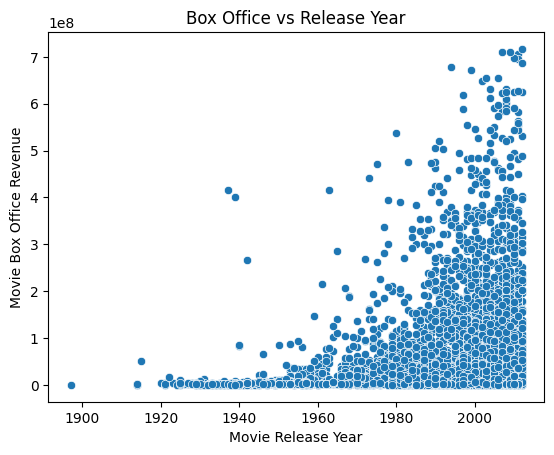

In [13]:
#Scatter Plot of Movie_Box_Office_Revenue v/s Movie_Release_Year
#First, we remove the movies which have an NaN value in the 'Movie_Box_Office_Revenue' column
movies_with_box_office_revenue = movie_metadata[~movie_metadata['Movie_Box_Office_Revenue'].isna()]
#Next, from the remaining movies, we remove the movies which have an NaN value in the 'Movie_Release_Year' column
movies_with_box_office_revenue = movies_with_box_office_revenue[movies_with_box_office_revenue['Movie_Release_Year'] == movies_with_box_office_revenue['Movie_Release_Year']]
#Finally, we generate the scatter plot
scatter(x="Movie_Release_Year",y="Movie_Box_Office_Revenue", data=movies_with_box_office_revenue,
                     xlabel="Movie Release Year", ylabel= "Movie Box Office Revenue",
                     title = "Box Office vs Release Year", remove_outliers=True, threshold = 6)

It seems that Movie_Release_Year and Movie_Box_Office_Revenue are correlated! Let's find out exactly.

In [14]:
#Compute correlation coeff 
pearsonr(movies_with_box_office_revenue['Movie_Release_Year'], movies_with_box_office_revenue['Movie_Box_Office_Revenue'])

PearsonRResult(statistic=0.18552664538795255, pvalue=2.253003816364253e-65)

Since the p-value < 0.05, we can reject the null hypothesis of no correlation. Hence, the release year and box office revenue of movies is correlated. Our first thought is that this might be due to inflation. Let's find out whether we are correct or not!

### Inflation Adjustment of Box Office Revenues of Movies 
<a id="4"></a>

To remove this correlation from the dataset, we scrape the Consumer Price Index (CPI) for USD and keep the average per year. Thus, we can calculate an adjusted box office revenue for the movies based on their release year and the CPI of the last year available (base year) using the following formula:

$$ Adjusted \space Revenue = \frac{Movie \space Box \space Office \space Revenue}{CPI \space of \space movie \space release \space date}*CPI \space of \space base \space year $$

In [15]:
# Fetch historical CPI data for USD
cpi_url = 'https://www.usinflationcalculator.com/inflation/consumer-price-index-and-annual-percent-changes-from-1913-to-2008/'
cpi_data = pd.read_html(cpi_url)[0]
cpi_data.columns = cpi_data.iloc[1]
cpi_data = cpi_data[2:-1] # Select data from 1913 to 2022
#Only keep the necessary columns
yearly_avg_cpi = cpi_data[['Year','Avg']]

# Check for missing values
yearly_avg_cpi.isna().sum()

1
Year    0
Avg     0
dtype: int64

Clearly, none of the values are missing in the `yearly_avg_cpi` dataframe.

In [16]:
#Renaming columns and casting the Year and Avg column values to the float datatype for further usage
yearly_avg_cpi = yearly_avg_cpi.astype(float)
yearly_avg_cpi = yearly_avg_cpi.rename(columns={"Year": "Year_cpi", "Avg": "Avg_cpi"})

#Merge the yearly_avg_cpi df with the movies_with_box_office_revenue df on the movie release year
movies_with_box_office_revenue = pd.merge(movies_with_box_office_revenue, yearly_avg_cpi, left_on='Movie_Release_Year', right_on='Year_cpi', how = 'left')
#Drop the 'Year_cpi' column since its not required
movies_with_box_office_revenue.drop('Year_cpi', axis=1, inplace=True)

base_year = 2022.0 # latest value in CPI dataset

# Applying the necessary adjustment to revenues due to inflation
movies_with_box_office_revenue['Movie_Box_Office_Revenue'] = movies_with_box_office_revenue.apply(
    lambda row: row['Movie_Box_Office_Revenue'] / row['Avg_cpi'] * 
    yearly_avg_cpi[yearly_avg_cpi['Year_cpi'] == base_year]['Avg_cpi'].values[0],
    axis=1
)

#Dropping the unnecessary Avg_cpi column
movies_with_box_office_revenue.drop('Avg_cpi', axis=1, inplace=True)
display(movies_with_box_office_revenue)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year
0,975900,Ghosts of Mars,2001-08-24,2.315268e+07,98.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/01jfsb': 'Thriller', '/m/06n90': 'Science...",2001.0
1,10408933,Alexander's Ragtime Band,1938-08-16,7.472043e+07,106.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/04t36': 'Musical', '/m/01z4y': 'Comedy', ...",1938.0
2,171005,Henry V,1989-11-08,2.398142e+07,137.0,{'/m/02h40lc': 'English Language'},{'/m/07ssc': 'United Kingdom'},"{'/m/04xvh5': 'Costume drama', '/m/082gq': 'Wa...",1989.0
3,77856,Mary Poppins,1964-08-27,9.655040e+08,139.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/0hj3myq': 'Children's/Family', '/m/04t36'...",1964.0
4,612710,New Rose Hotel,1999-10-01,3.780449e+04,92.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/01jfsb': 'Thriller', '/m/06n90': 'Science...",1999.0
...,...,...,...,...,...,...,...,...,...
8322,54540,Coming to America,1988-06-29,7.143263e+08,117.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/06cvj': 'Romantic comedy', '/m/03p5xs': '...",1988.0
8323,7761830,Spaced Invaders,1990-01-01,3.441456e+07,100.0,{'/m/02h40lc': 'English Language'},{'/m/09c7w0': 'United States of America'},"{'/m/0hj3mt0': 'Alien Film', '/m/06n90': 'Scie...",1990.0
8324,1918494,State and Main,2000-08-26,1.180217e+07,106.0,"{'/m/02bjrlw': 'Italian Language', '/m/02h40lc...","{'/m/0f8l9c': 'France', '/m/09c7w0': 'United S...","{'/m/0gf28': 'Parody', '/m/09n5t_': 'Americana...",2000.0
8325,664006,Guilty as Sin,1993-06-04,4.635133e+07,107.0,{},{'/m/09c7w0': 'United States of America'},"{'/m/01jfsb': 'Thriller', '/m/0glj9q': 'Erotic...",1993.0


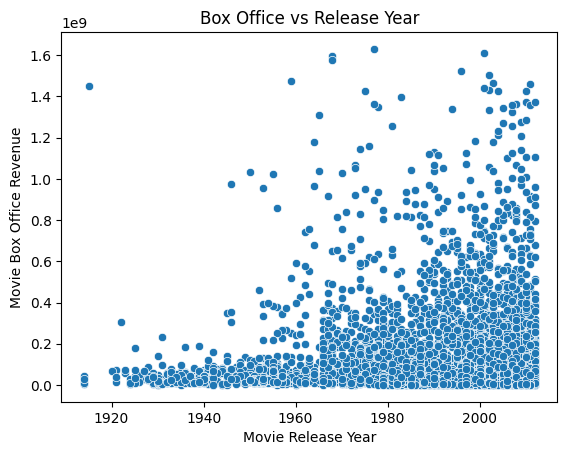

In [17]:
#Let's again check the scatter plot of Movie_Box_Office_Revenue v/s Movie_Release_Year
#First, we remove the movies which have an NaN value in the 'Movie_Box_Office_Revenue' column
movies_with_box_office_revenue = movies_with_box_office_revenue[~movies_with_box_office_revenue['Movie_Box_Office_Revenue'].isna()]
#Next, from the remaining movies, we remove the movies which have an NaN value in the 'Movie_Release_Year' column
movies_with_box_office_revenue = movies_with_box_office_revenue[movies_with_box_office_revenue['Movie_Release_Year'] == movies_with_box_office_revenue['Movie_Release_Year']]
#Finally, we generate the scatter plot
scatter(x="Movie_Release_Year",y="Movie_Box_Office_Revenue", data=movies_with_box_office_revenue,
                     xlabel="Movie Release Year", ylabel= "Movie Box Office Revenue",
                     title = "Box Office vs Release Year", remove_outliers=True, threshold = 6)

In [18]:
#Compute correlation coeff 
pearsonr(movies_with_box_office_revenue['Movie_Release_Year'], movies_with_box_office_revenue['Movie_Box_Office_Revenue'])

PearsonRResult(statistic=-0.007170348825115559, pvalue=0.5129942964782882)

Since the p-value > 0.05, now, we can accept the null hypothesis of no correlation. Hence, the release year and box office revenue of movies are no longer correlated. Inflation adjustment works!

### Data Visualization
<a id="5"></a>

We now continue the rest of the analysis. Let's turn to analysing the languages, genres and countries of movies.

In [19]:
#Convert dicts to lists of values for easy analysis since IDs (dict keys) are not required

movie_metadata['Movie_Languages'] = movie_metadata['Movie_Languages'].apply(lambda x: list(x.values()))
movie_metadata['Movie_Countries'] = movie_metadata['Movie_Countries'].apply(lambda x: list(x.values()))
movie_metadata['Movie_Genres'] = movie_metadata['Movie_Genres'].apply(lambda x: list(x.values()))

display(movie_metadata)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year
0,975900,Ghosts of Mars,2001-08-24,14010832.0,98.0,[English Language],[United States of America],"[Thriller, Science Fiction, Horror, Adventure,...",2001.0
1,3196793,Getting Away with Murder: The JonBenét Ramsey ...,2000-02-16,NaN,95.0,[English Language],[United States of America],"[Mystery, Biographical film, Drama, Crime Drama]",2000.0
2,28463795,Brun bitter,1988-01-01,NaN,83.0,[Norwegian Language],[Norway],"[Crime Fiction, Drama]",1988.0
3,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],[United Kingdom],"[Thriller, Erotic thriller, Psychological thri...",1987.0
4,261236,A Woman in Flames,1983-01-01,NaN,106.0,[German Language],[Germany],[Drama],1983.0
...,...,...,...,...,...,...,...,...,...
81736,35228177,Mermaids: The Body Found,2011-03-19,NaN,120.0,[English Language],[United States of America],[Drama],2011.0
81737,34980460,Knuckle,2011-01-21,NaN,96.0,[English Language],"[Ireland, United Kingdom]","[Biographical film, Drama, Documentary]",2011.0
81738,9971909,Another Nice Mess,1972-09-22,NaN,66.0,[English Language],[United States of America],"[Satire, Comedy]",1972.0
81739,913762,The Super Dimension Fortress Macross II: Lover...,1992-05-21,NaN,150.0,[Japanese Language],[Japan],"[Science Fiction, Japanese Movies, Adventure, ...",1992.0


For these categories where we have the data present in lists, we want to first determine the number of movies in each category. Therefore we create a function, which gets those counts. We apply this function to the three categories: 'Movie_Languages', 'Movie_Countries' and 'Movie_Genres'. Having determined the counts for all the categories, we display the results in the form of pie-charts.

In [20]:
def get_category_wise_counts(category_by_records_net):
    """
    count the number of movies in each category

    Parameters :
        -category_by_records_net (list) : list of the list of categories per movie
    
    """
    count_by_category_net = {}
    
    for record_categories in category_by_records_net:
        for category in record_categories:
            count_by_category_net[category] = count_by_category_net.get(category,0) + 1
            
    return count_by_category_net

In [21]:
count_by_language_net = get_category_wise_counts(list(movie_metadata['Movie_Languages']))
count_by_country_net = get_category_wise_counts(list(movie_metadata['Movie_Countries']))
count_by_genre_net = get_category_wise_counts(list(movie_metadata['Movie_Genres']))

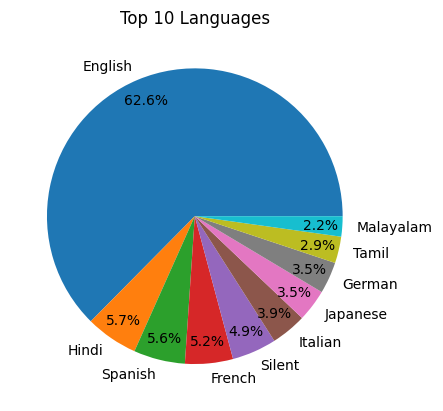

In [22]:
counts = np.array(list(count_by_language_net.values()))
languages = np.array(list(count_by_language_net.keys()))
idx_net_top10_languages_by_count = np.argsort(counts)[::-1][:10]
top10_languages = languages[idx_net_top10_languages_by_count]
counts_top10_languages = counts[idx_net_top10_languages_by_count]
pie_chart(counts_top10_languages,labels=[lang.split()[0] for lang in top10_languages],title='Top 10 Languages')
pie_chart_html(counts_top10_languages, [lang.split()[0] for lang in top10_languages], title="Top 10 Languages", filename='lang_piechart_CMU')

In [23]:
#Top 10 Representation
print(f'Top 10 Representation: {sum(counts_top10_languages)/sum(counts)*100}')
#Top 3 Representation
print(f'Top 3 Representation: {sum(counts_top10_languages[:3])/sum(counts)*100}')

Top 10 Representation: 80.36381973826626
Top 3 Representation: 59.414050969202


Languages: As expected, the English language is the major one (with the most movies) and makes for more than half of the the data. The rest of the languages, 'Hindi', 'Spanish', 'French', etc. are far more similar in abundance. The top 10 languages represent ~ 80.4% of the films (~ 59.4% for the top 3 languages). We can therefore continue the analysis of this category using the top 10, or top 3 when the plots are too overlapping. 

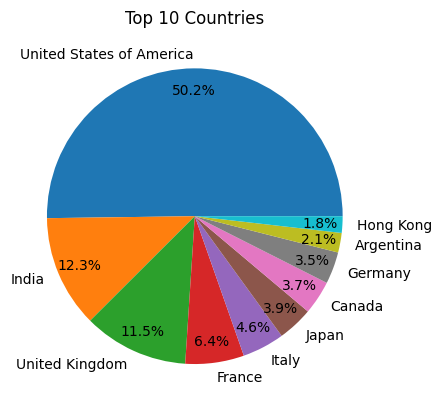

In [24]:
counts = np.array(list(count_by_country_net.values()))
countries = np.array(list(count_by_country_net.keys()))
idx_net_top10_countries_by_count = np.argsort(counts)[::-1][:10]
top10_countries = countries[idx_net_top10_countries_by_count]
counts_top10_countries = counts[idx_net_top10_countries_by_count]

pie_chart(counts_top10_countries,labels=top10_countries,title='Top 10 Countries')
pie_chart_html(counts_top10_languages, top10_countries, title="Top 10 Countries", filename='country_piechart_CMU')

In [25]:
#Top 10 Representation
print(f'Top 10 Representation: {sum(counts_top10_countries)/sum(counts)*100}')
#Top 3 Representation
print(f'Top 3 Representation: {sum(counts_top10_countries[:3])/sum(counts)*100}')

Top 10 Representation: 79.27739278318313
Top 3 Representation: 58.63808322824716


Countries: As could be expected from our results of the languages, the United States of America is producing the most films, followed by India and the United Kingdom. Again, the top 10 countries represent ~ 79.3% of the films (~ 58.6% for the top 3). We can therefore continue the analysis of this category using the top 10, or top 3 when the plots are too overlapping.

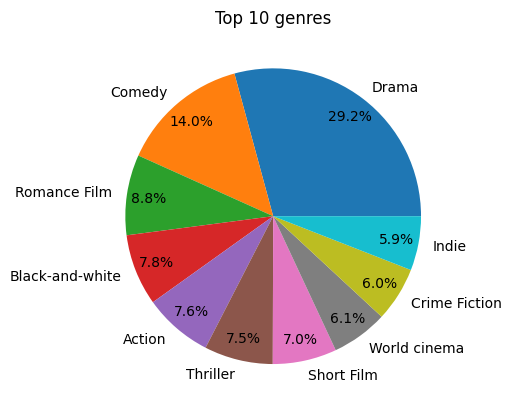

In [26]:
counts = np.array(list(count_by_genre_net.values()))
genres = np.array(list(count_by_genre_net.keys()))
idx_net_top10_genres_by_count = np.argsort(counts)[::-1][:10]
top10_genres = genres[idx_net_top10_genres_by_count]
counts_top10_genres = counts[idx_net_top10_genres_by_count]

pie_chart(counts_top10_genres,labels=top10_genres,title='Top 10 genres')
pie_chart_html(counts_top10_genres, top10_genres, title="Top 10 Genres", filename='genre_piechart_CMU')

In [27]:
#Top 10 Representation
print(f'Top 10 Representation: {sum(counts_top10_genres)/sum(counts)*100}')
#Top 3 Representation
print(f'Top 3 Representation: {sum(counts_top10_genres[:3])/sum(counts)*100}')

Top 10 Representation: 47.821816358570125
Top 3 Representation: 24.899104889816787


The top Genres of films are Drama, Comedy and Romance and are more equally represented than the languages and countries. It would be interesting to see which countries are producing which kinds of films majorly. The top 10 genres represent ~ 47.8% of the films (~ 24.9% for the top 3 genres). We can therefore continue the analysis of this category using the top 10, or top 3 when the plots are too overlapping. It would be interesting to see which countries are producing which kinds of films majorly. This is what we'll do now.

In order to be able to compare the Movies according to countries, genres and languages, we need to split up the lists we have in those columns and then sort them according to the different countries, genres, languages. So we split the lists with help of explode() via the function `explode_by_cat()` and take the top 10 languages / countries / genres. With help of those new datasets, we analyse in different plots, how the revenue and runtime vary in the movies in the top 10 or top 3 (when plots are too overlapping) languages / countries / genres.

In [28]:
def explode_by_cat(df, cat):
    exploded_dfs = {}
    for col in cat:
        exploded_dfs[f"df_{col}"] = df.explode(col).reset_index(drop=True)
    return exploded_dfs

result_dfs = explode_by_cat(movie_metadata, ["Movie_Languages", "Movie_Countries", "Movie_Genres"])

#Extract the different dfs for analysis of movie languages, countries and genres
df_languages, df_countries, df_genres = result_dfs["df_Movie_Languages"], result_dfs["df_Movie_Countries"], result_dfs["df_Movie_Genres"]

In [29]:
df_languages_top10=df_languages[df_languages["Movie_Languages"].isin(top10_languages)]
df_countries_top10=df_countries[df_countries["Movie_Countries"].isin(top10_countries)]
df_genres_top10=df_genres[df_genres["Movie_Genres"].isin(top10_genres)]

df_languages_top3=df_languages[df_languages["Movie_Languages"].isin(top10_languages[:3])]
df_countries_top3=df_countries[df_countries["Movie_Countries"].isin(top10_countries[:3])]
df_genres_top3=df_genres[df_genres["Movie_Genres"].isin(top10_genres[:3])]

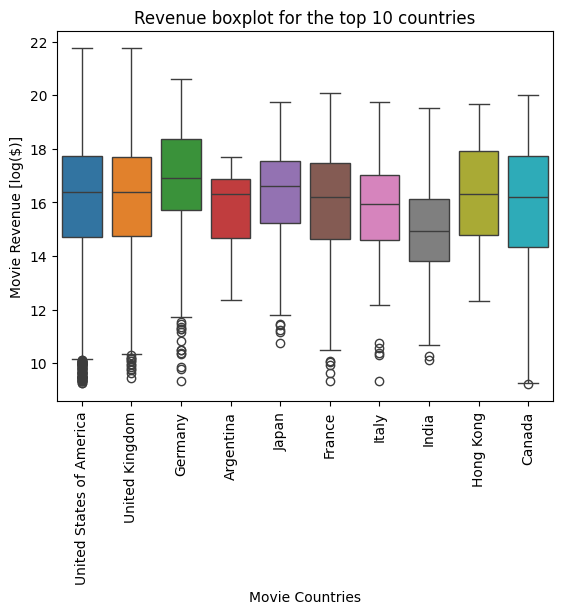

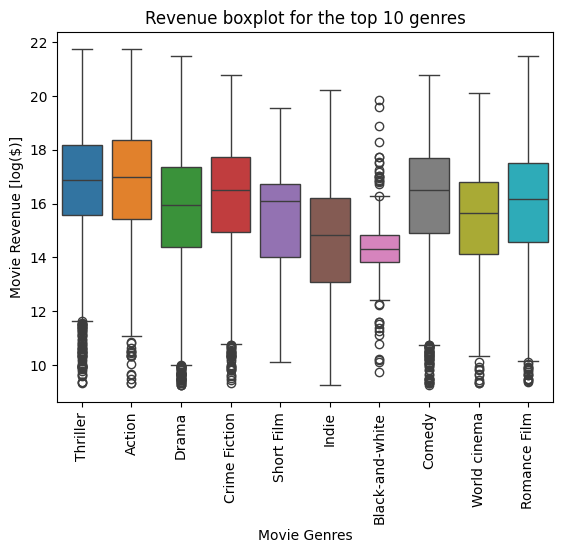

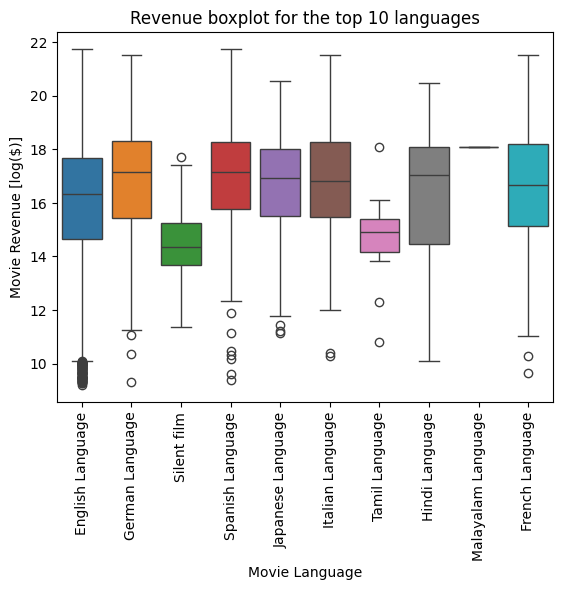

In [30]:
#Box Plots
box(data=df_countries_top10, x="Movie_Countries", y="Movie_Box_Office_Revenue", log=True, xlabel="Movie Countries", ylabel= "Movie Revenue [log($)]", title = "Revenue boxplot for the top 10 countries")
box(data=df_genres_top10, x="Movie_Genres", y="Movie_Box_Office_Revenue", log=True, xlabel="Movie Genres", ylabel= "Movie Revenue [log($)]", title = "Revenue boxplot for the top 10 genres")
box(data=df_languages_top10, x="Movie_Languages", y="Movie_Box_Office_Revenue", log=True, xlabel="Movie Language", ylabel= "Movie Revenue [log($)]", title = "Revenue boxplot for the top 10 languages")


Having plotted all the three boxplots for revenue (using a log scale) of the movies in all the three categories (languages, countries, genres), we will now analyze them: 

Countries: The boxplots are quite overlapping. The tendency goes towards a lower revenue for films from India compared with a higher revenue for films from Germany.

Genres: Again, all the boxplots are overlapping. Still, films such as Black-and-White films seem to have a bit less revenue than films in genres like comedy, action or thriller. 

Languages: We can observe that silent films and films in Tamil language make less revenue than films in languages such as German, French or Spanish. But it has to be said, that there are overlaps in all of the boxplots, because of which we can't draw a fixed conclusion. 

In [31]:
box_html(data=df_countries_top10, x="Movie_Countries", y="Movie_Runtime", xlabel="Movie Countries", labels = "Movie_Countries", ylabel= "Movie Runtime [s]", title = "Boxplot of Runtime for the Movies of the Top 10 Countries", ylim=(0,300), filename = 'runtime_boxplot_top10countries_CMU')
box_html(data=df_languages_top10, x="Movie_Languages", y="Movie_Runtime", labels = "Movie_Languages", ylim=(0,300), xlabel="Movie Language", ylabel= "Movie Runtime [s]", title = "Boxplot of Runtime for the Movies in the Top 10 Languages", filename = 'runtime_boxplot_top10languages_CMU')

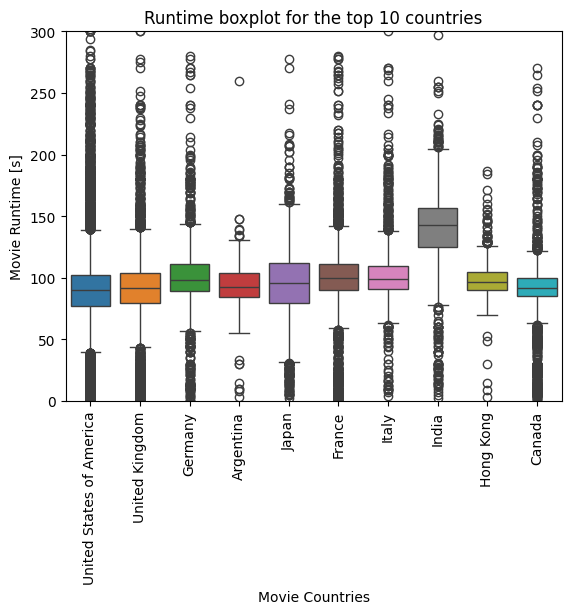

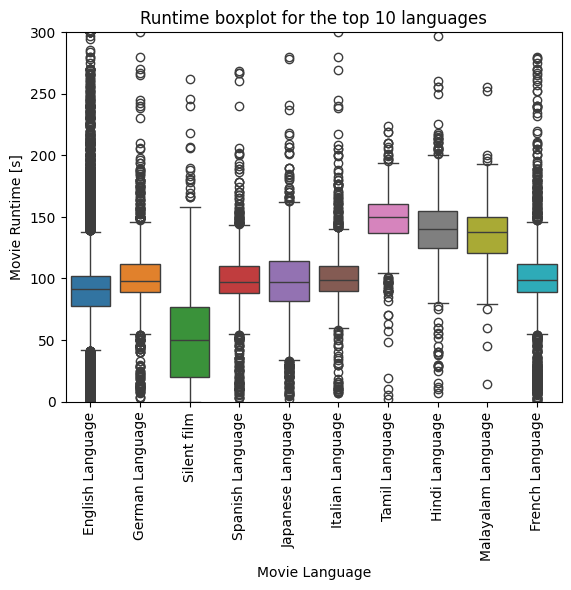

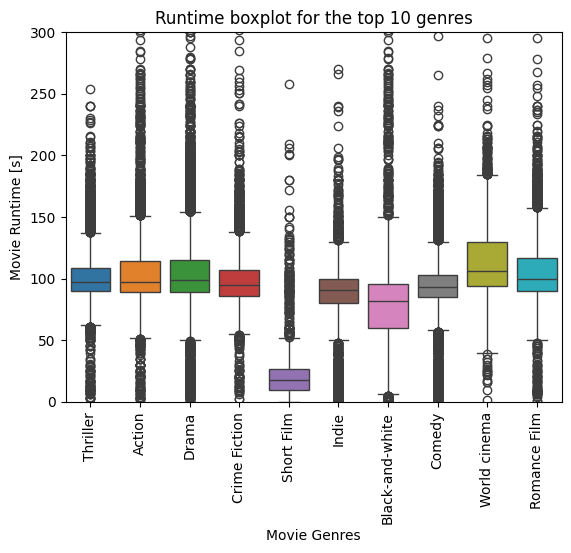

In [32]:
box(data=df_countries_top10, x="Movie_Countries", y="Movie_Runtime", xlabel="Movie Countries", ylabel= "Movie Runtime [s]", title = "Runtime boxplot for the top 10 countries", ylim=(0,300))
box(data=df_languages_top10, x="Movie_Languages", y="Movie_Runtime", ylim=(0,300), xlabel="Movie Language", ylabel= "Movie Runtime [s]", title = "Runtime boxplot for the top 10 languages")
box(data=df_genres_top10, x="Movie_Genres", y="Movie_Runtime", ylim=(0,300), xlabel="Movie Genres", ylabel= "Movie Runtime [s]", title = "Runtime boxplot for the top 10 genres")

The same boxplots are done for the runtime of movies in the three categories. More differences can be observed now:

Countries: For the countries, an interesting observation is the longer runtime for Indian movies in comparision to the other countries. This fact is supported by the plot of the languages, wherein the Tamil and Hindi languages seem to have a longer runtime as compared to the other languages. 

Languages: Silent films tend to have a shorter runtime than most of the films. On the contrary, films in Tamil, Hindi and Malayalam languages seem to have a longer runtime.

Genres: As expected, short films have a significantly shorter runtime than all of the other genres. For the other Genres, there is no striking difference apart from the world cinema movies having runtimes which are a bit longer.

<Axes: title={'center': 'Lineplot of Runtime for the Movies in the Top 10 Languages'}, xlabel='Year', ylabel='Runtime [s]'>

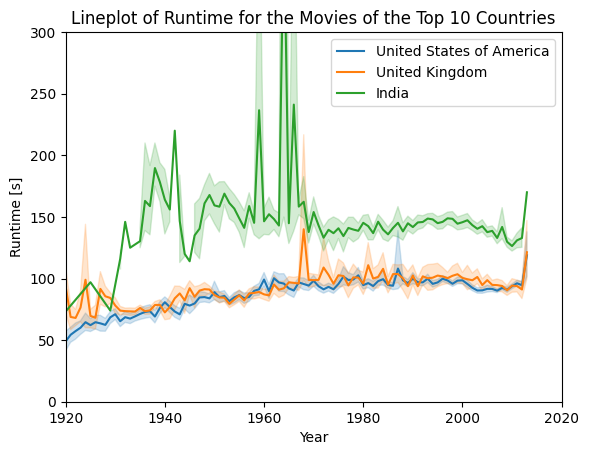

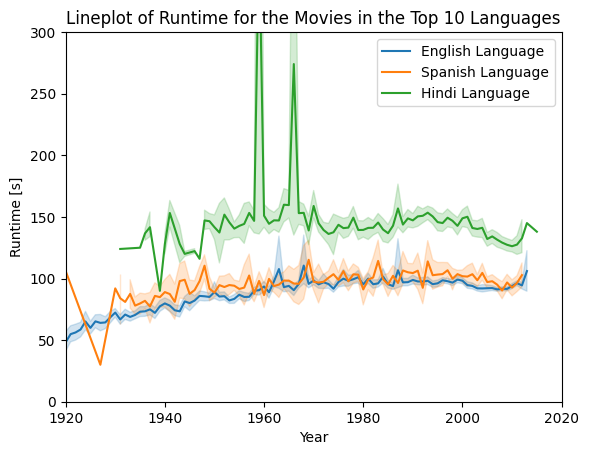

In [33]:
line_html(data=df_countries_top3, x="Movie_Release_Year", y="Movie_Runtime", hue="Movie_Countries", title="Lineplot of Runtime for the Movies of the Top 10 Countries", xlabel="Year", ylabel="Runtime [s]",xlim=(1920,2020), ylim=(0,300), remove_outliers=True, filename = "runtime_lineplot_top10countries_CMU.html")
line_html(data=df_languages_top3, x="Movie_Release_Year", y="Movie_Runtime", hue="Movie_Languages", title="Lineplot of Runtime for the Movies in the Top 10 Languages", xlabel="Year", ylabel="Runtime [s]",xlim=(1920,2020), ylim=(0,300), remove_outliers=True, filename = "runtime_lineplot_top10languages_CMU.html")

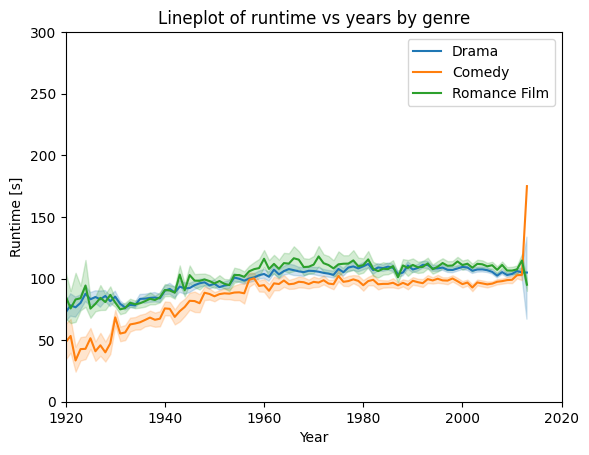

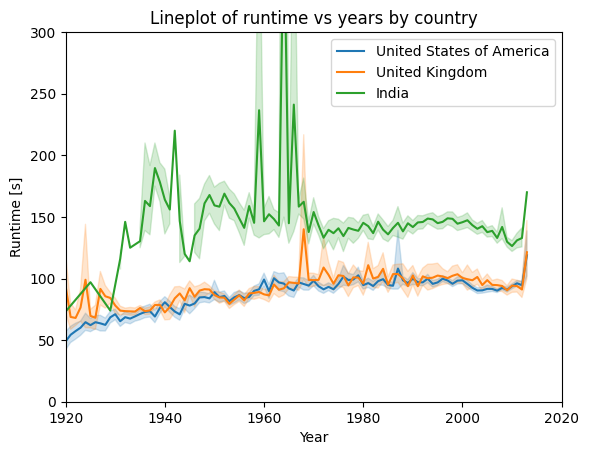

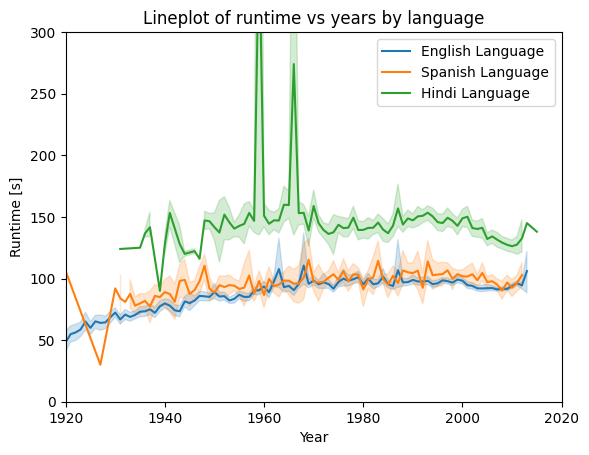

<Axes: title={'center': 'Lineplot of runtime vs years by language'}, xlabel='Year', ylabel='Runtime [s]'>

In [34]:
line(data=df_genres_top3, x="Movie_Release_Year", y="Movie_Runtime", hue="Movie_Genres", title="Lineplot of runtime vs years by genre", xlabel="Year", ylabel="Runtime [s]", xlim=(1920,2020),ylim=(0,300), remove_outliers=True)
line(data=df_countries_top3, x="Movie_Release_Year", y="Movie_Runtime", hue="Movie_Countries", title="Lineplot of runtime vs years by country", xlabel="Year", ylabel="Runtime [s]",xlim=(1920,2020), ylim=(0,300), remove_outliers=True)
line(data=df_languages_top3, x="Movie_Release_Year", y="Movie_Runtime", hue="Movie_Languages", title="Lineplot of runtime vs years by language", xlabel="Year", ylabel="Runtime [s]",xlim=(1920,2020), ylim=(0,300), remove_outliers=True)

We now show the lineplots with 95% confidence intervals (obtained using bootstrapping method) for further analysis. Here again, we focus on the top 3 categories.

Genre : The CIs are more or less overlapping, however, movies with the comedy genre seem to be a bit shorter than the other two.

Country : Runtime of movies from India are clearly longer. One should ignore data before 1940 because there is not enough data provided to calculate CI's for India. One should also ignore the peak in 1965, impacted by outliers. 

Language : Again, runtime of movies in the Hindi Language, i.e., from India are clearly longer.

It seems that changes in runtime over the years w.r.t. movies grouped by language and movies grouped by country are correlated.

## Spotify Dataset
<a id="6"></a>

In our project, since we want to analyze the relations between movies and their music, one of the first things we need is good data about the music in different films. For that reason, we extracted music data corresponding to the movies from Spotify: see `spotify_scraper.py` for details of the scraping. 

### Loading the Scraped Dataset 
<a id="7"></a>

In [35]:
movie_music_df = pd.read_csv(os.path.join(MAIN_DATA_PATH,"Spotify_Dataset.csv"), converters = {'Album_Genres':literal_eval})
display(movie_music_df)

,Wikipedia_Movie_ID,Movie_Name,Album_Name,Album_Release_Date,Album_Genres,Album_Popularity,Album_Total_Tracks,Track_Name,Track_Duration,Track_Acousticness,...,Track_Energy,Track_Instrumentalness,Track_Key,Track_Liveness,Track_Loudness,Track_Mode,Track_Speechiness,Track_Tempo,Track_Time_Signature,Track_Valence
0,9363483,White Of The Eye,White of the Eye (Original Motion Picture Soun...,1987-05-09,[],11,14,Goldwaters,171826,0.1750,...,0.678,0.60400,7,0.1500,-4.957,1,0.0830,125.886,4,0.679
1,9363483,White Of The Eye,White of the Eye (Original Motion Picture Soun...,1987-05-09,[],11,14,Remember Mike?,80640,0.3110,...,0.174,0.48200,0,0.1300,-12.046,1,0.0414,77.962,4,0.428
2,9363483,White Of The Eye,White of the Eye (Original Motion Picture Soun...,1987-05-09,[],11,14,Where Are You Joany?,132506,0.1600,...,0.318,0.87700,2,0.2660,-14.426,1,0.0420,128.986,4,0.686
3,9363483,White Of The Eye,White of the Eye (Original Motion Picture Soun...,1987-05-09,[],11,14,Dry Junk,200240,0.0414,...,0.747,0.84600,9,0.0384,-7.840,1,0.0335,104.991,4,0.780
4,9363483,White Of The Eye,White of the Eye (Original Motion Picture Soun...,1987-05-09,[],11,14,Present,148426,0.7890,...,0.343,0.94700,9,0.1060,-14.803,0,0.0347,119.280,5,0.214
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
182017,12095128,My Love,My Love (Original Motion Picture Soundtrack),1970-12-01,[],7,7,My Love Panzi Wongo,198280,0.9670,...,0.567,0.00746,9,0.3800,-10.062,1,0.0770,102.110,3,0.562
182018,12095128,My Love,My Love (Original Motion Picture Soundtrack),1970-12-01,[],7,7,"Sunate Hain Sitare Raat Bhar, Pt. 1",320493,0.9930,...,0.387,0.94800,8,0.2270,-14.014,0,0.0521,139.745,3,0.528
182019,12095128,My Love,My Love (Original Motion Picture Soundtrack),1970-12-01,[],7,7,"Sunate Hain Sitare Raat Bhar, Pt. 2",203560,0.9760,...,0.527,0.03220,7,0.1430,-9.647,0,0.0480,179.810,4,0.380
182020,12095128,My Love,My Love (Original Motion Picture Soundtrack),1970-12-01,[],7,7,Woh Tere Pyar Ka Gham,201373,0.9920,...,0.195,0.77500,3,0.1750,-17.230,1,0.0339,90.549,4,0.872


We now aggregate the music data across a movie album by averaging and/or storing only the first value as applicable for continuous or same (for every movie album track) values respectively.

In [36]:
agg_dict = {'first': ['Album_Genres','Album_Popularity'],
    'mean': ['Track_Duration',
    'Track_Acousticness',
    'Track_Danceability',
    'Track_Energy',
    'Track_Instrumentalness',
    'Track_Liveness',
    'Track_Loudness',
    'Track_Speechiness',
    'Track_Tempo',
    'Track_Valence']}
movie_music_df_avg_by_movie = movie_music_df.groupby('Wikipedia_Movie_ID').agg({col_label : func for func, col_label_net in agg_dict.items() for col_label in col_label_net})

In [37]:
movie_music_df_avg_by_movie = movie_music_df_avg_by_movie.reset_index()
display(movie_music_df_avg_by_movie)

,Wikipedia_Movie_ID,Album_Genres,Album_Popularity,Track_Duration,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence
0,3217,[],24,144551.428571,0.814714,0.270971,0.303333,0.725333,0.209571,-17.608762,0.046814,128.140000,0.200814
1,3746,[],3,253873.352941,0.415384,0.188976,0.208524,0.762059,0.162518,-19.829118,0.041982,99.734765,0.063418
2,3837,[],26,89686.964286,0.556239,0.386321,0.313796,0.227502,0.185243,-15.091571,0.080786,90.293429,0.322121
3,3947,[],26,178533.000000,0.756214,0.270621,0.169503,0.680307,0.161364,-18.656571,0.040800,98.786571,0.187964
4,4560,[],60,259744.111111,0.531229,0.165311,0.112961,0.846000,0.133444,-26.971722,0.041822,111.759000,0.070994
...,...,...,...,...,...,...,...,...,...,...,...,...,...
14050,37210334,[],26,169666.357143,0.768357,0.418079,0.198329,0.463951,0.152721,-17.943286,0.046236,114.361643,0.240729
14051,37257312,[],0,91166.666667,0.970167,0.197333,0.043227,0.854167,0.094767,-31.539500,0.055133,87.441500,0.048767
14052,37277581,[],21,278760.571429,0.359643,0.603857,0.587714,0.003481,0.141600,-8.325857,0.040814,114.665000,0.691000
14053,37283373,[],46,224891.200000,0.270813,0.352000,0.411973,0.800116,0.144813,-17.806933,0.052660,124.397267,0.156553


With such a large amount of music data for all our movies, we can get started with our analysis.

### Data Analysis
<a id="8"></a>

In order to get a better idea of the nature of our dataset, we again conduct the very simple analysis of statistical description and identification of the null values in each category. 

It can be seen that there are no NaN values present in our dataset. 

In [38]:
movie_music_df_avg_by_movie.describe()

,Wikipedia_Movie_ID,Album_Popularity,Track_Duration,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence
count,1.405500e+04,14055.000000,1.405500e+04,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000
mean,1.634741e+07,14.757809,2.173984e+05,0.613100,0.458926,0.425305,0.370300,0.190445,-13.569339,0.074546,112.727005,0.427232
std,1.164958e+07,16.852712,1.038372e+05,0.268724,0.166363,0.221485,0.335475,0.086884,5.782705,0.059653,13.816505,0.255625
min,3.217000e+03,0.000000,3.358430e+04,0.000001,0.073800,0.002657,0.000000,0.043350,-37.230129,0.024100,58.708000,0.021850
25%,5.143950e+06,0.000000,1.564174e+05,0.405467,0.326000,0.235823,0.013704,0.130892,-17.647261,0.042390,103.478750,0.168695
50%,1.546478e+07,8.000000,2.066988e+05,0.668493,0.465000,0.412940,0.296067,0.165959,-12.373857,0.053907,112.329857,0.455000
75%,2.687778e+07,25.000000,2.659056e+05,0.843852,0.583000,0.598292,0.711833,0.224249,-9.080000,0.083755,121.176417,0.651944
max,3.747805e+07,77.000000,3.600000e+06,0.996000,0.938000,0.998000,0.983000,0.963000,0.874286,0.950000,198.799000,0.990000


In [39]:
movie_music_df_avg_by_movie.isnull().sum()

Wikipedia_Movie_ID        0
Album_Genres              0
Album_Popularity          0
Track_Duration            0
Track_Acousticness        0
Track_Danceability        0
Track_Energy              0
Track_Instrumentalness    0
Track_Liveness            0
Track_Loudness            0
Track_Speechiness         0
Track_Tempo               0
Track_Valence             0
dtype: int64

In [40]:
num_not_null_album_genres = len(movie_music_df_avg_by_movie[movie_music_df_avg_by_movie['Album_Genres'].apply(len).gt(0)])
print(f'The number of movie albums with a filled album genre in Spotify are {num_not_null_album_genres}')

The number of movie albums with a filled album genre in Spotify are 0


This was expected since most of the movie albums on spotify don't have an album genre filled up in the first place. Music artists do have genres but they can clearly not be used as a substitute for album genres since artists generally sing a variety of songs. See the discussion here for reference: https://community.spotify.com/t5/Spotify-for-Developers/Getting-album-not-getting-genre/td-p/5093156

In [41]:
#Dropping the Album_Genres column since it's empty
movie_music_df_avg_by_movie.drop(columns = ['Album_Genres'], inplace = True)

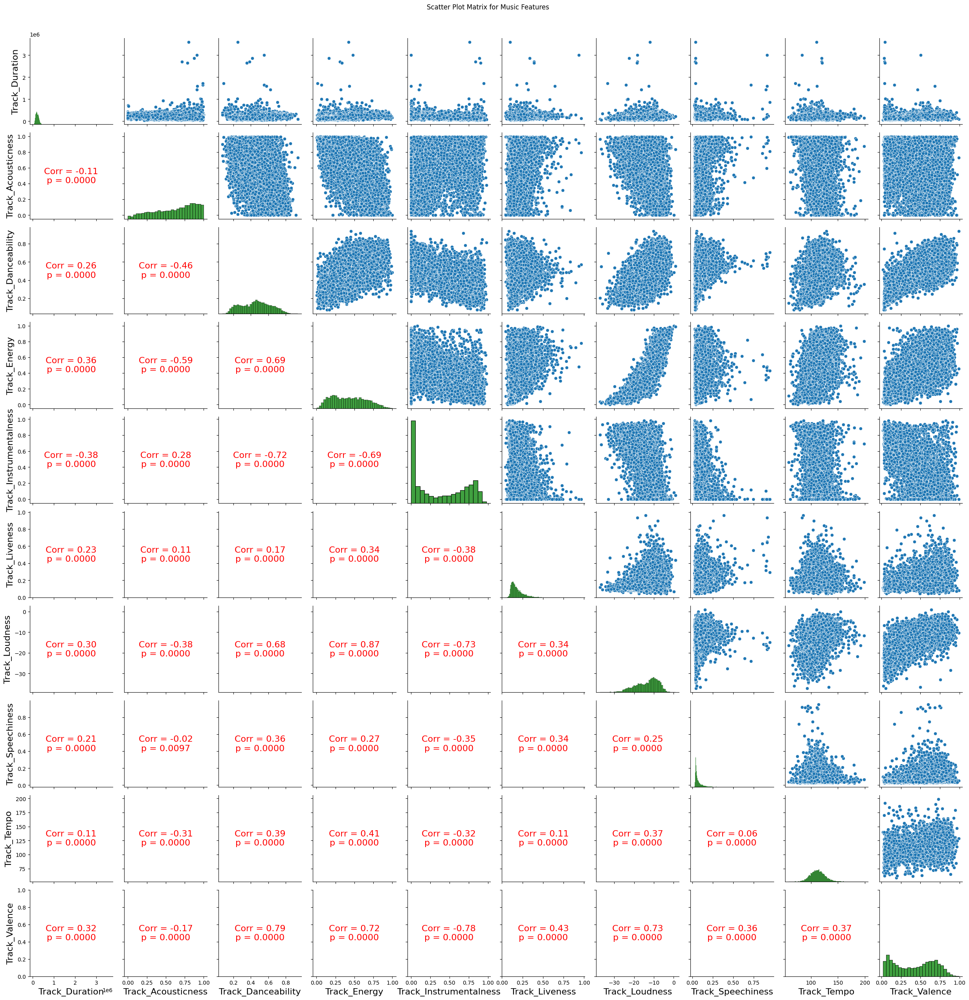

In [ ]:
pair_grid_w_p_values(movie_music_df_avg_by_movie[['Track_Duration', 'Track_Acousticness', 'Track_Danceability',
                    'Track_Energy', 'Track_Instrumentalness', 'Track_Liveness',
                    'Track_Loudness', 'Track_Speechiness', 'Track_Tempo', 'Track_Valence']], "scatterplot_spotify.jpg")

The scatter plot matrix, i.e., the pairplot, above shows the data distributions of two variables (pairwise) with the p-values for their pairwise correlations (respectively). Recall that a p-value less than 0.05 is often considered statistically significant suggesting that there is evidence to reject the null hypothesis that there is no correlation between the variables. 

Now let's focus on our pairplot of music attributes: 

We can clearly see that there exists a significant and high (correlation coefficient > 0.75) between the energy and loudness of a track, the danceability and valence of a track and the instrumentalness and valence of a track (however, the danceability and instrumentalness of a track have a correlation coeff. < 0.75). 

Remark: Except for one subplot, where we observe a p-value of 0.66 (>0.05) and thus cannot reject the null hypothesis that there is a statistically significant correlation between those two variables, we observe a p-value of 0.0000 (one case is 0.0008) everywhere else. This doesn't mean that the p-value is exactly zero but it is a very small value rounded off to zero for display. In practice, this is still considered highly statistically significant and indicates strong evidence against the null hypothesis and thus, indicates highly significant correlation.

## The Movie Metadata Dataset + Our Spotify Dataset
<a id="9"></a>

### Merging the 2 Datasets

Let's now merge our movie metadata dataset with our spotify dataset to start with our analysis of music and movies!

In [43]:
#Merge movie_metadata with movie_music_df_avg_by_movie on Wikipedia_Movie_ID (the unique identifier of a record in the movie_metadata df)
movie_metadata_with_music_data = pd.merge(movie_metadata, movie_music_df_avg_by_movie, on='Wikipedia_Movie_ID', how = 'left')
movie_metadata_with_music_data = movie_metadata_with_music_data[movie_metadata_with_music_data['Track_Duration'].notna()].reset_index(drop = True)
display(movie_metadata_with_music_data)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year,Album_Popularity,Track_Duration,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence
0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],[United Kingdom],"[Thriller, Erotic thriller, Psychological thri...",1987.0,11.0,184802.571429,0.365419,0.583929,0.376714,0.681486,0.133129,-12.339000,0.043136,107.795429,0.424836
1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],[United States of America],"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0,50.0,233823.500000,0.784611,0.495500,0.216147,0.007870,0.167933,-19.369667,0.218728,107.623778,0.480222
2,9633533,Vandanam,1989-01-01,NaN,168.0,[Malayalam Language],[India],[Action],1989.0,23.0,253656.333333,0.758000,0.620333,0.638667,0.080651,0.238833,-8.261833,0.058267,94.274500,0.774000
3,29772142,Karayilekku Oru Kadal Dooram,2010-12-31,NaN,110.0,[Malayalam Language],[India],[Drama],2010.0,16.0,281258.714286,0.721857,0.530286,0.418714,0.000002,0.143686,-8.350714,0.046500,95.347143,0.357429
4,26623942,Kausthubham,2010-03-19,NaN,NaN,[Malayalam Language],[India],[Drama],2010.0,0.0,341395.857143,0.630143,0.523286,0.536857,0.000076,0.206571,-6.998857,0.053157,128.154429,0.523571
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14050,20244619,Mirage,1972-01-01,NaN,82.0,[Spanish Language],[Peru],"[Drama, World cinema]",1972.0,5.0,188751.181818,0.790818,0.332700,0.327391,0.302327,0.183345,-13.723455,0.051355,107.316182,0.201155
14051,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],[India],"[Romance Film, Action, Drama, Science Fiction]",1963.0,0.0,152021.200000,0.957800,0.547400,0.639200,0.006003,0.280400,-5.674200,0.160180,86.945800,0.894200
14052,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],[India],"[Drama, Action, Crime, Comedy]",1994.0,46.0,360644.166667,0.595500,0.631833,0.682167,0.000650,0.195717,-8.454500,0.119383,116.656167,0.692833
14053,23687925,La Ragazza di Trieste,1952-01-01,NaN,NaN,[Italian Language],[Italy],"[Romance Film, Drama]",1952.0,2.0,141283.227273,0.770873,0.293859,0.142411,0.736929,0.128600,-21.475909,0.042232,99.522636,0.186545


In [44]:
num_movies_with_music_spotify = movie_metadata_with_music_data.shape[0]
print(f'The number of movies in the CMU Movie Summary Corpus for which we were able to get music data is {num_movies_with_music_spotify}')
percentage_movies_with_music = round((num_movies_with_music_spotify/movie_metadata.shape[0])*100, 3)
print(f'The percentage of movies in the CMU Movie Summary Corpus for which we were able to get music data is {percentage_movies_with_music} %')

The number of movies in the CMU Movie Summary Corpus for which we were able to get music data is 14055
The percentage of movies in the CMU Movie Summary Corpus for which we were able to get music data is 17.196 %


This is amazing! We were able to find and hence, scrape music data (from Spotify) for 14055 movies in (17.196 % of) the movies metadata dataset (from the CMU Movie Summary Corpus). This is a sufficiently high number since not all movies have music in the first place!

## Data Visualization and Analysis 
<a id="10"></a>

Again, as done earlier for the movie metadata dataset, for the categories where we have the data present in lists, we want to first determine the number of movies in each category in our Spotify dataset. Therefore we apply the function (which we defined earlier) to the three categories: 'Movie_Languages', 'Movie_Countries' and 'Movie_Genres'. Having determined the counts for all the categories, we display the results in the form of pie-charts.

In [45]:
count_by_language_net = get_category_wise_counts(list(movie_metadata_with_music_data['Movie_Languages']))
count_by_country_net = get_category_wise_counts(list(movie_metadata_with_music_data['Movie_Countries']))
count_by_genre_net = get_category_wise_counts(list(movie_metadata_with_music_data['Movie_Genres']))

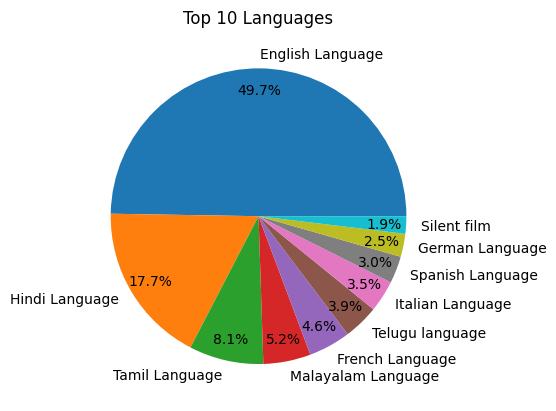

In [46]:
counts = np.array(list(count_by_language_net.values()))
languages = np.array(list(count_by_language_net.keys()))
idx_net_top10_languages_by_count = np.argsort(counts)[::-1][:10]
top10_languages = languages[idx_net_top10_languages_by_count]
counts_top10_languages = counts[idx_net_top10_languages_by_count]
pie_chart(counts_top10_languages,labels=top10_languages,title='Top 10 Languages')
pie_chart_html(counts_top10_languages,labels=top10_languages,title='Top 10 Languages',filename = 'lang_pie_spotify')

In [47]:
#Top 10 Representation
print(f'Top 10 Representation: {sum(counts_top10_languages)/sum(counts)*100}')
#Top 3 Representation
print(f'Top 3 Representation: {sum(counts_top10_languages[:3])/sum(counts)*100}')

Top 10 Representation: 82.22553660592699
Top 3 Representation: 62.09714026327735


Languages: As expected, the English language is again the major one followed up by Hindi. The rest of the languages are far more similar in abundance. The top 10 languages represent ~ 82.2% of the films (~ 62.1% for the top 3 languages). We can therefore continue the analysis of this category using the top 10, or top 3 when the plots are too overlapping.

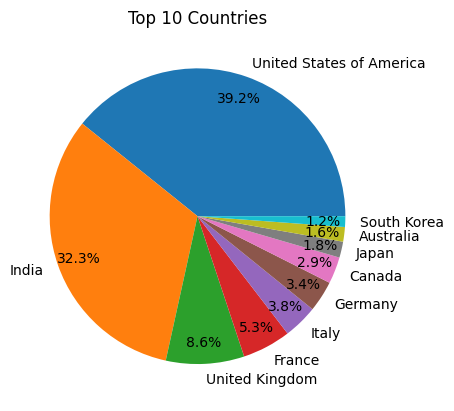

In [48]:
counts = np.array(list(count_by_country_net.values()))
countries = np.array(list(count_by_country_net.keys()))
idx_net_top10_countries_by_count = np.argsort(counts)[::-1][:10]
top10_countries = countries[idx_net_top10_countries_by_count]
counts_top10_countries = counts[idx_net_top10_countries_by_count]

pie_chart(counts_top10_countries,labels=top10_countries,title='Top 10 Countries')
pie_chart_html(counts_top10_countries,labels=top10_countries,title='Top 10 Countries',filename = 'country_pie_spotify')

In [49]:
#Top 10 Representation
print(f'Top 10 Representation: {sum(counts_top10_countries)/sum(counts)*100}')
#Top 3 Representation
print(f'Top 3 Representation: {sum(counts_top10_countries[:3])/sum(counts)*100}')

Top 10 Representation: 86.82319733128048
Top 3 Representation: 69.55350269438028


Countries: The United States of America and India have the most films with music, followed by the United Kingdom. The top 10 countries represent ~ 86.8% of the films (~ 69.5% for the top 3). We can therefore continue the analysis of this category using the top 10, or top 3 when the plots are too overlapping.

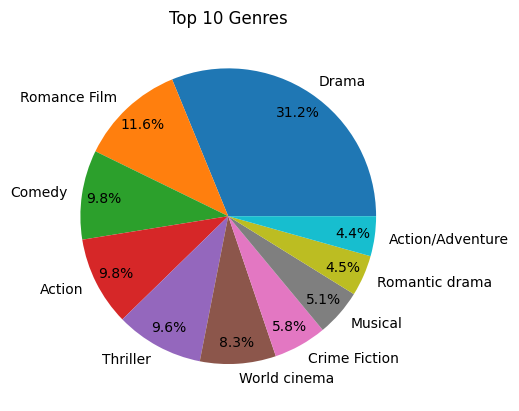

In [50]:
counts = np.array(list(count_by_genre_net.values()))
genres = np.array(list(count_by_genre_net.keys()))
idx_net_top10_genres_by_count = np.argsort(counts)[::-1][:10]
top10_genres = genres[idx_net_top10_genres_by_count]
counts_top10_genres = counts[idx_net_top10_genres_by_count]

pie_chart(counts_top10_genres,labels=top10_genres,title='Top 10 Genres')
pie_chart_html(counts_top10_genres,labels=top10_genres,title='Top 10 Genres',filename = 'genre_pie_spotify')

In [51]:
#Top 10 Representation
print(f'Top 10 Representation: {sum(counts_top10_genres)/sum(counts)*100}')
#Top 3 Representation
print(f'Top 3 Representation: {sum(counts_top10_genres[:3])/sum(counts)*100}')

Top 10 Representation: 51.64259571763571
Top 3 Representation: 27.13405947971685


The top Genres of films with music are Drama, Romance and Comedy. The top 10 genres represent ~ 51.8% of the films (~ 27.1% for the top 3 genres). We can therefore continue the analysis of this category using the top 10, or top 3 when the plots are too overlapping. It would be interesting to see which countries are producing which kinds of films majorly. This is what we'll do now.

In order to be able to compare the Movies according to countries, genres and languages, we again need to split up the lists we have in those columns for this new dataframe and then sort them according to the different countries, genres, languages. So we split the lists with help of explode() via the function explode_by_cat() and take the top 10 languages / countries / genres. With help of those new datasets, we analyse in different plots, how the revenue and runtime vary in the movies in the top 10 or top 3 (when plots are too overlapping) languages / countries / genres.

In [52]:
df_results = explode_by_cat(movie_metadata_with_music_data, ["Movie_Languages", "Movie_Countries", "Movie_Genres"])
#Extract the required dfs
df_languages2, df_countries2, df_genres2 = df_results["df_Movie_Languages"], df_results["df_Movie_Countries"], df_results["df_Movie_Genres"]
display(df_countries2)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year,Album_Popularity,Track_Duration,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence
0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],United Kingdom,"[Thriller, Erotic thriller, Psychological thri...",1987.0,11.0,184802.571429,0.365419,0.583929,0.376714,0.681486,0.133129,-12.339000,0.043136,107.795429,0.424836
1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],United States of America,"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0,50.0,233823.500000,0.784611,0.495500,0.216147,0.007870,0.167933,-19.369667,0.218728,107.623778,0.480222
2,9633533,Vandanam,1989-01-01,NaN,168.0,[Malayalam Language],India,[Action],1989.0,23.0,253656.333333,0.758000,0.620333,0.638667,0.080651,0.238833,-8.261833,0.058267,94.274500,0.774000
3,29772142,Karayilekku Oru Kadal Dooram,2010-12-31,NaN,110.0,[Malayalam Language],India,[Drama],2010.0,16.0,281258.714286,0.721857,0.530286,0.418714,0.000002,0.143686,-8.350714,0.046500,95.347143,0.357429
4,26623942,Kausthubham,2010-03-19,NaN,NaN,[Malayalam Language],India,[Drama],2010.0,0.0,341395.857143,0.630143,0.523286,0.536857,0.000076,0.206571,-6.998857,0.053157,128.154429,0.523571
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16777,20244619,Mirage,1972-01-01,NaN,82.0,[Spanish Language],Peru,"[Drama, World cinema]",1972.0,5.0,188751.181818,0.790818,0.332700,0.327391,0.302327,0.183345,-13.723455,0.051355,107.316182,0.201155
16778,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],India,"[Romance Film, Action, Drama, Science Fiction]",1963.0,0.0,152021.200000,0.957800,0.547400,0.639200,0.006003,0.280400,-5.674200,0.160180,86.945800,0.894200
16779,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],India,"[Drama, Action, Crime, Comedy]",1994.0,46.0,360644.166667,0.595500,0.631833,0.682167,0.000650,0.195717,-8.454500,0.119383,116.656167,0.692833
16780,23687925,La Ragazza di Trieste,1952-01-01,NaN,NaN,[Italian Language],Italy,"[Romance Film, Drama]",1952.0,2.0,141283.227273,0.770873,0.293859,0.142411,0.736929,0.128600,-21.475909,0.042232,99.522636,0.186545


In [53]:
df_languages2_top10=df_languages2[df_languages2["Movie_Languages"].isin(top10_languages)]
df_countries2_top10=df_countries2[df_countries2["Movie_Countries"].isin(top10_countries)]
df_genres2_top10=df_genres2[df_genres2["Movie_Genres"].isin(top10_genres)]

df_languages2_top3=df_languages2[df_languages2["Movie_Languages"].isin(top10_languages[:3])]
df_countries2_top3=df_countries2[df_countries2["Movie_Countries"].isin(top10_countries[:3])]
df_genres2_top3=df_genres2[df_genres2["Movie_Genres"].isin(top10_genres[:3])]

In [54]:
#Stats for all Music Features
toplot = movie_music_df_avg_by_movie.drop(columns=['Wikipedia_Movie_ID'])
toplot.describe()

,Album_Popularity,Track_Duration,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence
count,14055.000000,1.405500e+04,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000,14055.000000
mean,14.757809,2.173984e+05,0.613100,0.458926,0.425305,0.370300,0.190445,-13.569339,0.074546,112.727005,0.427232
std,16.852712,1.038372e+05,0.268724,0.166363,0.221485,0.335475,0.086884,5.782705,0.059653,13.816505,0.255625
min,0.000000,3.358430e+04,0.000001,0.073800,0.002657,0.000000,0.043350,-37.230129,0.024100,58.708000,0.021850
25%,0.000000,1.564174e+05,0.405467,0.326000,0.235823,0.013704,0.130892,-17.647261,0.042390,103.478750,0.168695
50%,8.000000,2.066988e+05,0.668493,0.465000,0.412940,0.296067,0.165959,-12.373857,0.053907,112.329857,0.455000
75%,25.000000,2.659056e+05,0.843852,0.583000,0.598292,0.711833,0.224249,-9.080000,0.083755,121.176417,0.651944
max,77.000000,3.600000e+06,0.996000,0.938000,0.998000,0.983000,0.963000,0.874286,0.950000,198.799000,0.990000


Album_Popularity


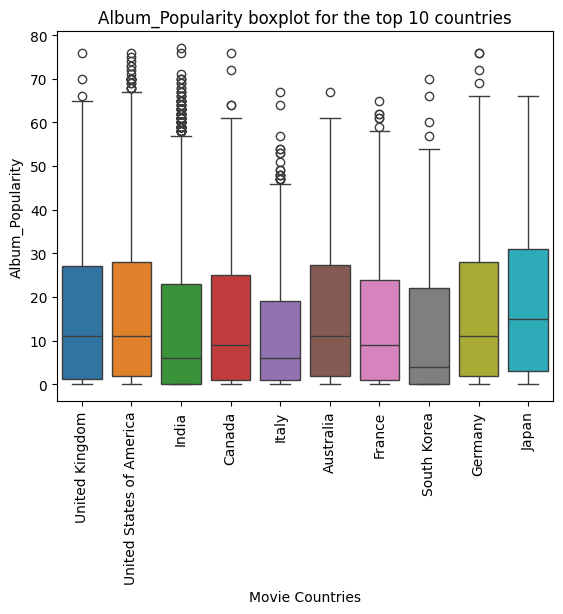

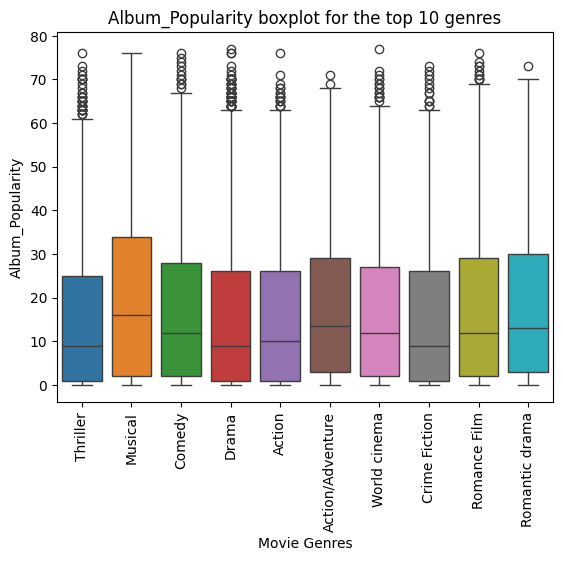

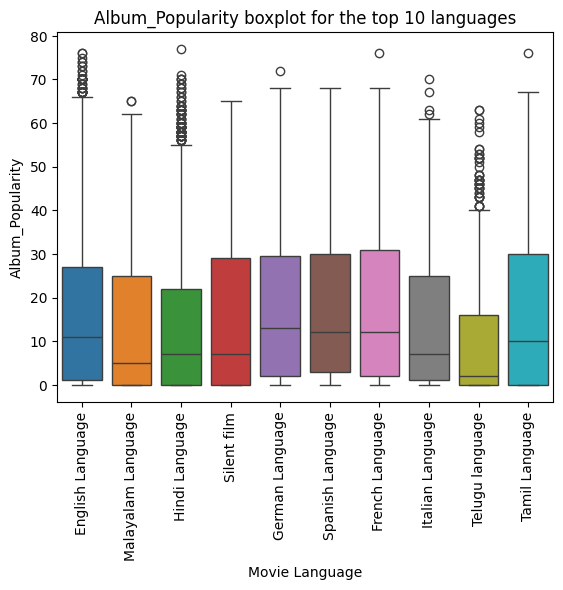

Track_Duration


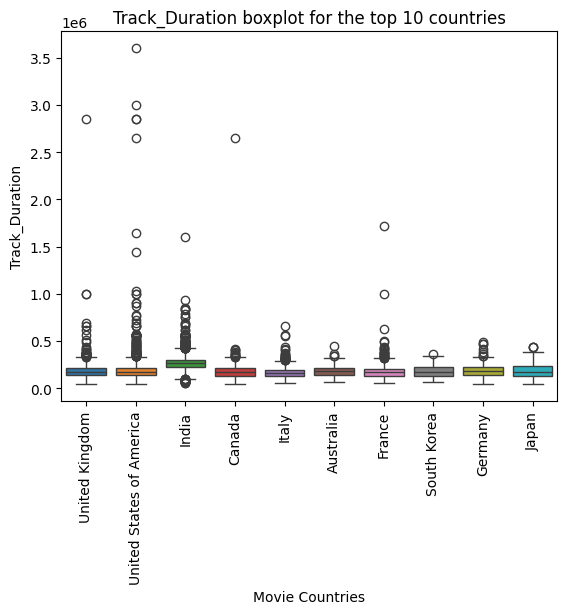

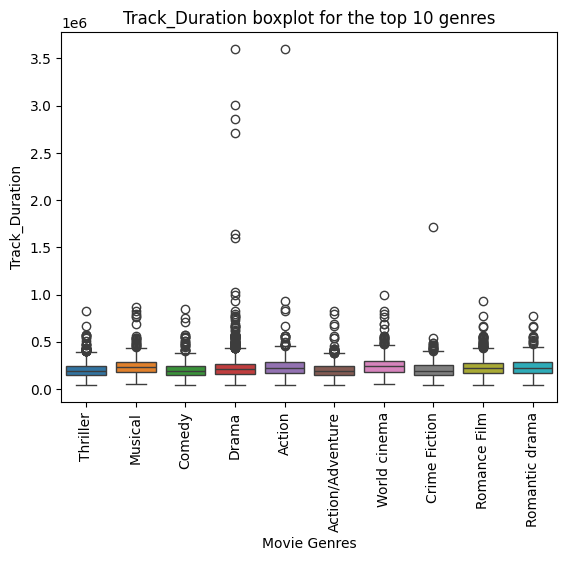

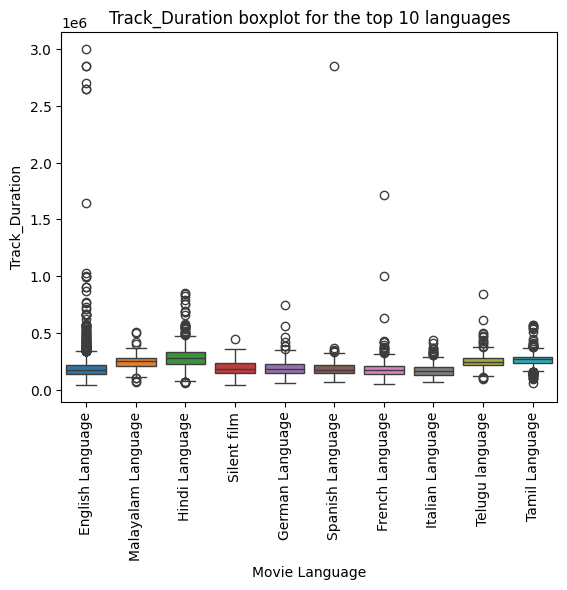

Track_Acousticness


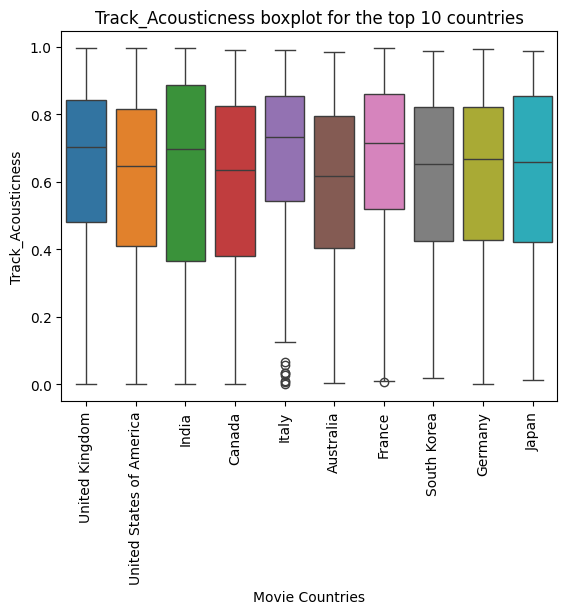

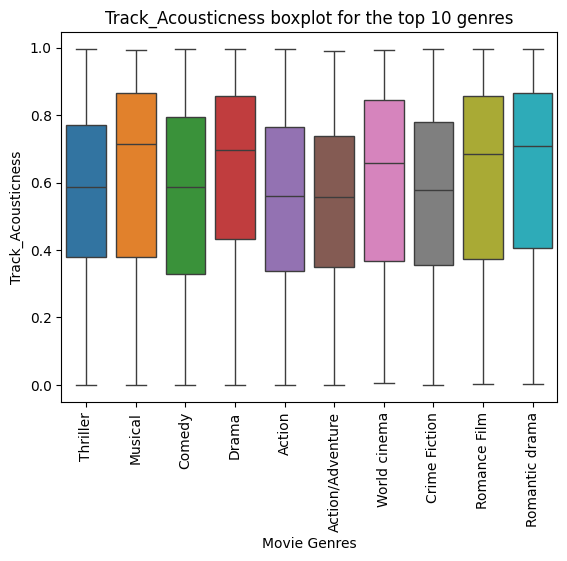

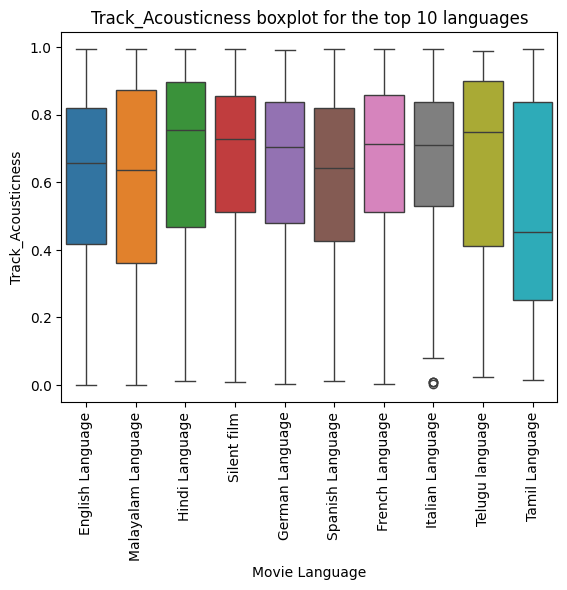

Track_Danceability


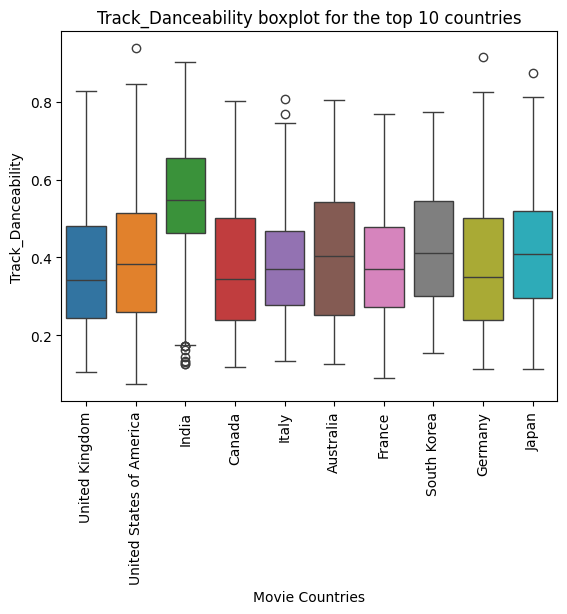

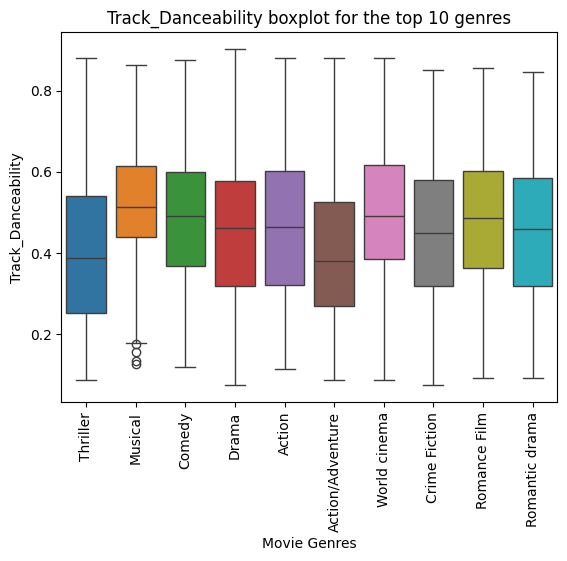

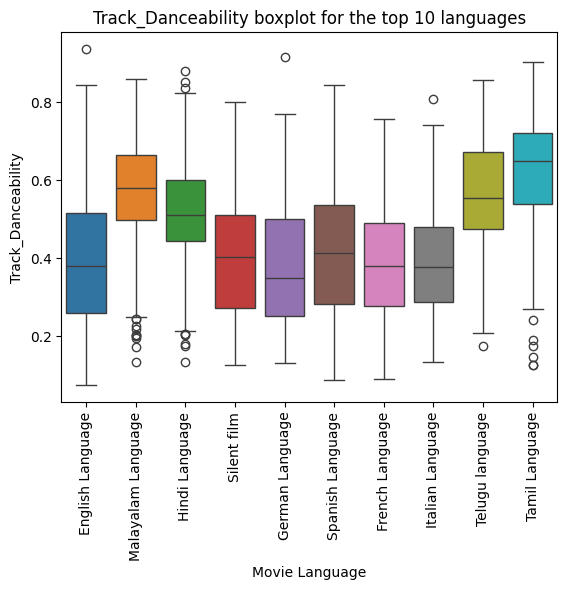

Track_Energy


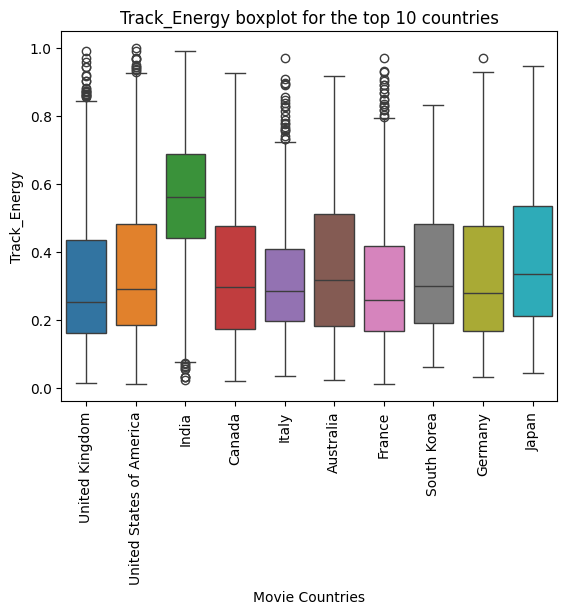

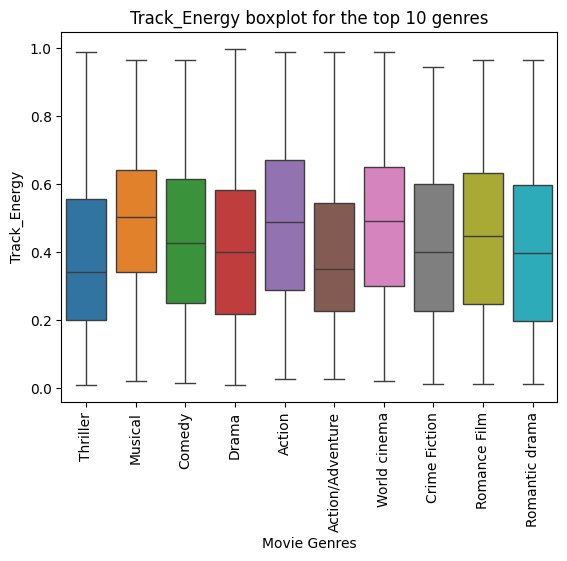

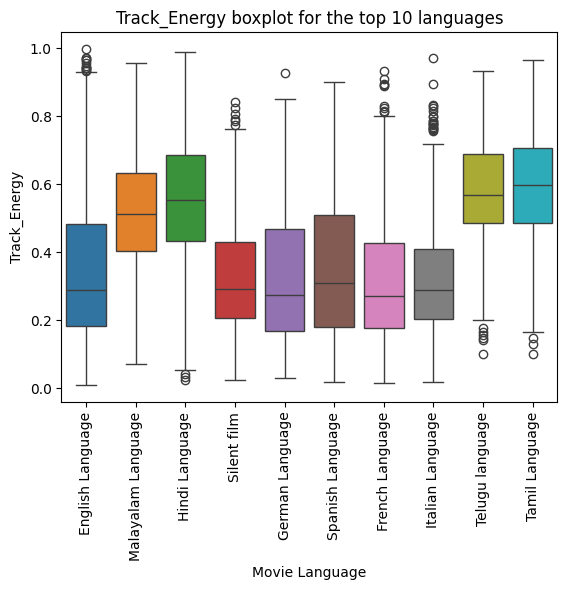

Track_Instrumentalness


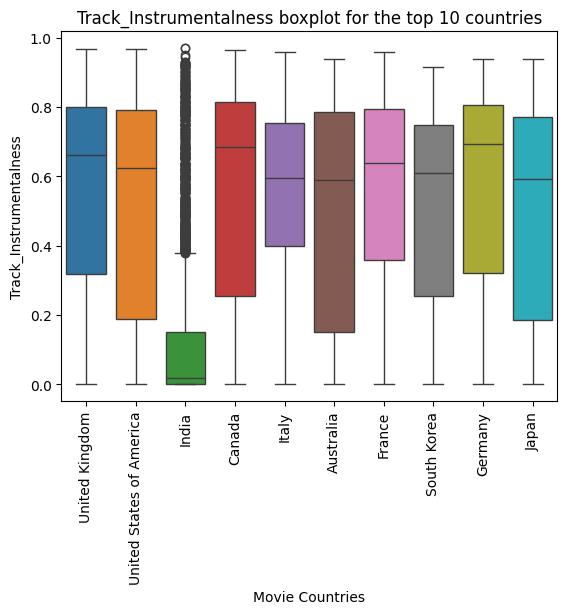

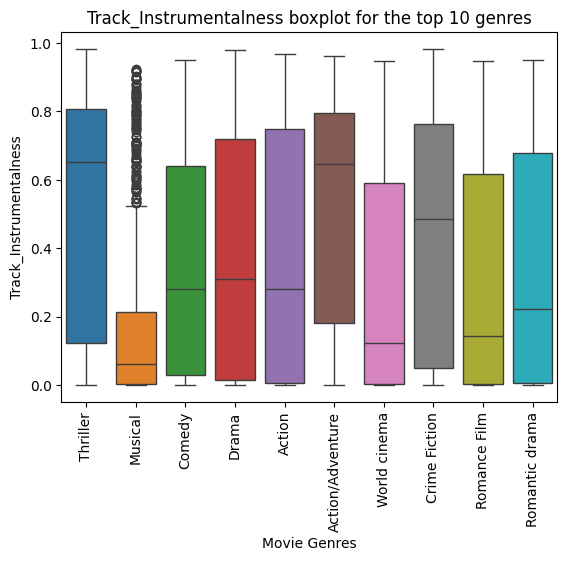

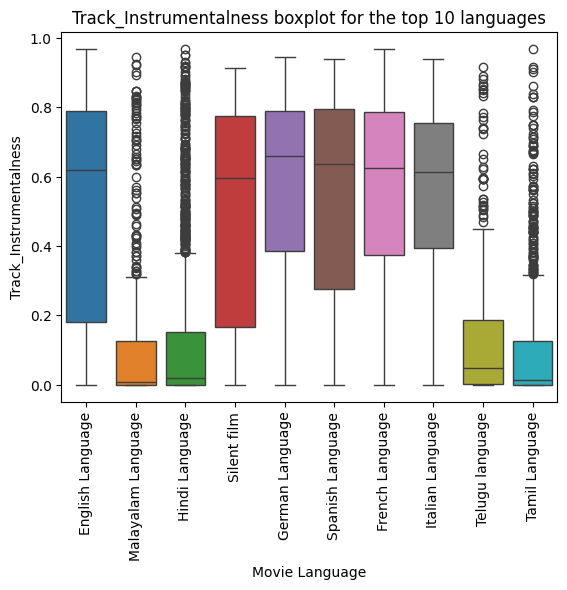

Track_Liveness


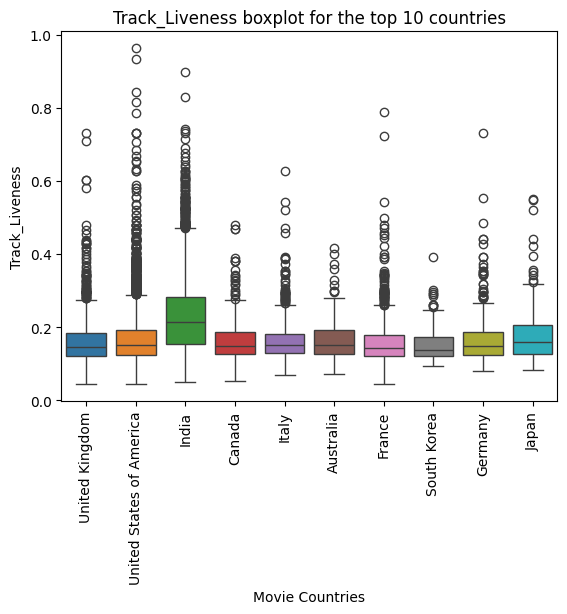

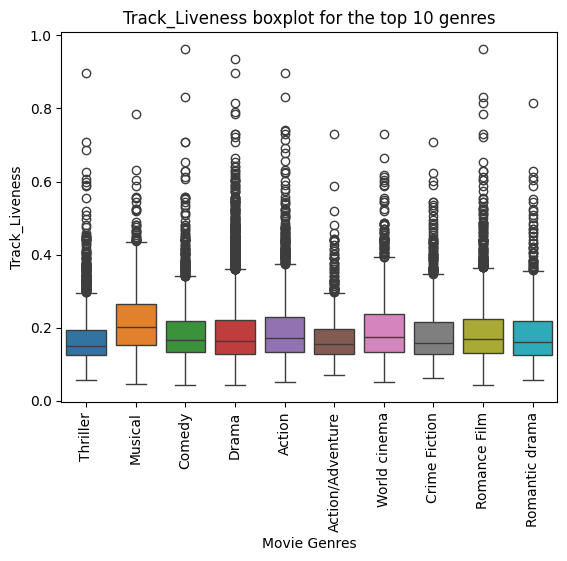

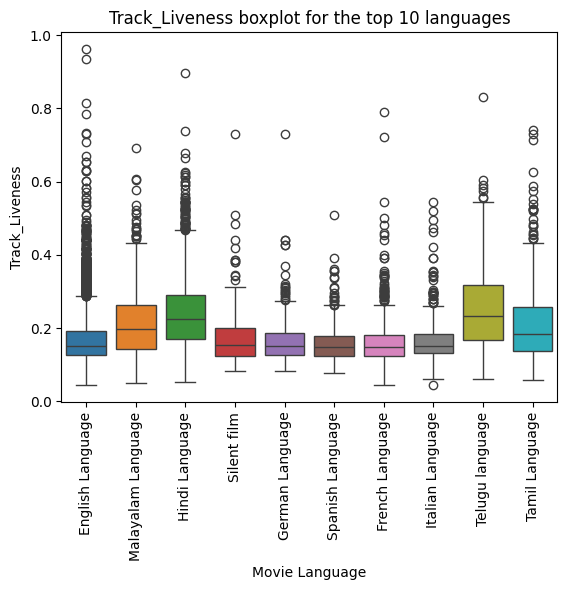

Track_Loudness


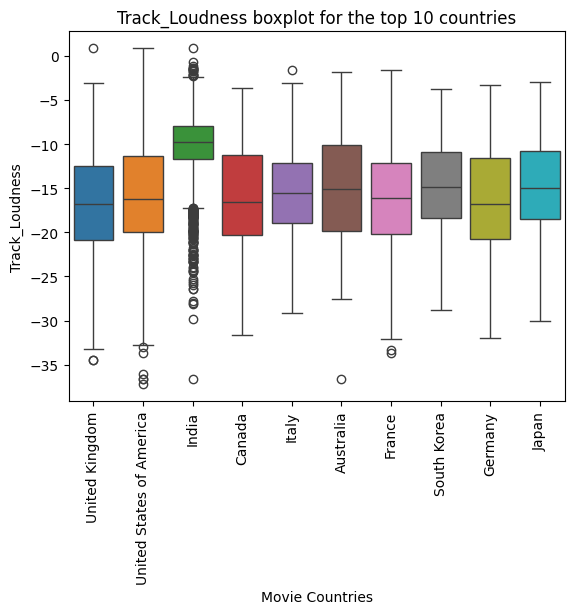

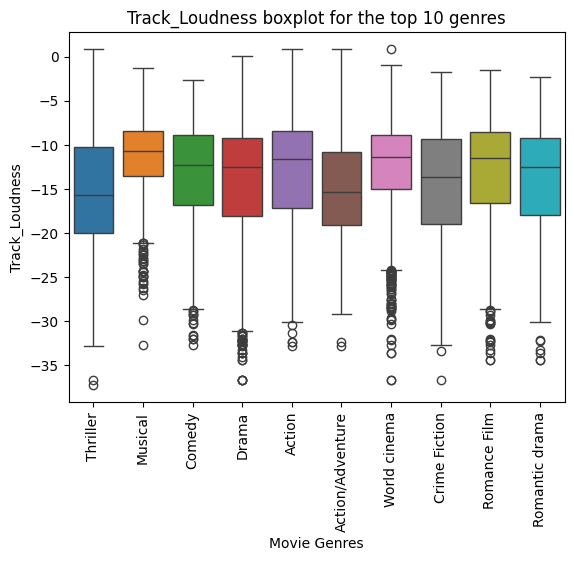

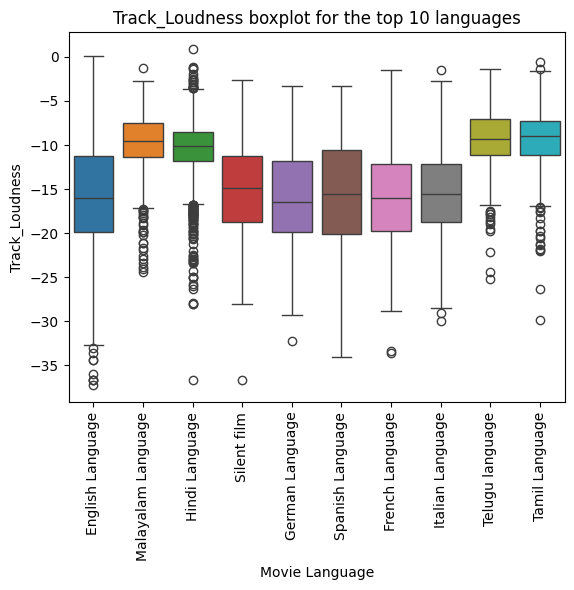

Track_Speechiness


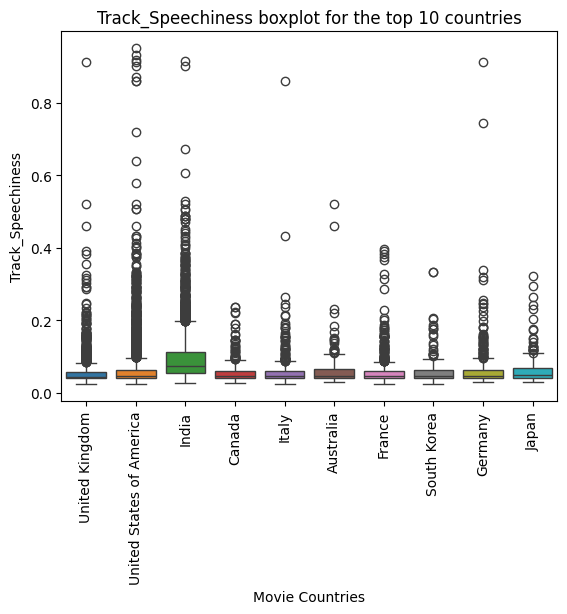

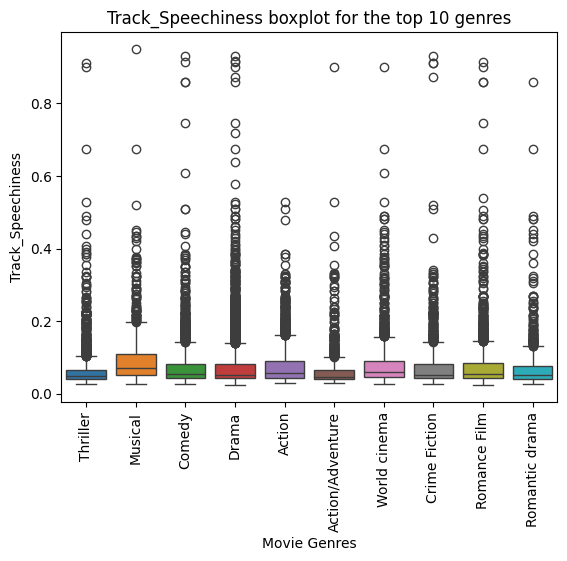

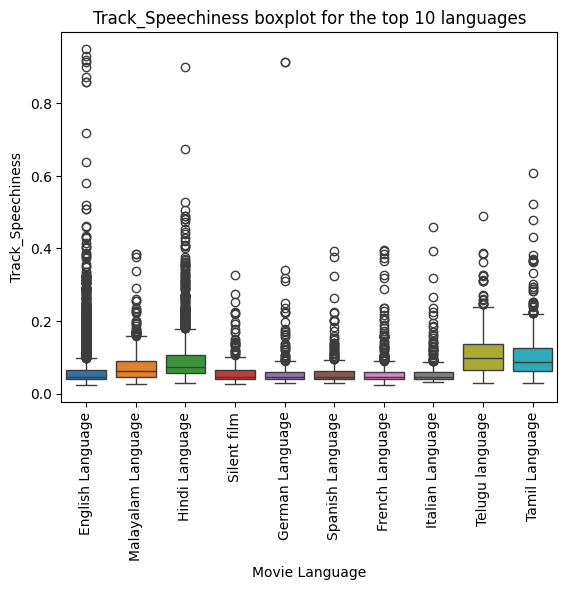

Track_Tempo


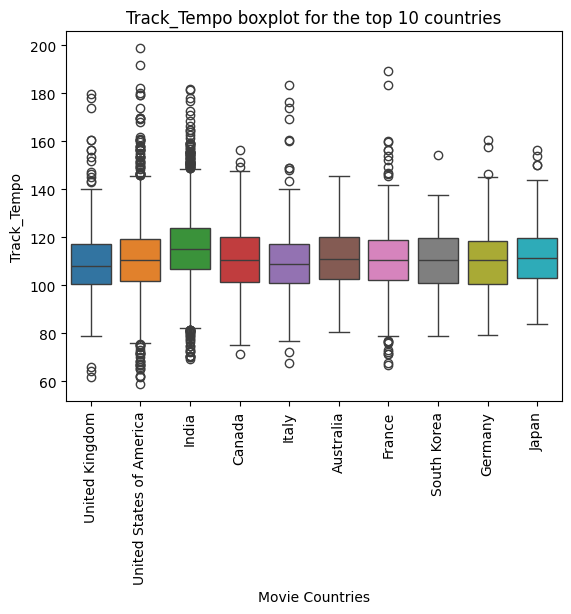

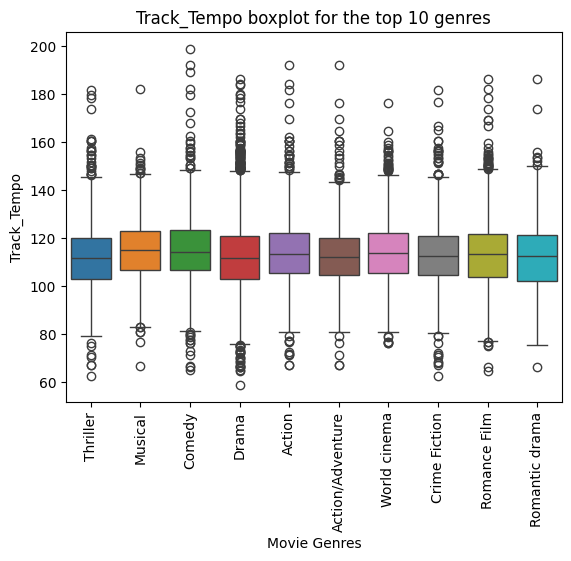

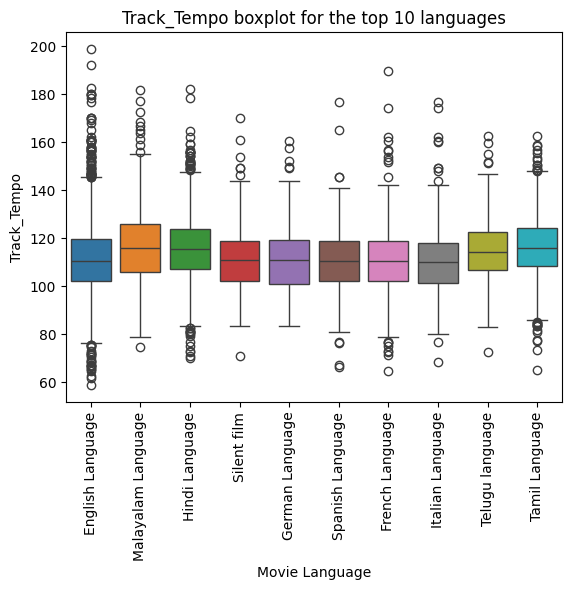

Track_Valence


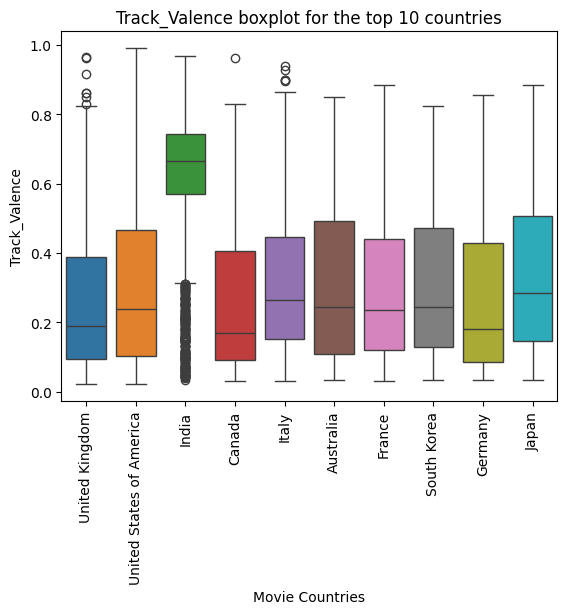

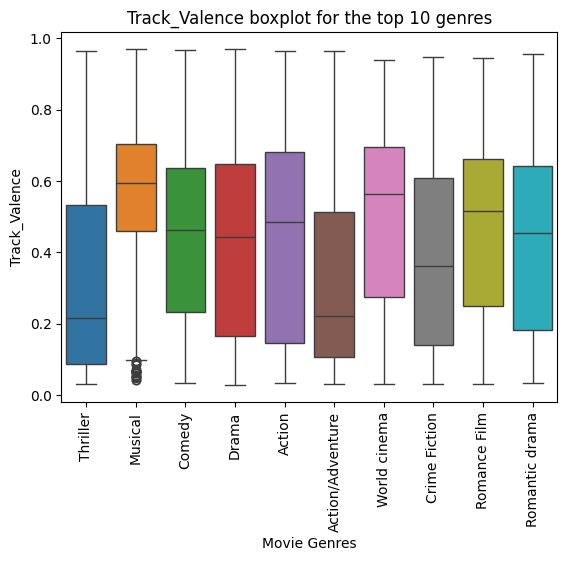

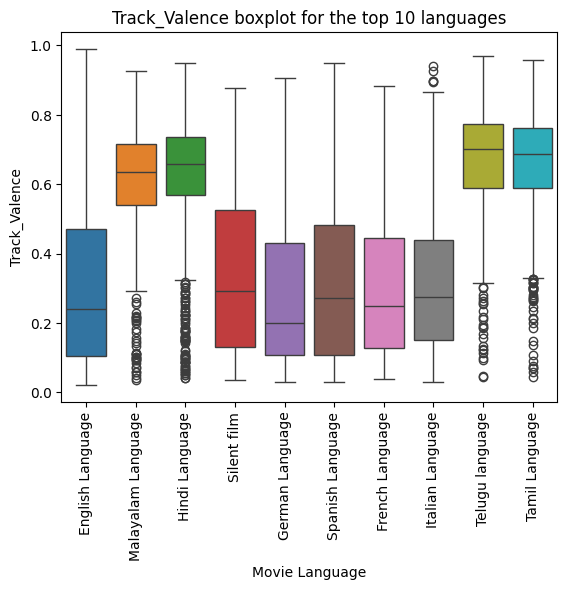

In [55]:
#Box Plots for all the Music Features
for i in toplot.columns:
    print(i)
    box(data=df_countries2_top10, x="Movie_Countries", y=i, xlabel="Movie Countries", ylabel= i, title=f"{i} boxplot for the top 10 countries")
    box(data=df_genres2_top10, x="Movie_Genres", y=i, xlabel="Movie Genres", ylabel= i, title=f"{i} boxplot for the top 10 genres")
    box(data=df_languages2_top10, x="Movie_Languages", y=i, xlabel="Movie Language", ylabel= i, title=f"{i} boxplot for the top 10 languages")

In [56]:
box_html(data=df_countries2_top10, x="Movie_Countries", y="Track_Duration", labels = "Movie_Countries", log = True, xlabel="Movie Countries", ylabel= "Logarithmic Track Duration", title=f"Boxplot of Track Duration for the Movies of the Top 10 Countries", filename = "duration_country_spotify.html")
box_html(data=df_languages2_top10, x="Movie_Languages", y="Track_Energy", labels = "Movie_Languages", xlabel="Movie Languages", ylabel= "Track Energy", title=f"Boxplot of Track Energy for the Movies in the Top 10 Languages", filename = "energy_lang_spotify.html")
box_html(data=df_countries2_top10, x="Movie_Countries", y="Track_Instrumentalness", labels = "Movie_Countries", xlabel="Movie Countries", ylabel= "Track Instrumentalness", title=f"Boxplot of Track Instrumentalness for the Movies of the Top 10 Countries", filename = "instrumentalness_country_spotify.html")
box_html(data=df_countries2_top10, x="Movie_Countries", y="Track_Loudness", labels = "Movie_Countries", xlabel="Movie Countries", ylabel= "Track Loudness", title=f"Boxplot of Track Loudness for the Movies of the Top 10 Countries", filename = "loudness_country_spotify.html")
box_html(data=df_countries2_top10, x="Movie_Countries", y="Track_Speechiness", labels = "Movie_Countries", log = True, xlabel="Movie Countries", ylabel= "Logarithmic Track Speechiness", title=f"Boxplot of Track Speechiness for the Movies of the Top 10 Countries", filename = "speechiness_country_spotify.html")
box_html(data=df_countries2_top10, x="Movie_Countries", y="Track_Valence", labels = "Movie_Countries", xlabel="Movie Countries", ylabel= "Track Valence", title=f"Boxplot of Track Valence for the Movies of the Top 10 Countries", filename = "valence_country_spotify.html")

As was evident from the box plots (and we also noticed this from our scatterplot matrix), the duration and speechiness of a track follow highly heavy tailed distributions. Therefore, we use a logarithmic y-axis to clearly see the frequencies of the disproprotionately large values since it uses a scale ordered by magnitude.

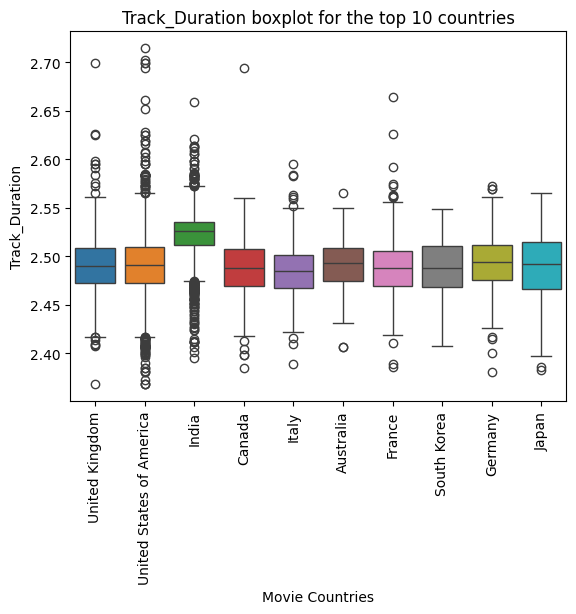

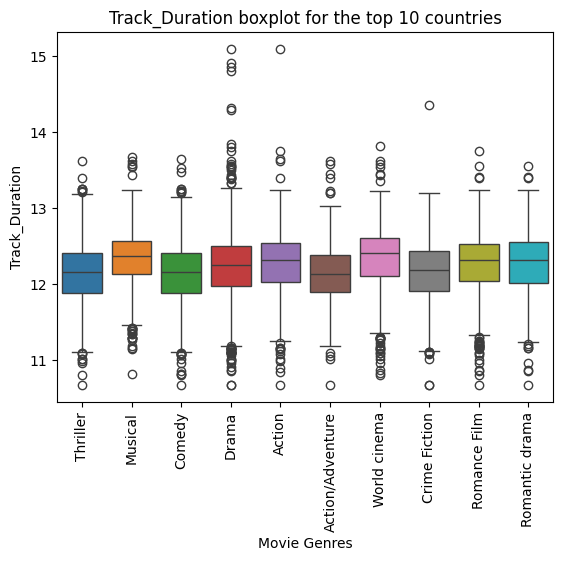

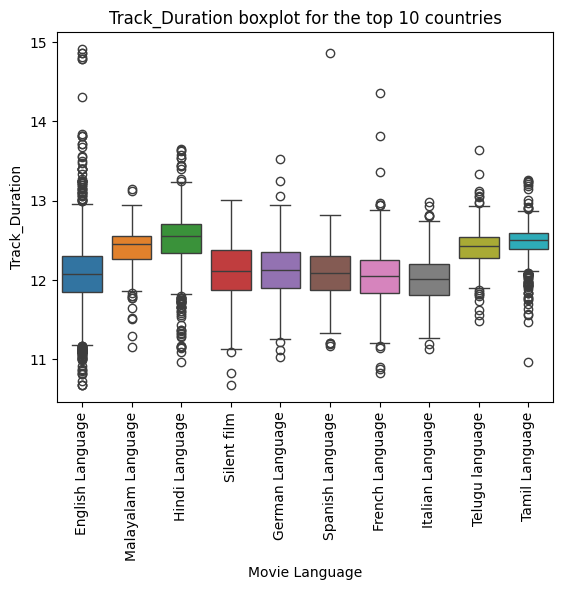

In [62]:
log_cat = ['Track_Duration']
for i in log_cat:
    box(data=df_countries2_top10, x="Movie_Countries", y=i, log = True, xlabel="Movie Countries", ylabel= i, title=f"{i} boxplot for the top 10 countries")
    box(data=df_genres2_top10, x="Movie_Genres", y=i, log = True, xlabel="Movie Genres", ylabel= i, title=f"{i} boxplot for the top 10 countries")
    box(data=df_languages2_top10, x="Movie_Languages", y=i, log = True, xlabel="Movie Language", ylabel= i, title=f"{i} boxplot for the top 10 countries")

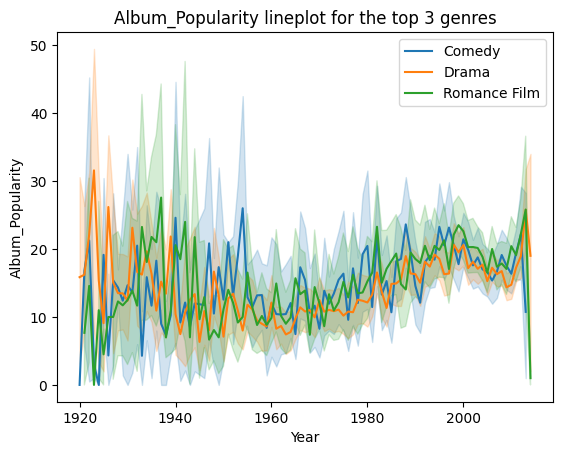

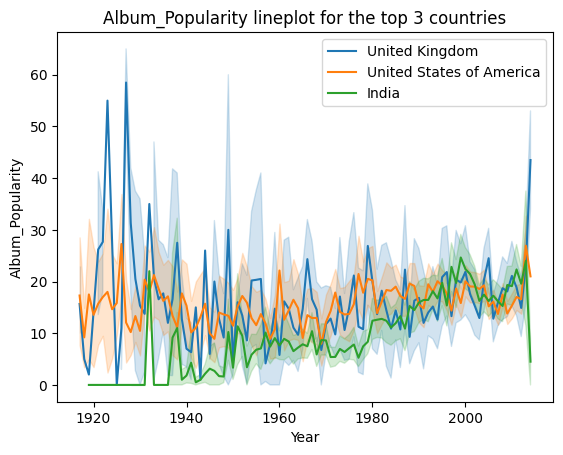

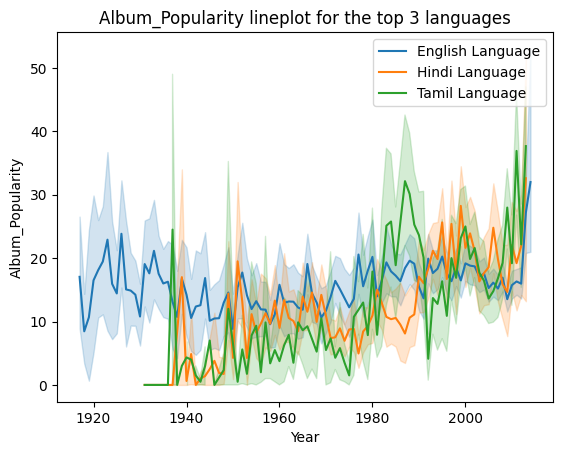

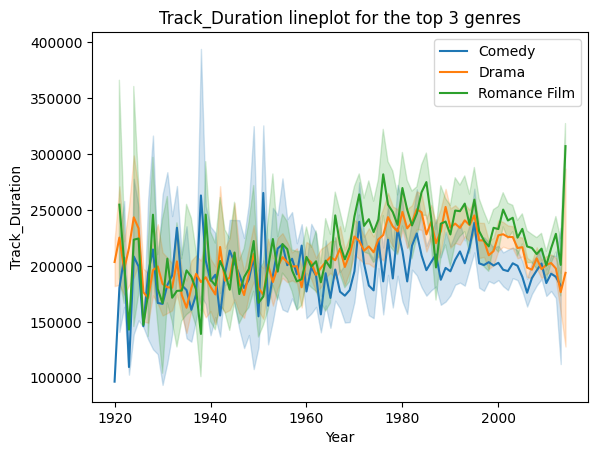

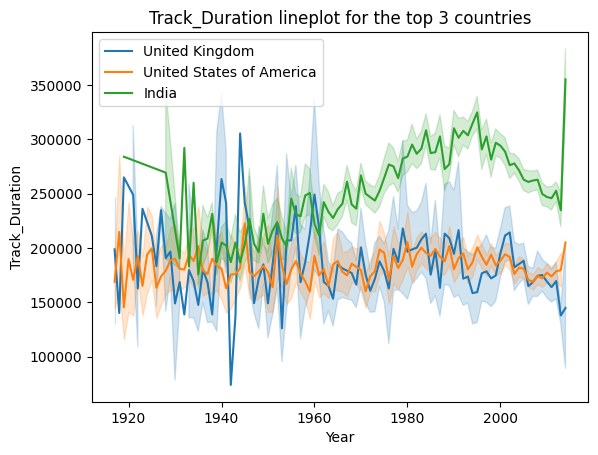

...

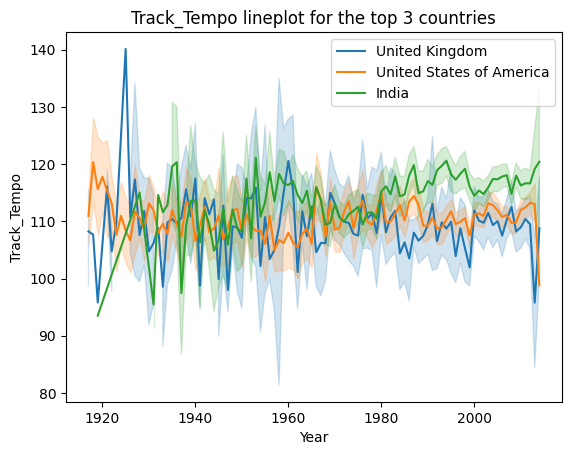

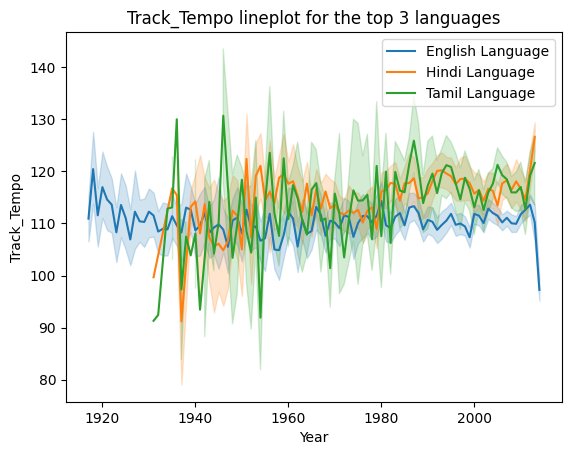

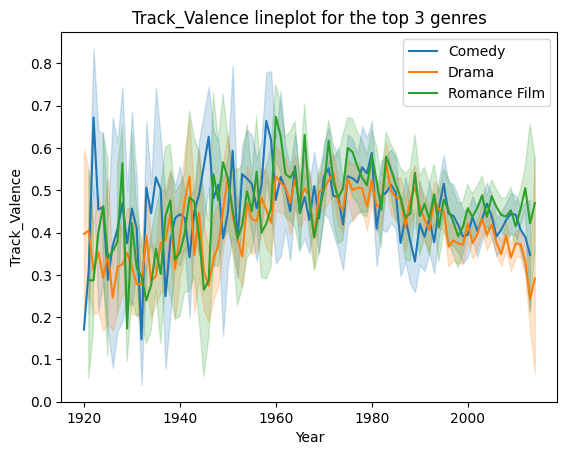

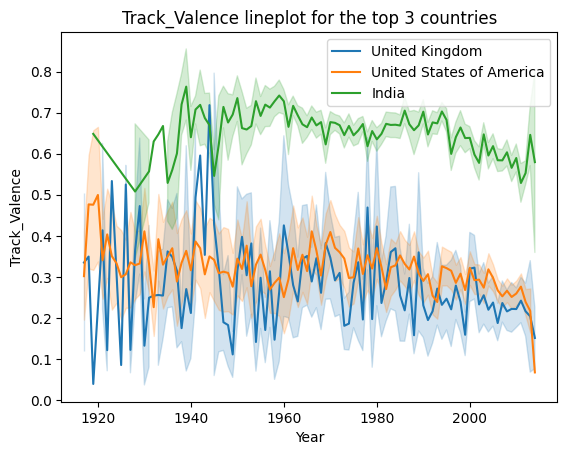

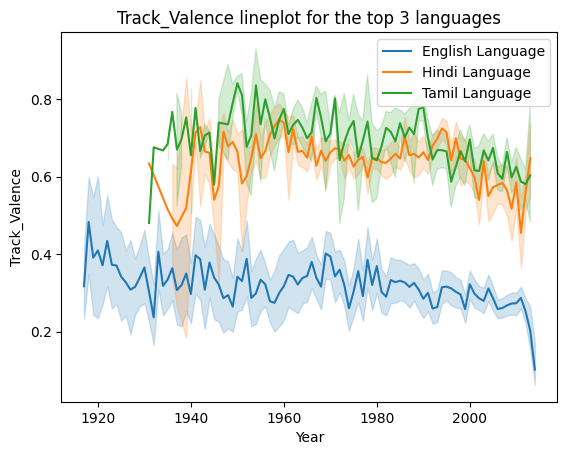

In [63]:
#Line Plots
for i in toplot.columns:
    line(data=df_genres2_top3, x="Movie_Release_Year", y=i, hue="Movie_Genres", title=f"{i} lineplot for the top 3 genres", xlabel="Year", ylabel=i, remove_outliers=True)
    line(data=df_countries2_top3, x="Movie_Release_Year", y=i, hue="Movie_Countries", title=f"{i} lineplot for the top 3 countries", xlabel="Year", ylabel=i,remove_outliers=True)
    line(data=df_languages2_top3, x="Movie_Release_Year", y=i, hue="Movie_Languages", title=f"{i} lineplot for the top 3 languages", xlabel="Year", ylabel=i,remove_outliers=True)

In [ ]:
#Used for producing interactive plots 
app = Dash(__name__)


available_columns = [
    'Album_Popularity', 
    'Track_Acousticness', 'Track_Danceability', 'Track_Energy', 
    'Track_Instrumentalness', 'Track_Liveness', 'Track_Tempo', 
    'Track_Valence'
]  # Columns for the checklist options

app.layout = html.Div([
    html.H4('Boxplot with Multiple Columns'),
    html.P("x-axis:"),
    dcc.Checklist(
        id='x-axis', 
        options=['Movie_Languages', 'Movie_Countries', 'Movie_Genres'
        ],
        value=['Movie_Countries'], 
        inline=True
    ),
    html.P("y-axis:"),
    dcc.RadioItems(
        id='y-axis', 
        options=available_columns,
        value='Track_Loudness', 
        inline=True
    ),
    dcc.Graph(id="graph"),
])

@app.callback(
    Output("graph", "figure"), 
    [Input("x-axis", "value"),
     Input("y-axis", "value")]
)
def generate_chart(x, y):
    if x == ['Movie_Countries']:
        df = df_countries2_top10
        x_label = 'Movie_Countries'
    elif x == ['Movie_Languages']:
        df = df_languages2_top10
        x_label = 'Movie_Languages'
    else:  # x == 'genres'
        df = df_genres2_top10
        x_label = 'Movie_Genres'
    
    # Generate box plot for each selected y-axis column
    fig = px.box(df, x=x_label, y=y, color = x_label, 
                 category_orders={x_label: sorted(df[x_label].unique())})
    
    return fig

if __name__ == '__main__':
    app.run_server(debug=True, port=8053)


In [ ]:
#Used for producing interactive plots 

app = Dash(__name__)


available_columns = ['Track_Duration', 'Track_Speechiness'] # Columns for the checklist options

app.layout = html.Div([
    html.H4('Boxplot with Multiple Columns'),
    html.P("x-axis:"),
    dcc.Checklist(
        id='x-axis', 
        options=['Movie_Languages', 'Movie_Countries', 'Movie_Genres'
        ],
        value=['Movie_Countries'], 
        inline=True
    ),
    html.P("y-axis:"),
    dcc.RadioItems(
        id='y-axis', 
        options=available_columns,
        value='Track_Duration', 
        inline=True
    ),
    dcc.Graph(id="graph"),
])

@app.callback(
    Output("graph", "figure"), 
    [Input("x-axis", "value"),
     Input("y-axis", "value")]
)
def generate_chart(x, y):
    if x == ['Movie_Countries']:
        df = df_countries2_top10
        x_label = 'Movie_Countries'
    elif x == ['Movie_Languages']:
        df = df_languages2_top10
        x_label = 'Movie_Languages'
    else:  # x == 'genres'
        df = df_genres2_top10
        x_label = 'Movie_Genres'
    
    # Generate box plot for each selected y-axis column
    fig = px.box(df, x=x_label, y=y, 
                 log_y = True, color = x_label,
                 category_orders={x_label: sorted(df[x_label].unique())})
    
    return fig

if __name__ == '__main__':
    app.run_server(debug=True, port=8053)


We initially thought of movie genre as a possible confounder and thus, created box plots and line plots for music features across movie genres. But although different melodies come to our mind about what music belongs to a certain genre of music, surprisingly, in all our plots, none of this is clearly visible. Films of different genres present quite similar characteristics regarding the music played in them. This can possibly be due to the fact that emotions in these different genres of movies are quite overlapping and so, the distribution of music features could be similar among them. We will look at this association more closely in our next section where we analyse the long term relationships between emotions and music but for now, we can clearly therefore exclude the movie genre as a possible confounders.

From all the other plots, we can discern that the music in films produced in India often differs from the films produced in other countries and/or continents (US, Europe). This is also evident for the music in the films in Hindi, Tamil and Malayalam languages which is expected since these films are produced in India. We will quickly state the music features (and our findings corresponding to them) where we discovered a significant difference.

**Danceability**: The outcomes of our graphs show an elevated danceability in films produced in India, as well as for films produced in the languages Telugu, Tamil and Malayalam which is expected since these are Indian languages. Only looking at the top 3 countries/languages, this is true throughout the years.

**Energy**: Music in films produced in India seem to have a higher energy than music in films produced in countries such as Italy, France and UK. This is again evident from the plots of films in the Indian language. This is true especially for the period after 1950.

**Instrumentalness**: In the film music of India, the instrumentalness is significantly lower than that of the other countries. Again, the same trend is seen in the music of films in the languages Tamil and Hindi. This is especially true for movies produced after 1950.

**Speechiness**: The outcomes of our graphs show an elevated speechiness in films produced in India, as well as for films produced in the languages Telugu and Tamil which is expected since these are Indian languages. Only looking at the top 3 countries/languages, this is true throughout the years.

**Loudness**: Music in films from India is generally louder than the one in the films from Italy, France, Germany and UK. This again applies (as expected) to the music in films in the languages Malayalam, Hindi, Tamil. These differences are especially significant after 1950.

**Valence**: Regarding positivity, music in Indian movies has a higher track valence than movies produced in other countries. Same can be said for the films produced in the languages Malayalam, Hindi and Tamil (as expected). This is true throughout our timeline.

**Duration**: As a last feature where we found differences, the track duration of Indian movies is normally higher compared to that in the films produced elsewhere. Again, this can be seen (as expected) for Tamil, Hindi and Malayalam languages. This is especially the case for the years after 1960.

But there are also indifferent music features…for the features album popularity, acousticness, liveness and tempo, no clear distinctions could be seen in the boxplots. The line graphs show for liveness a distinction after 1950, however, for tempo there is still no visible difference. For acousticness, the films in India have a higher acousticness before 1990, but this changes after this year. Same applies for the Music in Indian languages.

## Performing T-tests for Identifying Country-Specific Music
<a id="11"></a>

In [64]:
#USA
us_movies = df_countries2[df_countries2['Movie_Countries'] == 'United States of America']
rest_of_the_world_movies = df_countries2[df_countries2['Movie_Countries'] != 'United States of America']
music_t_test_net = []
for attribute in toplot:
    t_stat, p_value = ttest_ind(us_movies[attribute], rest_of_the_world_movies[attribute])
    music_t_test_dict = {'Music Feature': attribute, 'T-Statistic':t_stat, 'p-value':p_value}
    music_t_test_net.append(music_t_test_dict)
music_t_test_df = pd.DataFrame(music_t_test_net)
display(music_t_test_df)

,Music Feature,T-Statistic,p-value
0,Album_Popularity,8.749581,2.341532e-18
1,Track_Duration,-20.752654,1.778110e-94
2,Track_Acousticness,-6.301109,3.028901e-10
3,Track_Danceability,-25.436396,4.451672e-140
4,Track_Energy,-25.876532,8.361969e-145
5,Track_Instrumentalness,30.969377,7.774671e-205
6,Track_Liveness,-16.804179,7.425220e-63
7,Track_Loudness,-28.548523,4.374083e-175
8,Track_Speechiness,-11.805560,4.892075e-32
9,Track_Tempo,-8.773169,1.901162e-18


The remarkably low p-values across all features, such as album popularity, track duration, acousticness, danceability, energy, instrumentalness, liveness, loudness, speechiness, tempo, and valence, strongly reject the null hypothesis that there is no distinction between the two groups. These findings suggest that not only do geographical differences exist in terms of album popularity, but specific musical attributes vary significantly between the United States and the rest of the world. American movie albums are significantly more popular than the rest of the world, which is not surprising since the US music market is the largest music market in the world, particularly on spotify (70% of the songs on Spotify’s Global Top-50 playlist were recorded by US-based artists). However, while they are much more instrumental than other countries’ music, American movie music is shorter and has a lower score in all the other music traits.

In [65]:
#INDIA
india_movies = df_countries2[df_countries2['Movie_Countries'] == 'India']
rest_of_the_world_movies = df_countries2[df_countries2['Movie_Countries'] != 'India']
music_t_test_net = []
for attribute in toplot:
    t_stat, p_value = ttest_ind(india_movies[attribute], rest_of_the_world_movies[attribute])
    music_t_test_dict = {'Music Feature': attribute, 'T-Statistic':t_stat, 'p-value':p_value}
    music_t_test_net.append(music_t_test_dict)
music_t_test_df = pd.DataFrame(music_t_test_net)
display(music_t_test_df)

,Music Feature,T-Statistic,p-value
0,Album_Popularity,-6.468759,1.015435e-10
1,Track_Duration,45.310030,0.000000e+00
2,Track_Acousticness,2.865765,4.165200e-03
3,Track_Danceability,55.292110,0.000000e+00
4,Track_Energy,56.237792,0.000000e+00
5,Track_Instrumentalness,-74.115740,0.000000e+00
6,Track_Liveness,42.086584,0.000000e+00
7,Track_Loudness,57.434156,0.000000e+00
8,Track_Speechiness,29.513087,1.116265e-186
9,Track_Tempo,18.548401,4.834169e-76


Track Duration, Acousticness, Danceability, Energy, Liveness, Loudness, Speechiness, Tempo and Valence are significantly greater in the music of Indian movies than for movies of other countries. This directly corresponds to the large number of festivals, dance, theatre and folk traditions which are intangible aspects of India’s cultural heritage. In exact contrast, instrumentalness is significantly lower than for movies of other countries and this is due to the fact that spotify treata "Ooh" and "aah" sounds as instrumental which are dominant in western music and not at all in India. Album Popularity is significantly lower for music of Indian movies and is expected because the Spotify user base is predominantly the Americas and Europe.

In [66]:
uk_movies = df_countries2[df_countries2['Movie_Countries'] == 'United Kingdom']
rest_of_the_world_movies = df_countries2[df_countries2['Movie_Countries'] != 'United Kingdom']
music_t_test_net = []
for attribute in toplot:
    t_stat, p_value = ttest_ind(uk_movies[attribute], rest_of_the_world_movies[attribute])
    music_t_test_dict = {'Music Feature': attribute, 'T-Statistic':t_stat, 'p-value':p_value}
    music_t_test_net.append(music_t_test_dict)
music_t_test_df = pd.DataFrame(music_t_test_net)
display(music_t_test_df)

,Music Feature,T-Statistic,p-value
0,Album_Popularity,3.150509,1.632723e-03
1,Track_Duration,-8.211547,2.340849e-16
2,Track_Acousticness,3.830489,1.283545e-04
3,Track_Danceability,-16.303592,2.657948e-59
4,Track_Energy,-15.109115,3.064702e-51
5,Track_Instrumentalness,16.357750,1.109292e-59
6,Track_Liveness,-9.237519,2.817929e-20
7,Track_Loudness,-15.607362,1.568118e-54
8,Track_Speechiness,-6.388766,1.716320e-10
9,Track_Tempo,-7.430328,1.135355e-13


The results show the similarity of the musical feature of US and UK movies. Lots of their music styles are overlapping: American blues, jazz, rock and roll were influencing the music of the UK, just like british, irish, scottish music influencing the American music. For this reason, the overlaps between British and American music are no surprise as they have a common history. 

# Connecting Music with Emotions Portrayed by Movies
<a id="12"></a>

This research embarks on a journey into the heart of the dynamic interplay between the nuanced language of emotions embedded within movie plot summaries and the features of music present in the movies. In this exploration, we leverage the power of DistilBERT, a cutting-edge transformer model, pre-trained specifically for emotion classification. BERT allows us to decode the sentiment scores of love, sadness, joy, anger, fear and also surprise that lie beneath the movie plot summaries. 

We execute the procedure (code) for affecting the emotion classification on only a sample of the movie plot summaries dataset since running it on the entire plot summaries dataset takes quite a lot of time (~ 4-5 hours). We ran the same code as shown for the sample for the entire plot summaries dataset and then saved the generated file for ease in further analysis.

## Loading the Movie Plot Summaries Dataset


In the `plot_summaries.txt` file, the data doesn't have a predefined header describing what data is present in the different columns. Therefore, the column names need to be defined before loading the file into a dataframe

In [67]:
#List of column names/labels to be used while reading the files into the dataframes since the files do not contain any column labels

plot_summaries_column_names = ['Wikipedia_Movie_ID',
'Movie_Plot_Summary']

In [68]:
#Load the movie plot summaries

movie_plot_summaries = pd.read_table(os.path.join(MAIN_DATA_PATH,"plot_summaries.txt"),header = None, names = plot_summaries_column_names)
display(movie_plot_summaries)

,Wikipedia_Movie_ID,Movie_Plot_Summary
0,23890098,"Shlykov, a hard-working taxi driver and Lyosha..."
1,31186339,The nation of Panem consists of a wealthy Capi...
2,20663735,Poovalli Induchoodan is sentenced for six yea...
3,2231378,"The Lemon Drop Kid , a New York City swindler,..."
4,595909,Seventh-day Adventist Church pastor Michael Ch...
...,...,...
42298,34808485,"The story is about Reema , a young Muslim scho..."
42299,1096473,"In 1928 Hollywood, director Leo Andreyev look..."
42300,35102018,American Luthier focuses on Randy Parsons’ tra...
42301,8628195,"Abdur Rehman Khan , a middle-aged dry fruit se..."


We have movie plot summaries for more than 50% of the movies in the CMU dataset. That's great!

In [69]:
#Check the datatypes of the columns
movie_plot_summaries.dtypes

Wikipedia_Movie_ID     int64
Movie_Plot_Summary    object
dtype: object

In [70]:
#Display the percentages of missing values
(movie_plot_summaries.isna().sum()/len(movie_metadata))*100

Wikipedia_Movie_ID    0.0
Movie_Plot_Summary    0.0
dtype: float64

We don't have any missing values in any columns in the plot summaries dataset!

In [71]:
from transformers import pipeline

emotion_classifier = pipeline("text-classification",model='bhadresh-savani/distilbert-base-uncased-emotion', return_all_scores=True)

DistilBERT only operates on sentences of a length of 512 tokens. This typically corresponds to anywhere between 50-100 words Our experiments revealed that a sentence word length of 50 works best for our dataset since then the plot summary sentences can be analysed by DistilBERT. Accordingly, we split the plot summary of every movie into sentence chunks of word length `chunk_len` = 50 using `generate_word_chunks()` and `generate_sentence_chunks()` and then applied DistilBERT to all these sentence chunks via `generate_chunkwise_emotions()` to get the emotions of all the sentence chunks in all plot summaries.

In [72]:
def generate_word_chunks(txt, chunk_len):
    
    #identify words
    word_net = txt.split()
  
    #split the plot summary into lists of words of length chunk_len
    for i in range(0, len(word_net), chunk_len):
        yield word_net[i:i + chunk_len]


def generate_sentence_chunks(txt, chunk_len):
    
    #generate the word chunks
    word_chunk_net = list(generate_word_chunks(txt, chunk_len))

    #generate the sentence chunks
    sentence_chunk_net = [" ".join(word_chunk) for word_chunk in word_chunk_net]

    return sentence_chunk_net

def generate_chunkwise_emotions(sentence_chunk_net, emotion_classifier):
    
    #apply the emotion classifier to every sentence chunk in the plot summary
    chunkwise_emotions = list(map(emotion_classifier,sentence_chunk_net))

    return chunkwise_emotions

In [73]:
#Generate sample of the plot summaries dataset
sample_movie_plot_summaries = movie_plot_summaries.sample(n = 100)

In [74]:
#Chunk the plot summaries
sample_movie_plot_summaries['Chunked_Movie_Plot_Summary'] = sample_movie_plot_summaries['Movie_Plot_Summary'].apply(lambda x: generate_sentence_chunks(x,50))

In [75]:
display(sample_movie_plot_summaries)

,Wikipedia_Movie_ID,Movie_Plot_Summary,Chunked_Movie_Plot_Summary
14511,16156731,"Five prostitutes work at Dreamland, in Tokyo's...","[Five prostitutes work at Dreamland, in Tokyo'..."
23105,5221915,The film begins when a couple disappear while ...,[The film begins when a couple disappear while...
28987,19554890,{{plot}} The film begins with a video document...,[{{plot}} The film begins with a video documen...
1425,31048316,"In Lindsay Lohan's Indian Journey, Lohan meets...","[In Lindsay Lohan's Indian Journey, Lohan meet..."
18085,34059175,Kate finds herself reliving Christmas Eve ove...,[Kate finds herself reliving Christmas Eve ove...
...,...,...,...
19288,32024869,Dhuaan is a Suspense thriller film starring Mi...,[Dhuaan is a Suspense thriller film starring M...
15075,24372734,"Moti is a ""gur"" trader who trades in the sea...","[Moti is a ""gur"" trader who trades in the seas..."
26383,4316523,The young d'Artagnan arrives in Paris with dre...,[The young d'Artagnan arrives in Paris with dr...
18779,32374620,The film is based on Sthreedhanam by C. V. Nir...,[The film is based on Sthreedhanam by C. V. Ni...


In [76]:
#Get the emotions of the plot summaries
sample_movie_plot_summaries['Movie_Plot_Emotions'] = sample_movie_plot_summaries['Chunked_Movie_Plot_Summary'].apply(lambda x: generate_chunkwise_emotions(x, emotion_classifier))

In [77]:
display(sample_movie_plot_summaries)

,Wikipedia_Movie_ID,Movie_Plot_Summary,Chunked_Movie_Plot_Summary,Movie_Plot_Emotions
14511,16156731,"Five prostitutes work at Dreamland, in Tokyo's...","[Five prostitutes work at Dreamland, in Tokyo'...","[[[{'label': 'sadness', 'score': 0.95663803815..."
23105,5221915,The film begins when a couple disappear while ...,[The film begins when a couple disappear while...,"[[[{'label': 'sadness', 'score': 0.10388974100..."
28987,19554890,{{plot}} The film begins with a video document...,[{{plot}} The film begins with a video documen...,"[[[{'label': 'sadness', 'score': 0.01971543207..."
1425,31048316,"In Lindsay Lohan's Indian Journey, Lohan meets...","[In Lindsay Lohan's Indian Journey, Lohan meet...","[[[{'label': 'sadness', 'score': 0.03368108347..."
18085,34059175,Kate finds herself reliving Christmas Eve ove...,[Kate finds herself reliving Christmas Eve ove...,"[[[{'label': 'sadness', 'score': 0.07640610635..."
...,...,...,...,...
19288,32024869,Dhuaan is a Suspense thriller film starring Mi...,[Dhuaan is a Suspense thriller film starring M...,"[[[{'label': 'sadness', 'score': 0.03653349727..."
15075,24372734,"Moti is a ""gur"" trader who trades in the sea...","[Moti is a ""gur"" trader who trades in the seas...","[[[{'label': 'sadness', 'score': 0.01391801703..."
26383,4316523,The young d'Artagnan arrives in Paris with dre...,[The young d'Artagnan arrives in Paris with dr...,"[[[{'label': 'sadness', 'score': 0.07413763552..."
18779,32374620,The film is based on Sthreedhanam by C. V. Nir...,[The film is based on Sthreedhanam by C. V. Ni...,"[[[{'label': 'sadness', 'score': 0.38140770792..."


In [ ]:
#Takes long time to run and so, we ran this and saved the file which we will use in further analysis
movie_plot_summaries['Chunked_Movie_Plot_Summary'] = movie_plot_summaries['Movie_Plot_Summary'].apply(lambda x: generate_sentence_chunks(x,50))
movie_plot_summaries['Movie_Plot_Emotions'] = movie_plot_summaries['Chunked_Movie_Plot_Summary'].apply(lambda x: generate_chunkwise_emotions(x, emotion_classifier))
movie_plot_summaries.to_csv(rf'Plot_Summaries_with_Emotions.csv',encoding = 'utf-8-sig',index = False) 

### Pre-Processing and Analysis of the Movie Plot Emotions
<a id="13"></a>

In order to check for long term relationships between emotions and music features for particular genres of movies across the years, we first load our `Plot_Summaries_with_Emotions.csv` file which contains the plot summaries of 42303 movies in the CMU movie summary corpus with their corresponding chunk-wise emotions (which we computed using the aforementioned functions) into a dataframe. We then merge this dataframe with the `movie_metadata_with_music_and_emotions_data` (which contains metadata of movies and the music data corresponding to them) using the wikipedia movie ID as the unique identifier of a record in the dataframes so as to have the emotions and music data for movies together for further analysis. 

In [79]:
#Loading the plot summaries with their corresponding chunk-wise emotions 
plot_summaries_with_emotions_data = pd.read_csv(os.path.join(MAIN_DATA_PATH,"Plot_Summaries_with_Emotions.csv"), converters = {'Movie_Plot_Emotions':literal_eval})
display(plot_summaries_with_emotions_data)

,Wikipedia_Movie_ID,Movie_Plot_Summary,Chunked_Movie_Plot_Summary,Movie_Plot_Emotions
0,5204875,"Set in 1947 during the Partition of India, the...","['Set in 1947 during the Partition of India, t...","[[[{'label': 'sadness', 'score': 0.02339836396..."
1,11279445,A mismatched couple discovers that whatever ca...,"[""A mismatched couple discovers that whatever ...","[[[{'label': 'sadness', 'score': 0.12780217826..."
2,33912411,The Dekarangers encounter the Algolian Gas Dri...,['The Dekarangers encounter the Algolian Gas D...,"[[[{'label': 'sadness', 'score': 0.01681687124..."
3,17764048,Donna Foster works for publisher John Caine. S...,"[""Donna Foster works for publisher John Caine....","[[[{'label': 'sadness', 'score': 0.00413438724..."
4,13729387,The film is loosely-based on a real life story...,['The film is loosely-based on a real life sto...,"[[[{'label': 'sadness', 'score': 0.05732372775..."
...,...,...,...,...
42298,19938642,{{Rewrite}} Thodoros and Fofo are a married ...,['{{Rewrite}} Thodoros and Fofo are a married ...,"[[[{'label': 'sadness', 'score': 0.00294657004..."
42299,25521383,"The film is set in Dengfeng, Henan, during the...","[""The film is set in Dengfeng, Henan, during t...","[[[{'label': 'sadness', 'score': 0.00751298340..."
42300,33222541,A mercenary hunter named Martin David is hire...,"[""A mercenary hunter named Martin David is hir...","[[[{'label': 'sadness', 'score': 0.02662127465..."
42301,14156492,The first part of the film simply introduces M...,"[""The first part of the film simply introduces...","[[[{'label': 'sadness', 'score': 0.00099915883..."


In [80]:
#Removing the 'Movie_Plot_Summary' and 'Chunked_Movie_Plot_Summary' columns since they are not required for further analysis
plot_summaries_with_emotions_data.drop(columns = ['Movie_Plot_Summary','Chunked_Movie_Plot_Summary'], inplace = True)
display(plot_summaries_with_emotions_data)

,Wikipedia_Movie_ID,Movie_Plot_Emotions
0,5204875,"[[[{'label': 'sadness', 'score': 0.02339836396..."
1,11279445,"[[[{'label': 'sadness', 'score': 0.12780217826..."
2,33912411,"[[[{'label': 'sadness', 'score': 0.01681687124..."
3,17764048,"[[[{'label': 'sadness', 'score': 0.00413438724..."
4,13729387,"[[[{'label': 'sadness', 'score': 0.05732372775..."
...,...,...
42298,19938642,"[[[{'label': 'sadness', 'score': 0.00294657004..."
42299,25521383,"[[[{'label': 'sadness', 'score': 0.00751298340..."
42300,33222541,"[[[{'label': 'sadness', 'score': 0.02662127465..."
42301,14156492,"[[[{'label': 'sadness', 'score': 0.00099915883..."


In [81]:
#Merging the dataset containing the plot summaries with emotions with the dataset containing the movie metadata and music data 
#Merging is done on the 'Wikipedia_Movie_ID' column
movie_metadata_with_music_and_emotions_data = pd.merge(movie_metadata_with_music_data, plot_summaries_with_emotions_data, on='Wikipedia_Movie_ID', how = 'left')
#Remove all the records for which we don't have any plot summary emotions.
movie_metadata_with_music_and_emotions_data = movie_metadata_with_music_and_emotions_data[movie_metadata_with_music_and_emotions_data['Movie_Plot_Emotions'].notna()].reset_index(drop = True)
display(movie_metadata_with_music_and_emotions_data)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year,Album_Popularity,...,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,Movie_Plot_Emotions
0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],[United Kingdom],"[Thriller, Erotic thriller, Psychological thri...",1987.0,11.0,...,0.365419,0.583929,0.376714,0.681486,0.133129,-12.339000,0.043136,107.795429,0.424836,"[[[{'label': 'sadness', 'score': 0.01207493804..."
1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],[United States of America],"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0,50.0,...,0.784611,0.495500,0.216147,0.007870,0.167933,-19.369667,0.218728,107.623778,0.480222,"[[[{'label': 'sadness', 'score': 0.05561954900..."
2,9633533,Vandanam,1989-01-01,NaN,168.0,[Malayalam Language],[India],[Action],1989.0,23.0,...,0.758000,0.620333,0.638667,0.080651,0.238833,-8.261833,0.058267,94.274500,0.774000,"[[[{'label': 'sadness', 'score': 0.00691755861..."
3,29772142,Karayilekku Oru Kadal Dooram,2010-12-31,NaN,110.0,[Malayalam Language],[India],[Drama],2010.0,16.0,...,0.721857,0.530286,0.418714,0.000002,0.143686,-8.350714,0.046500,95.347143,0.357429,"[[[{'label': 'sadness', 'score': 0.02433557063..."
4,26623942,Kausthubham,2010-03-19,NaN,NaN,[Malayalam Language],[India],[Drama],2010.0,0.0,...,0.630143,0.523286,0.536857,0.000076,0.206571,-6.998857,0.053157,128.154429,0.523571,"[[[{'label': 'sadness', 'score': 0.34368705749..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8968,30863646,Mondo Cane,1962-01-01,NaN,108.0,[Italian Language],[Italy],"[Culture & Society, Horror, Mondo film, World ...",1962.0,0.0,...,0.501044,0.286650,0.344222,0.489493,0.202922,-16.730111,0.043689,103.945222,0.427700,"[[[{'label': 'sadness', 'score': 0.18193197250..."
8969,23613845,The Trial,2009-07-08,NaN,72.0,[English Language],[Ireland],[Documentary],2009.0,1.0,...,0.511647,0.210805,0.118274,0.895632,0.127089,-23.505789,0.047553,94.578474,0.045442,"[[[{'label': 'sadness', 'score': 0.03430414199..."
8970,20244619,Mirage,1972-01-01,NaN,82.0,[Spanish Language],[Peru],"[Drama, World cinema]",1972.0,5.0,...,0.790818,0.332700,0.327391,0.302327,0.183345,-13.723455,0.051355,107.316182,0.201155,"[[[{'label': 'sadness', 'score': 0.03254461660..."
8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],[India],"[Romance Film, Action, Drama, Science Fiction]",1963.0,0.0,...,0.957800,0.547400,0.639200,0.006003,0.280400,-5.674200,0.160180,86.945800,0.894200,"[[[{'label': 'sadness', 'score': 0.00124905921..."


In order to extract the scores corresponding to the emotions from the dictionary in the nested lists in `Movie_Plot_Emotions` for every movie in `movie_metadata_with_music_and_emotions_data`, for every movie, we first deepflatten the main list so that we are only left with dictionaries corresponding to the chunkwise emotion scores. For computing the score for a particular emotion for the entire movie, we average the chunkwise scores for that emotion. In doing so (and so that it aids us in further analyses), we create 6 new columns (`sadness`,`joy`,`love`,`anger`,`fear`,`surprise`) in `movie_metadata_with_music_and_emotions_data` corresponding to the 6 unique emotions for which the scores were computed by the DistilBERT model. 

In [82]:
#Deepflattening the main emotions list (while ignoring the dicts since we need them for retrieving the emotion-wise scores)
movie_metadata_with_music_and_emotions_data['Movie_Plot_Emotions'] = movie_metadata_with_music_and_emotions_data['Movie_Plot_Emotions'].apply(lambda x: list(deepflatten(x, ignore = dict)))
display(movie_metadata_with_music_and_emotions_data)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year,Album_Popularity,...,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,Movie_Plot_Emotions
0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],[United Kingdom],"[Thriller, Erotic thriller, Psychological thri...",1987.0,11.0,...,0.365419,0.583929,0.376714,0.681486,0.133129,-12.339000,0.043136,107.795429,0.424836,"[{'label': 'sadness', 'score': 0.0120749380439..."
1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],[United States of America],"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0,50.0,...,0.784611,0.495500,0.216147,0.007870,0.167933,-19.369667,0.218728,107.623778,0.480222,"[{'label': 'sadness', 'score': 0.0556195490062..."
2,9633533,Vandanam,1989-01-01,NaN,168.0,[Malayalam Language],[India],[Action],1989.0,23.0,...,0.758000,0.620333,0.638667,0.080651,0.238833,-8.261833,0.058267,94.274500,0.774000,"[{'label': 'sadness', 'score': 0.0069175586104..."
3,29772142,Karayilekku Oru Kadal Dooram,2010-12-31,NaN,110.0,[Malayalam Language],[India],[Drama],2010.0,16.0,...,0.721857,0.530286,0.418714,0.000002,0.143686,-8.350714,0.046500,95.347143,0.357429,"[{'label': 'sadness', 'score': 0.0243355706334..."
4,26623942,Kausthubham,2010-03-19,NaN,NaN,[Malayalam Language],[India],[Drama],2010.0,0.0,...,0.630143,0.523286,0.536857,0.000076,0.206571,-6.998857,0.053157,128.154429,0.523571,"[{'label': 'sadness', 'score': 0.3436870574951..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8968,30863646,Mondo Cane,1962-01-01,NaN,108.0,[Italian Language],[Italy],"[Culture & Society, Horror, Mondo film, World ...",1962.0,0.0,...,0.501044,0.286650,0.344222,0.489493,0.202922,-16.730111,0.043689,103.945222,0.427700,"[{'label': 'sadness', 'score': 0.1819319725036..."
8969,23613845,The Trial,2009-07-08,NaN,72.0,[English Language],[Ireland],[Documentary],2009.0,1.0,...,0.511647,0.210805,0.118274,0.895632,0.127089,-23.505789,0.047553,94.578474,0.045442,"[{'label': 'sadness', 'score': 0.0343041419982..."
8970,20244619,Mirage,1972-01-01,NaN,82.0,[Spanish Language],[Peru],"[Drama, World cinema]",1972.0,5.0,...,0.790818,0.332700,0.327391,0.302327,0.183345,-13.723455,0.051355,107.316182,0.201155,"[{'label': 'sadness', 'score': 0.0325446166098..."
8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],[India],"[Romance Film, Action, Drama, Science Fiction]",1963.0,0.0,...,0.957800,0.547400,0.639200,0.006003,0.280400,-5.674200,0.160180,86.945800,0.894200,"[{'label': 'sadness', 'score': 0.0012490592198..."


In [83]:
def avg_emotion_score_by_type(emotion_score_net,emotion_type):
    '''
    Average the chunkwise emotion scores for a particular emotion
    
    Arguments:
        emotion_score_net = (list) List of dicts of emotions and their scores
        emotion_type = (str) Type of the emotion 
        
    Returns:
        the average score for the emotion identified via emotion_type
    '''
    return np.mean([d['score'] for d in emotion_score_net if d['label'] == emotion_type])

In [84]:
#Compute the average emotion scores for all the 6 unique emotions and create 6 new columns for the same
movie_metadata_with_music_and_emotions_data['sadness'] = movie_metadata_with_music_and_emotions_data['Movie_Plot_Emotions'].apply(lambda x: avg_emotion_score_by_type(x,'sadness'))
movie_metadata_with_music_and_emotions_data['joy'] = movie_metadata_with_music_and_emotions_data['Movie_Plot_Emotions'].apply(lambda x: avg_emotion_score_by_type(x,'joy'))
movie_metadata_with_music_and_emotions_data['love'] = movie_metadata_with_music_and_emotions_data['Movie_Plot_Emotions'].apply(lambda x: avg_emotion_score_by_type(x,'love'))
movie_metadata_with_music_and_emotions_data['anger'] = movie_metadata_with_music_and_emotions_data['Movie_Plot_Emotions'].apply(lambda x: avg_emotion_score_by_type(x,'anger'))
movie_metadata_with_music_and_emotions_data['fear'] = movie_metadata_with_music_and_emotions_data['Movie_Plot_Emotions'].apply(lambda x: avg_emotion_score_by_type(x,'fear'))
movie_metadata_with_music_and_emotions_data['surprise'] = movie_metadata_with_music_and_emotions_data['Movie_Plot_Emotions'].apply(lambda x: avg_emotion_score_by_type(x,'surprise'))

In [85]:
#Remove the 'Movie_Plot_Emotions' column since it's redundant now
movie_metadata_with_music_and_emotions_data.drop(columns = ['Movie_Plot_Emotions'], inplace = True)
display(movie_metadata_with_music_and_emotions_data)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year,Album_Popularity,...,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,sadness,joy,love,anger,fear,surprise
0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],[United Kingdom],"[Thriller, Erotic thriller, Psychological thri...",1987.0,11.0,...,-12.339000,0.043136,107.795429,0.424836,0.045011,0.052521,0.007739,0.621662,0.271099,0.001968
1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],[United States of America],"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0,50.0,...,-19.369667,0.218728,107.623778,0.480222,0.150088,0.192072,0.005774,0.599208,0.049823,0.003036
2,9633533,Vandanam,1989-01-01,NaN,168.0,[Malayalam Language],[India],[Action],1989.0,23.0,...,-8.261833,0.058267,94.274500,0.774000,0.022969,0.146409,0.117312,0.486444,0.224124,0.002742
3,29772142,Karayilekku Oru Kadal Dooram,2010-12-31,NaN,110.0,[Malayalam Language],[India],[Drama],2010.0,16.0,...,-8.350714,0.046500,95.347143,0.357429,0.179750,0.413046,0.013453,0.075648,0.208563,0.109539
4,26623942,Kausthubham,2010-03-19,NaN,NaN,[Malayalam Language],[India],[Drama],2010.0,0.0,...,-6.998857,0.053157,128.154429,0.523571,0.343687,0.058392,0.002177,0.007557,0.576422,0.011766
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8968,30863646,Mondo Cane,1962-01-01,NaN,108.0,[Italian Language],[Italy],"[Culture & Society, Horror, Mondo film, World ...",1962.0,0.0,...,-16.730111,0.043689,103.945222,0.427700,0.447692,0.002619,0.001544,0.524405,0.022296,0.001443
8969,23613845,The Trial,2009-07-08,NaN,72.0,[English Language],[Ireland],[Documentary],2009.0,1.0,...,-23.505789,0.047553,94.578474,0.045442,0.100417,0.029426,0.003153,0.651696,0.211320,0.003988
8970,20244619,Mirage,1972-01-01,NaN,82.0,[Spanish Language],[Peru],"[Drama, World cinema]",1972.0,5.0,...,-13.723455,0.051355,107.316182,0.201155,0.032545,0.422449,0.005407,0.055156,0.360494,0.123950
8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],[India],"[Romance Film, Action, Drama, Science Fiction]",1963.0,0.0,...,-5.674200,0.160180,86.945800,0.894200,0.002716,0.254963,0.001150,0.441659,0.293905,0.005606


We now compute and display a scatterplot matrix for identifying the distributions of emotion scores and any potential correlations between them.

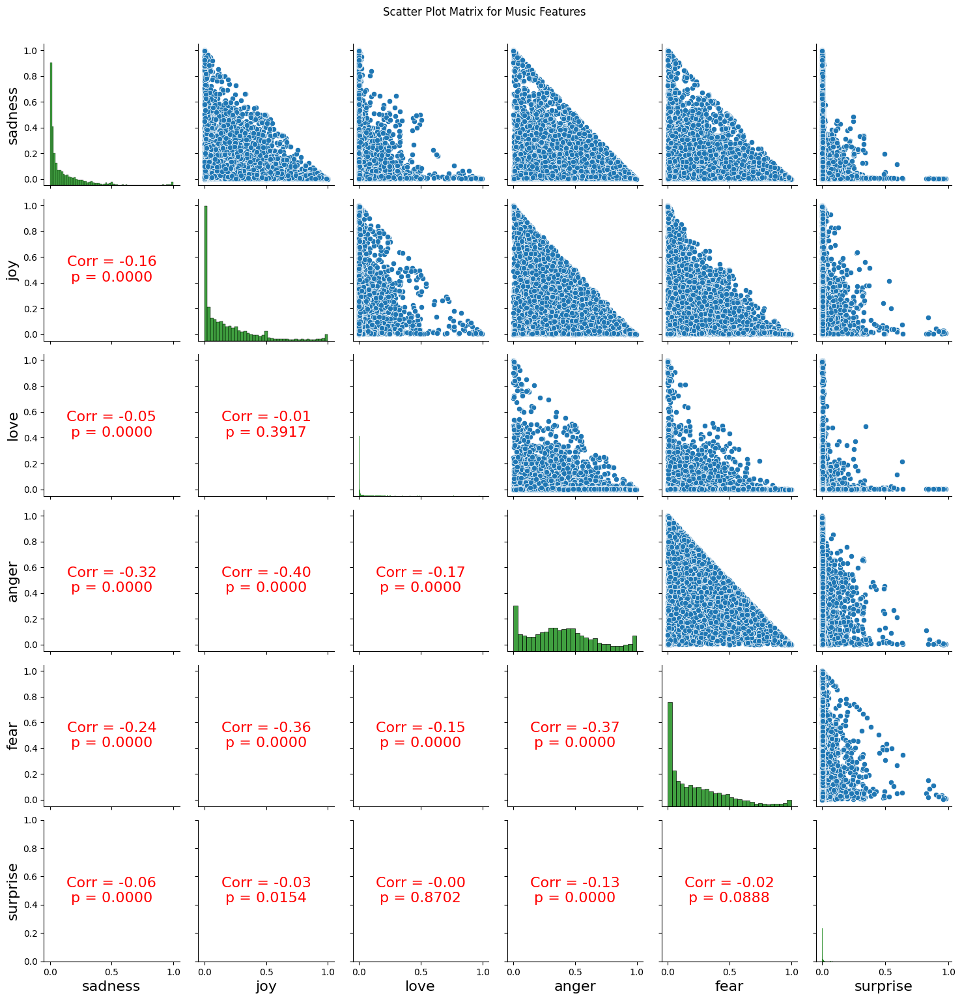

<Figure size 640x480 with 0 Axes>

In [86]:
pair_grid_w_p_values(movie_metadata_with_music_and_emotions_data[['sadness','joy','love','anger','fear','surprise']], 'emotions_scatterplotmatrix')

Clearly, none of the emotions share a significantly high correlation (correlation coeff. > 0.75) with one another.

Let's check the top 10 genres and countries for this dataset!

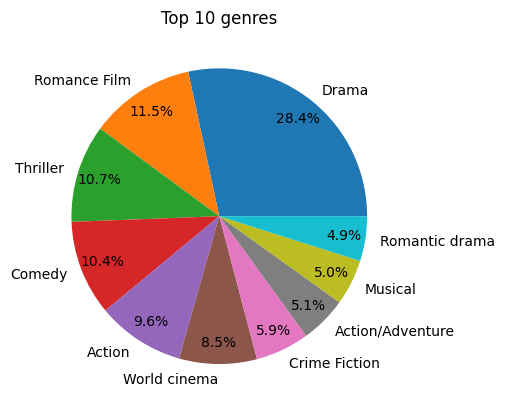

In [87]:
#different genres and/or their percentages maybe in the top 10 now
count_by_genre_emotions_net = get_category_wise_counts(list(movie_metadata_with_music_and_emotions_data['Movie_Genres']))

counts = np.array(list(count_by_genre_emotions_net.values()))
genres = np.array(list(count_by_genre_emotions_net.keys()))
idx_net_top10_genres_emotions_by_count = np.argsort(counts)[::-1][:10]
top10_genres_emotions = genres[idx_net_top10_genres_emotions_by_count]
counts_top10_genres_emotions = counts[idx_net_top10_genres_emotions_by_count]
pie_chart(counts_top10_genres_emotions,labels=top10_genres_emotions,title='Top 10 genres')

Clearly, Drama, Romance, Thriller, Comedy and Action are the top 5 genres and we would be concentrating on them for our further analysis.

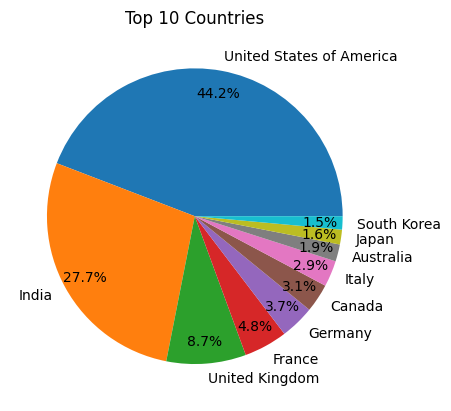

In [88]:
#different countries and/or their percentages maybe in the top 10 now
count_by_country_emotions_net = get_category_wise_counts(list(movie_metadata_with_music_and_emotions_data['Movie_Countries']))

counts = np.array(list(count_by_country_emotions_net.values()))
countries = np.array(list(count_by_country_emotions_net.keys()))
idx_net_top10_countries_emotions_by_count = np.argsort(counts)[::-1][:10]
top10_countries_emotions = countries[idx_net_top10_countries_emotions_by_count]
counts_top10_countries_emotions = counts[idx_net_top10_countries_emotions_by_count]

pie_chart(counts_top10_countries_emotions,labels=top10_countries_emotions,title='Top 10 Countries')

In [89]:
#Top 10 Representation
print(f'Top 10 Representation: {sum(counts_top10_countries_emotions)/sum(counts)*100}')
#Top 2 Representation
print(f'Top 3 Representation: {sum(counts_top10_countries_emotions[:2])/sum(counts)*100}')

Top 10 Representation: 88.77551020408163
Top 3 Representation: 63.8332691567193


Clearly, the top 2 countries: USA and India account for about 64% of the dataset which is quite high. So, we'll only concentrate on them now.

In [90]:
#Explode by genre
movie_metadata_with_music_and_emotions_data_by_genre = movie_metadata_with_music_and_emotions_data.explode('Movie_Genres').reset_index()
display(movie_metadata_with_music_and_emotions_data_by_genre)

,index,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year,...,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,sadness,joy,love,anger,fear,surprise
0,0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],[United Kingdom],Thriller,1987.0,...,-12.339000,0.043136,107.795429,0.424836,0.045011,0.052521,0.007739,0.621662,0.271099,0.001968
1,0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],[United Kingdom],Erotic thriller,1987.0,...,-12.339000,0.043136,107.795429,0.424836,0.045011,0.052521,0.007739,0.621662,0.271099,0.001968
2,0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],[United Kingdom],Psychological thriller,1987.0,...,-12.339000,0.043136,107.795429,0.424836,0.045011,0.052521,0.007739,0.621662,0.271099,0.001968
3,1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],[United States of America],Children's/Family,1964.0,...,-19.369667,0.218728,107.623778,0.480222,0.150088,0.192072,0.005774,0.599208,0.049823,0.003036
4,1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],[United States of America],Musical,1964.0,...,-19.369667,0.218728,107.623778,0.480222,0.150088,0.192072,0.005774,0.599208,0.049823,0.003036
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34500,8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],[India],Science Fiction,1963.0,...,-5.674200,0.160180,86.945800,0.894200,0.002716,0.254963,0.001150,0.441659,0.293905,0.005606
34501,8972,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],[India],Drama,1994.0,...,-8.454500,0.119383,116.656167,0.692833,0.135069,0.217895,0.001607,0.370146,0.272295,0.002989
34502,8972,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],[India],Action,1994.0,...,-8.454500,0.119383,116.656167,0.692833,0.135069,0.217895,0.001607,0.370146,0.272295,0.002989
34503,8972,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],[India],Crime,1994.0,...,-8.454500,0.119383,116.656167,0.692833,0.135069,0.217895,0.001607,0.370146,0.272295,0.002989


In [91]:
#Select the movies with a genre in the top 5 genres
movie_metadata_with_music_and_emotions_data_by_genre = movie_metadata_with_music_and_emotions_data_by_genre[movie_metadata_with_music_and_emotions_data_by_genre["Movie_Genres"].isin(top10_genres_emotions[:5])]
display(movie_metadata_with_music_and_emotions_data_by_genre)

,index,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year,...,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,sadness,joy,love,anger,fear,surprise
0,0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],[United Kingdom],Thriller,1987.0,...,-12.339000,0.043136,107.795429,0.424836,0.045011,0.052521,0.007739,0.621662,0.271099,0.001968
6,1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],[United States of America],Comedy,1964.0,...,-19.369667,0.218728,107.623778,0.480222,0.150088,0.192072,0.005774,0.599208,0.049823,0.003036
7,1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],[United States of America],Drama,1964.0,...,-19.369667,0.218728,107.623778,0.480222,0.150088,0.192072,0.005774,0.599208,0.049823,0.003036
10,2,9633533,Vandanam,1989-01-01,NaN,168.0,[Malayalam Language],[India],Action,1989.0,...,-8.261833,0.058267,94.274500,0.774000,0.022969,0.146409,0.117312,0.486444,0.224124,0.002742
11,3,29772142,Karayilekku Oru Kadal Dooram,2010-12-31,NaN,110.0,[Malayalam Language],[India],Drama,2010.0,...,-8.350714,0.046500,95.347143,0.357429,0.179750,0.413046,0.013453,0.075648,0.208563,0.109539
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34498,8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],[India],Action,1963.0,...,-5.674200,0.160180,86.945800,0.894200,0.002716,0.254963,0.001150,0.441659,0.293905,0.005606
34499,8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],[India],Drama,1963.0,...,-5.674200,0.160180,86.945800,0.894200,0.002716,0.254963,0.001150,0.441659,0.293905,0.005606
34501,8972,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],[India],Drama,1994.0,...,-8.454500,0.119383,116.656167,0.692833,0.135069,0.217895,0.001607,0.370146,0.272295,0.002989
34502,8972,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],[India],Action,1994.0,...,-8.454500,0.119383,116.656167,0.692833,0.135069,0.217895,0.001607,0.370146,0.272295,0.002989


In [92]:
#Finally, explode by country
country_wise_movie_metadata_with_music_and_emotions_data_by_genre = movie_metadata_with_music_and_emotions_data_by_genre.explode('Movie_Countries').reset_index()
display(country_wise_movie_metadata_with_music_and_emotions_data_by_genre)

,level_0,index,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,...,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,sadness,joy,love,anger,fear,surprise
0,0,0,9363483,White Of The Eye,1987-01-01,NaN,110.0,[English Language],United Kingdom,Thriller,...,-12.339000,0.043136,107.795429,0.424836,0.045011,0.052521,0.007739,0.621662,0.271099,0.001968
1,6,1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],United States of America,Comedy,...,-19.369667,0.218728,107.623778,0.480222,0.150088,0.192072,0.005774,0.599208,0.049823,0.003036
2,7,1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],United States of America,Drama,...,-19.369667,0.218728,107.623778,0.480222,0.150088,0.192072,0.005774,0.599208,0.049823,0.003036
3,10,2,9633533,Vandanam,1989-01-01,NaN,168.0,[Malayalam Language],India,Action,...,-8.261833,0.058267,94.274500,0.774000,0.022969,0.146409,0.117312,0.486444,0.224124,0.002742
4,11,3,29772142,Karayilekku Oru Kadal Dooram,2010-12-31,NaN,110.0,[Malayalam Language],India,Drama,...,-8.350714,0.046500,95.347143,0.357429,0.179750,0.413046,0.013453,0.075648,0.208563,0.109539
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15669,34498,8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],India,Action,...,-5.674200,0.160180,86.945800,0.894200,0.002716,0.254963,0.001150,0.441659,0.293905,0.005606
15670,34499,8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],India,Drama,...,-5.674200,0.160180,86.945800,0.894200,0.002716,0.254963,0.001150,0.441659,0.293905,0.005606
15671,34501,8972,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],India,Drama,...,-8.454500,0.119383,116.656167,0.692833,0.135069,0.217895,0.001607,0.370146,0.272295,0.002989
15672,34502,8972,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],India,Action,...,-8.454500,0.119383,116.656167,0.692833,0.135069,0.217895,0.001607,0.370146,0.272295,0.002989


### India: Emotions and Music
<a id="14"></a>

In [93]:
#Extract the data of only the Indian movies from the entire dataset
indian_movie_metadata_with_music_and_emotions_data_by_genre = country_wise_movie_metadata_with_music_and_emotions_data_by_genre[country_wise_movie_metadata_with_music_and_emotions_data_by_genre['Movie_Countries'] == 'India']
display(indian_movie_metadata_with_music_and_emotions_data_by_genre)

,level_0,index,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,...,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,sadness,joy,love,anger,fear,surprise
3,10,2,9633533,Vandanam,1989-01-01,NaN,168.0,[Malayalam Language],India,Action,...,-8.261833,0.058267,94.274500,0.774000,0.022969,0.146409,0.117312,0.486444,0.224124,0.002742
4,11,3,29772142,Karayilekku Oru Kadal Dooram,2010-12-31,NaN,110.0,[Malayalam Language],India,Drama,...,-8.350714,0.046500,95.347143,0.357429,0.179750,0.413046,0.013453,0.075648,0.208563,0.109539
5,12,4,26623942,Kausthubham,2010-03-19,NaN,NaN,[Malayalam Language],India,Drama,...,-6.998857,0.053157,128.154429,0.523571,0.343687,0.058392,0.002177,0.007557,0.576422,0.011766
16,27,9,10419077,Raampur Ka Lakshman,1972-01-01,NaN,135.0,[Hindi Language],India,Drama,...,-12.025714,0.059600,111.663857,0.733143,0.342943,0.205253,0.002341,0.291599,0.155995,0.001869
24,39,14,36151270,Agneekaal,1990-10-19,NaN,NaN,[Hindi Language],India,Action,...,-9.900400,0.079920,131.218600,0.612000,0.250850,0.246188,0.000721,0.213248,0.287545,0.001448
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15669,34498,8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],India,Action,...,-5.674200,0.160180,86.945800,0.894200,0.002716,0.254963,0.001150,0.441659,0.293905,0.005606
15670,34499,8971,19286279,Kalai Arasi,1963-04-19,NaN,NaN,[Tamil Language],India,Drama,...,-5.674200,0.160180,86.945800,0.894200,0.002716,0.254963,0.001150,0.441659,0.293905,0.005606
15671,34501,8972,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],India,Drama,...,-8.454500,0.119383,116.656167,0.692833,0.135069,0.217895,0.001607,0.370146,0.272295,0.002989
15672,34502,8972,15394941,Gopi Kishan,1994-12-02,NaN,NaN,[Hindi Language],India,Action,...,-8.454500,0.119383,116.656167,0.692833,0.135069,0.217895,0.001607,0.370146,0.272295,0.002989


Now, let us turn over to analysing the distribution of movies which portray different emotions via violin plots!

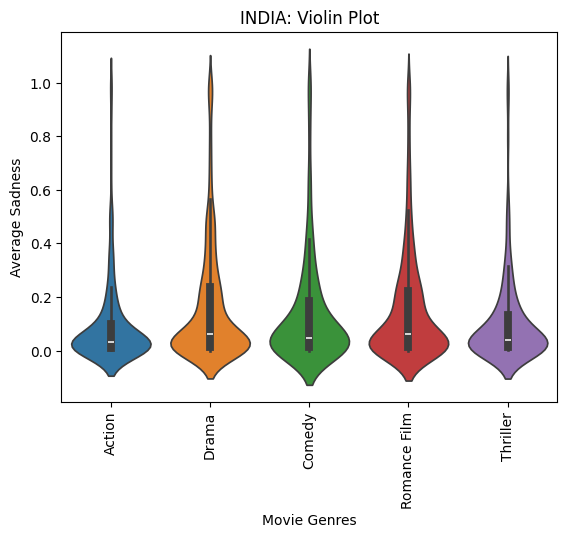

In [94]:
violin(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "sadness", title="INDIA: Violin Plot", xlabel="Movie Genres", ylabel="Average Sadness")

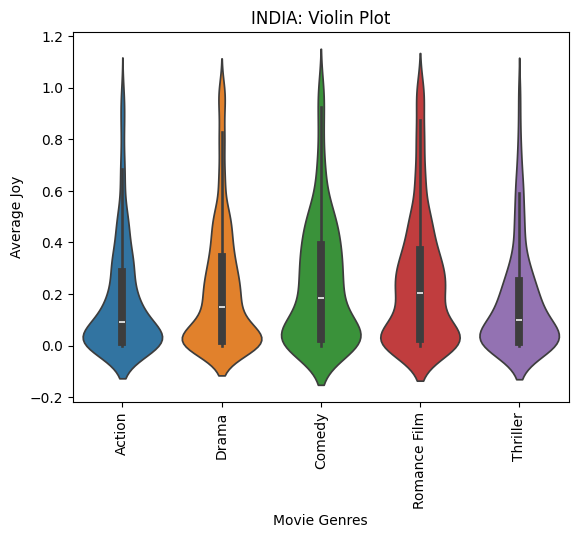

In [95]:
violin(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "joy", title="INDIA: Violin Plot", xlabel="Movie Genres", ylabel="Average Joy")

In [96]:
violin_html(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "joy", labels = "Movie_Genres", title="Joy in Indian Movies", xlabel="Movie Genres", ylabel="Average Joy", filename = "india_joy.html")
violin_html(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "love", labels = "Movie_Genres", title="Love in Indian Movies", xlabel="Movie Genres", ylabel="Average Love", filename = "india_love.html")
violin_html(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "sadness", labels = "Movie_Genres", title="Sadness in Indian Movies", xlabel="Movie Genres", ylabel="Average Sadness", filename = "india_sadness.html")
violin_html(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "anger", labels = "Movie_Genres", title="Anger in Indian Movies", xlabel="Movie Genres", ylabel="Average Anger", filename = "india_anger.html")
violin_html(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "fear", labels = "Movie_Genres", title="Fear in Indian Movies", xlabel="Movie Genres", ylabel="Average Fear", filename = "india_fear.html")
violin_html(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "surprise", labels = "Movie_Genres", title="Surprise in Indian Movies", xlabel="Movie Genres", ylabel="Average Surprise", filename = "india_surprise.html")

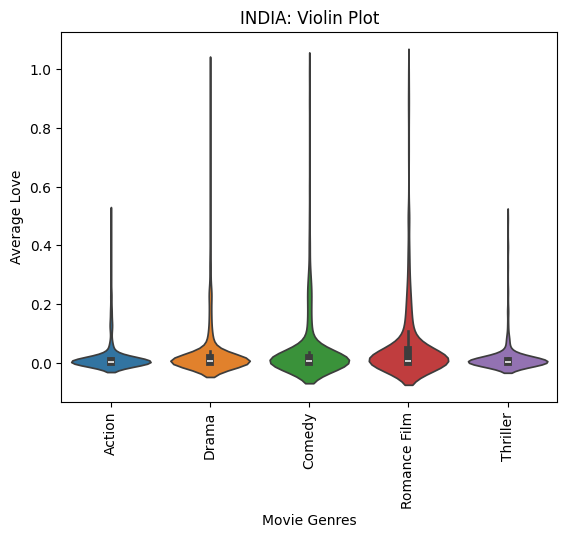

In [97]:
violin(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "love", title="INDIA: Violin Plot", xlabel="Movie Genres", ylabel="Average Love")

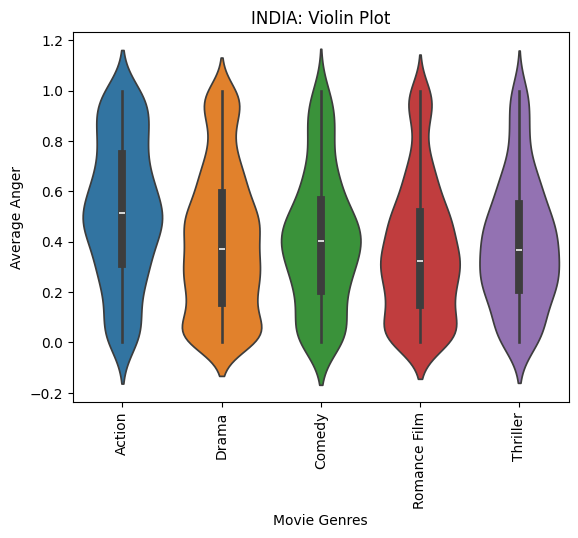

In [98]:
violin(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "anger", title="INDIA: Violin Plot", xlabel="Movie Genres", ylabel="Average Anger")

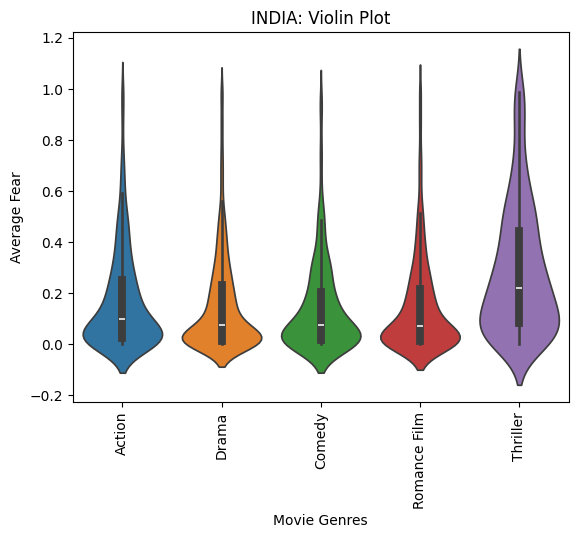

In [99]:
violin(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "fear", title="INDIA: Violin Plot", xlabel="Movie Genres", ylabel="Average Fear")

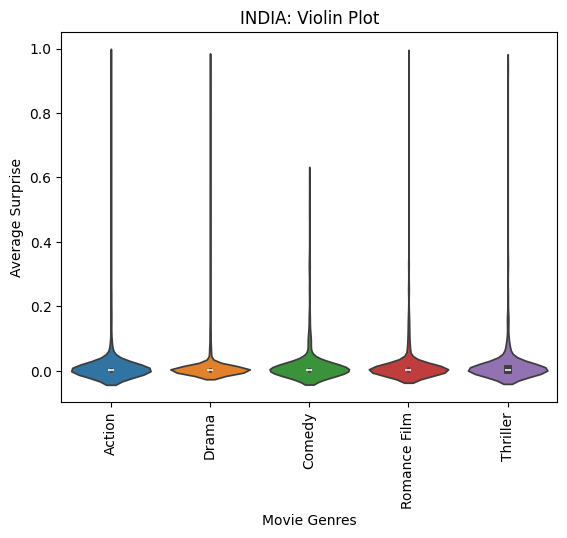

In [100]:
violin(indian_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "surprise", title="INDIA: Violin Plot", xlabel="Movie Genres", ylabel="Average Surprise")

As can be seen from the violin plots above, most of the Indian movies pertaining to all the different genres have negligible sadness while a significant fraction of drama, comedy and romance movies have a moderate level of sadness. Love and Surprise content remained quite negligible for all the different genres of movies and this can be linked to the fact that in general, Indian movies often have a greater content of joy and/or anger and/or fear to build up the entire story and elements of love and surprise are interspersed here and there in between to connect the dots. e.g. *‘Hum Aapke Hain Kon’*. Further, as expected, a substantially larger fraction of comedy movies convey moderately high levels of joy as compared to movies of other genres. Anger remains the highest amongst movies of all the genres with action movies emerging at the top of the ‘anger’ leaderboard. A substantially larger fraction of thriller movies convey moderately high levels of fear as compared to movies of other genres. This is because such movies typically build up the suspense by creating an atmosphere of fear. *‘Dhoom’* and *‘Don’* are two good examples.

Let's now analyse the time series of emotions and music features in Indian movies!

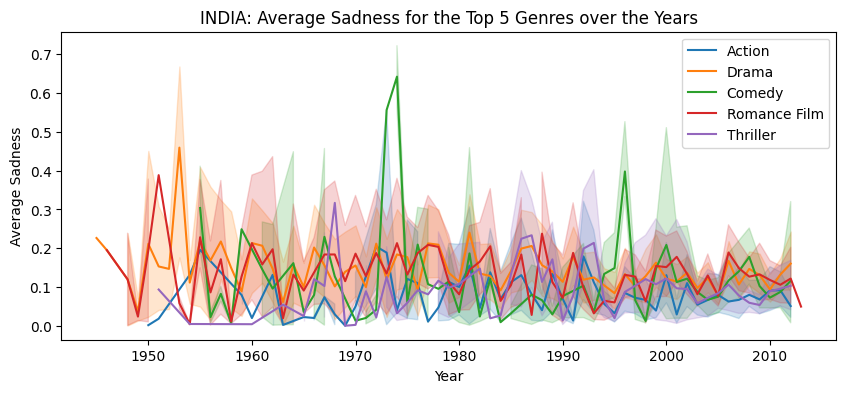

In [101]:
plt.figure(figsize = (10,4)) 
sadness_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="sadness", hue="Movie_Genres", title=f"INDIA: Average Sadness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Sadness", remove_outliers=True)

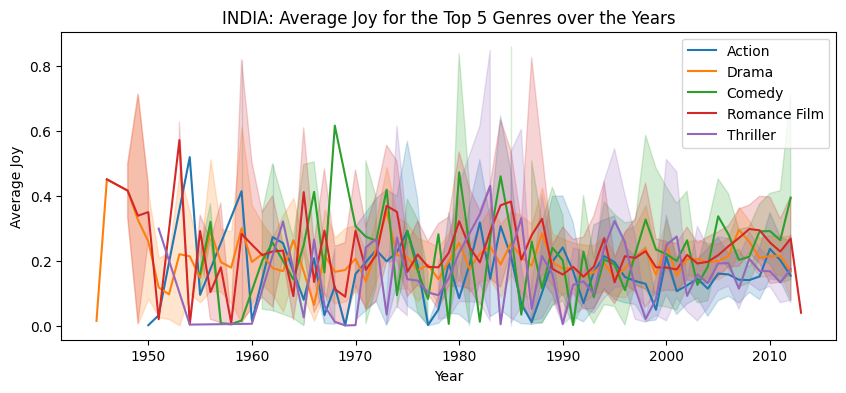

In [102]:
plt.figure(figsize = (10,4)) 
joy_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="joy", hue="Movie_Genres", title=f"INDIA: Average Joy for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Joy", remove_outliers=True)

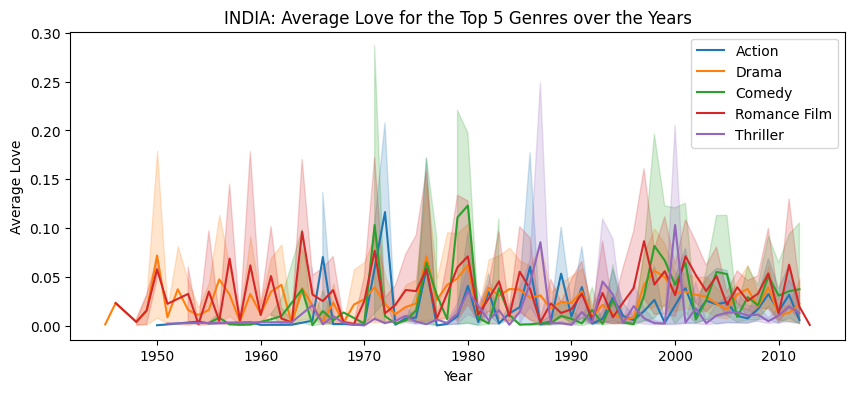

In [103]:
plt.figure(figsize = (10,4)) 
love_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="love", hue="Movie_Genres", title=f"INDIA: Average Love for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Love", remove_outliers=True)

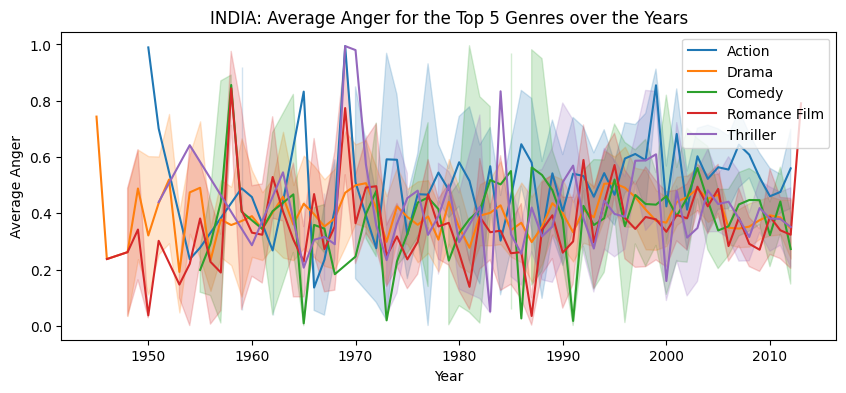

In [104]:
plt.figure(figsize = (10,4)) 
anger_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="anger", hue="Movie_Genres", title=f"INDIA: Average Anger for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Anger", remove_outliers=True)

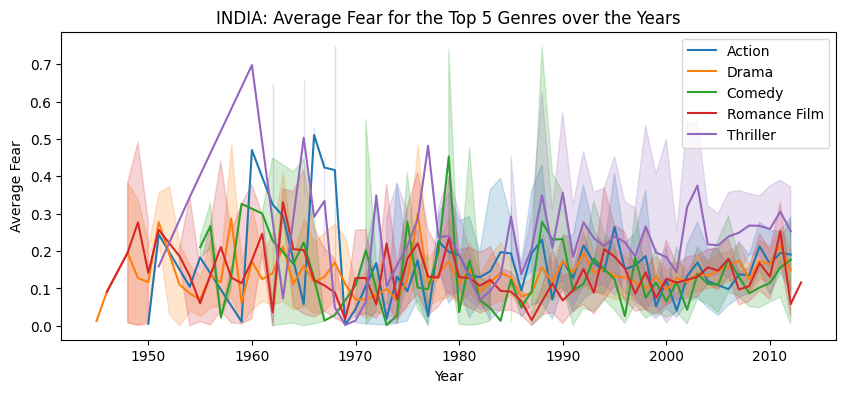

In [105]:
plt.figure(figsize = (10,4)) 
fear_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="fear", hue="Movie_Genres", title=f"INDIA: Average Fear for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Fear", remove_outliers=True)

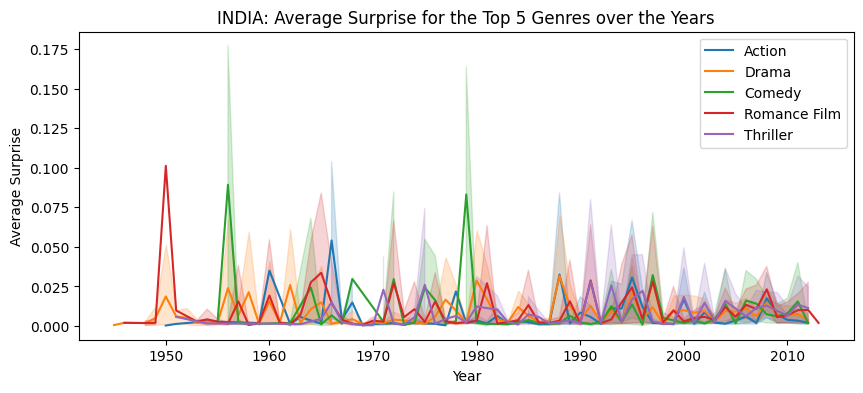

In [106]:
plt.figure(figsize = (10,4)) 
surprise_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="surprise", hue="Movie_Genres", title=f"INDIA: Average Surprise for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Surprise", remove_outliers=True)

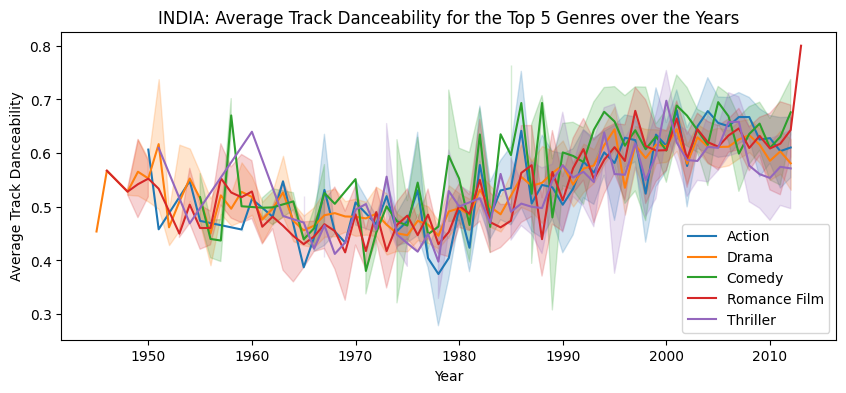

In [107]:
plt.figure(figsize = (10,4)) 
danceability_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Danceability", hue="Movie_Genres", title=f"INDIA: Average Track Danceability for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Danceability", remove_outliers=True)

<Axes: title={'center': 'INDIA: Average Track Acousticness for the Top 5 Movie Genres over the Years'}, xlabel='Year', ylabel='Average Track Acousticness'>

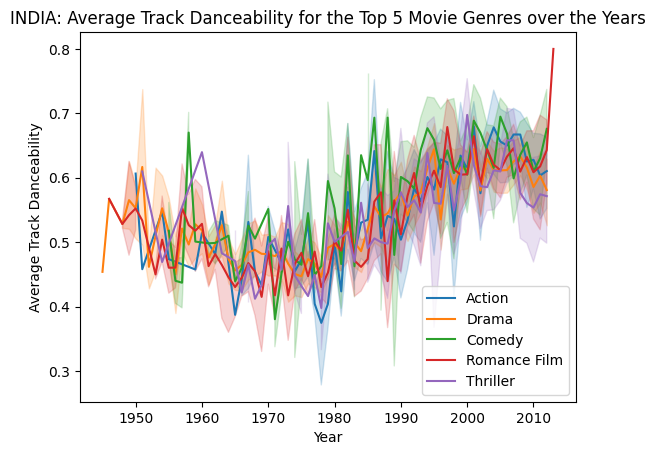

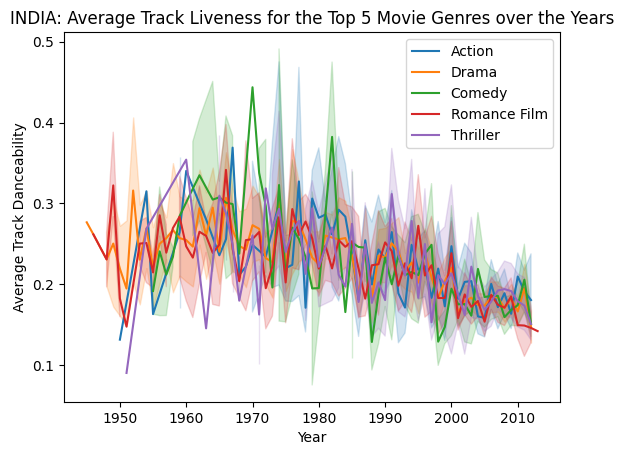

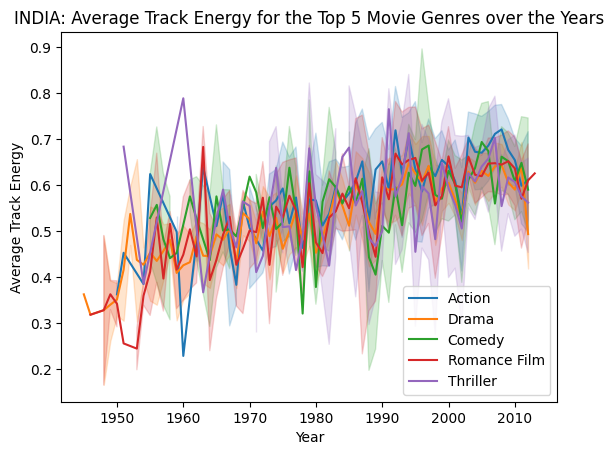

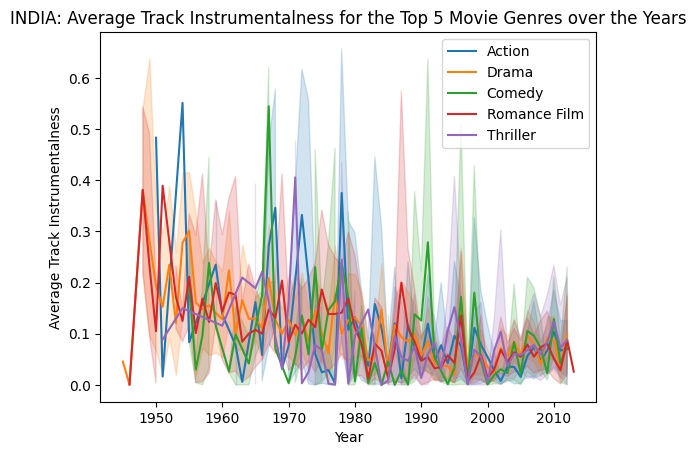

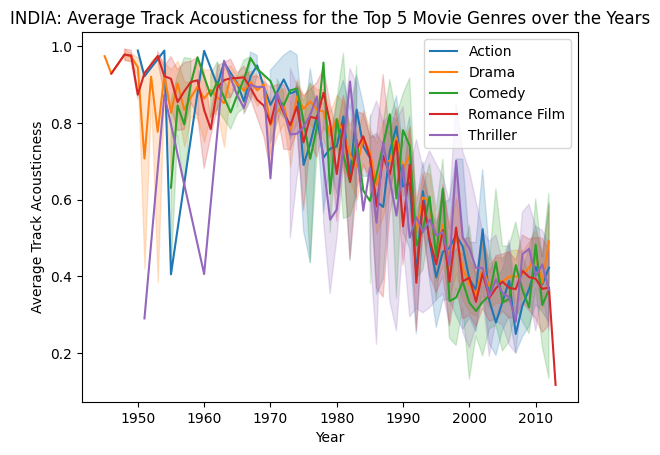

In [108]:
line_html(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Danceability", hue="Movie_Genres", title=f"INDIA: Average Track Danceability for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Danceability", remove_outliers=True, filename = "india_danceability.html")
line_html(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Liveness", hue="Movie_Genres", title=f"INDIA: Average Track Liveness for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Danceability", remove_outliers=True, filename = "india_liveness.html")
line_html(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Energy", hue="Movie_Genres", title=f"INDIA: Average Track Energy for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Energy", remove_outliers=True, filename = "india_energy.html")
line_html(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Instrumentalness", hue="Movie_Genres", title=f"INDIA: Average Track Instrumentalness for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Instrumentalness", remove_outliers=True, filename = "india_instrumentalness.html")
line_html(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Acousticness", hue="Movie_Genres", title=f"INDIA: Average Track Acousticness for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Acousticness", remove_outliers=True, filename = "india_acousticness.html")

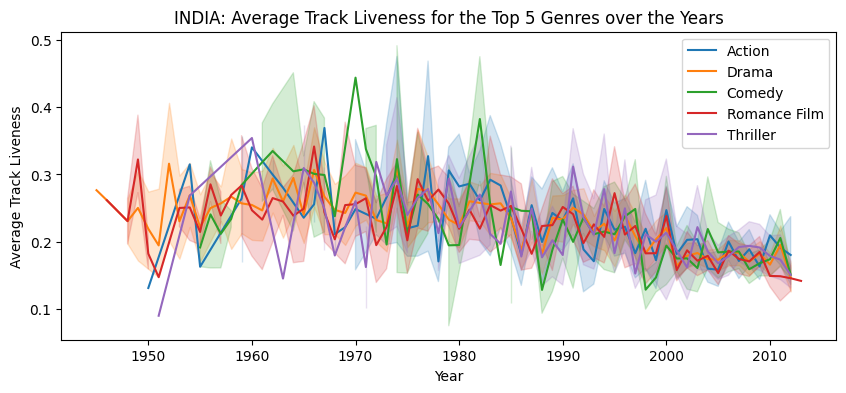

In [109]:
plt.figure(figsize = (10,4)) 
liveness_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Liveness", hue="Movie_Genres", title=f"INDIA: Average Track Liveness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Liveness", remove_outliers=True)

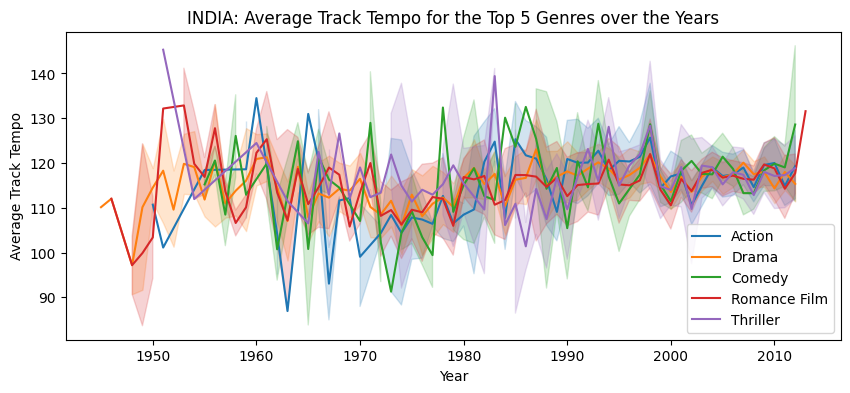

In [110]:
plt.figure(figsize = (10,4)) 
tempo_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Tempo", hue="Movie_Genres", title=f"INDIA: Average Track Tempo for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Tempo", remove_outliers=True)

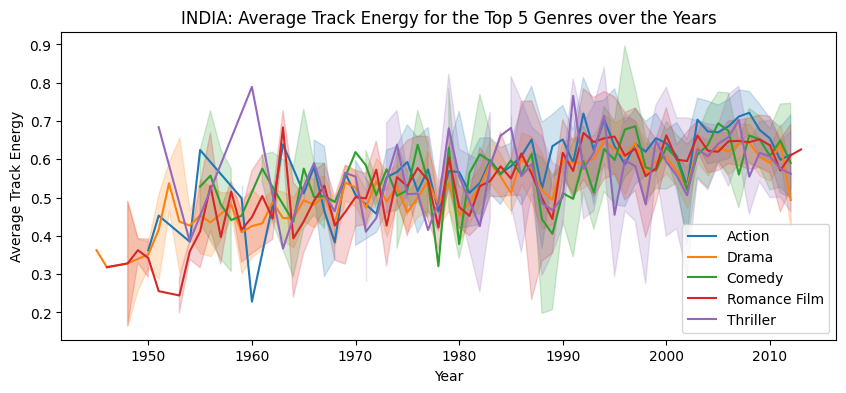

In [111]:
plt.figure(figsize = (10,4)) 
energy_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Energy", hue="Movie_Genres", title=f"INDIA: Average Track Energy for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Energy", remove_outliers=True)

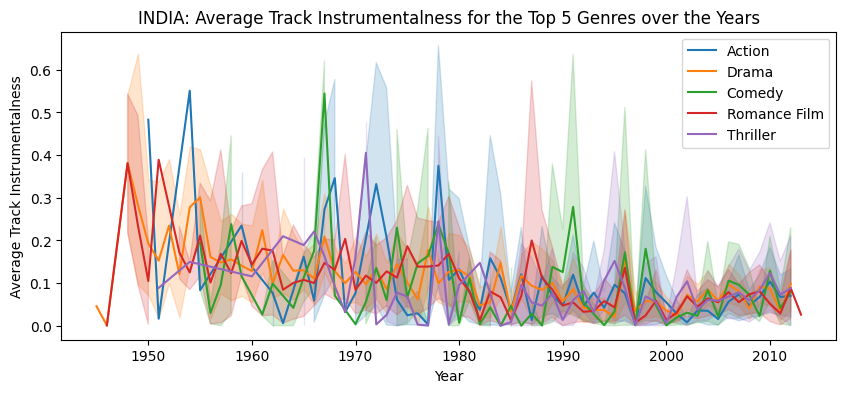

In [112]:
plt.figure(figsize = (10,4)) 
instrumentalness_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Instrumentalness", hue="Movie_Genres", title=f"INDIA: Average Track Instrumentalness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Instrumentalness", remove_outliers=True)

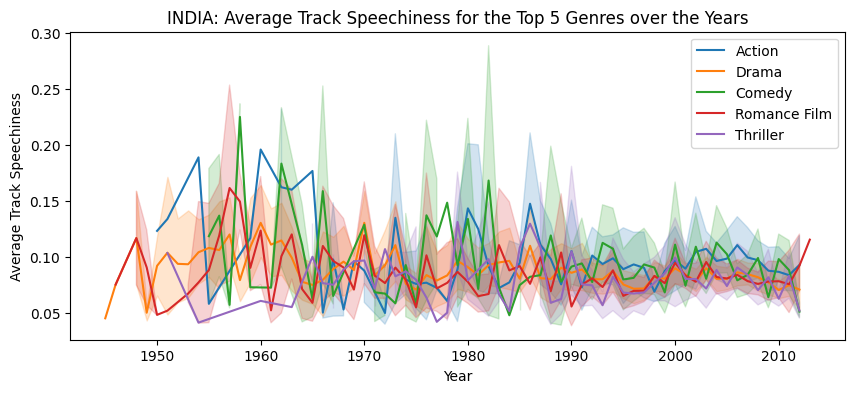

In [113]:
plt.figure(figsize = (10,4)) 
speechiness_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Speechiness", hue="Movie_Genres", title=f"INDIA: Average Track Speechiness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Speechiness", remove_outliers=True)

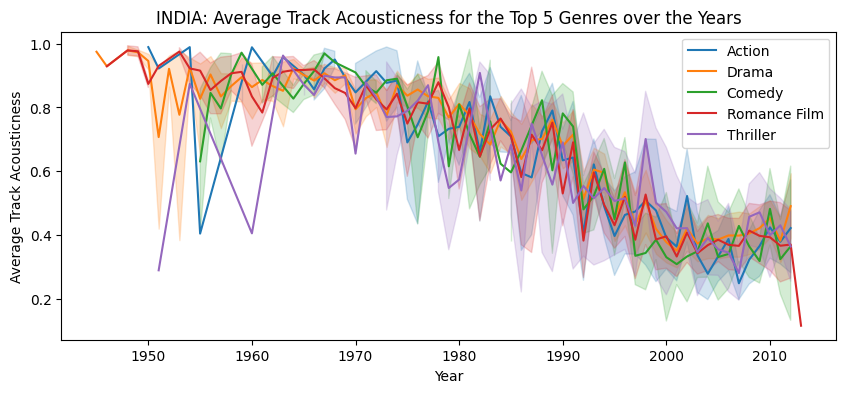

In [114]:
plt.figure(figsize = (10,4)) 
acousticness_and_years_india = line(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Acousticness", hue="Movie_Genres", title=f"INDIA: Average Track Acousticness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Acousticness", remove_outliers=True)

A particular trend emerges quite clearly from the line plots of the movies pertaining to all the genres. The period of time from the 50s to the 80s is popularly referred to as the golden era of Indian film music. India had just become an independent nation in 1945 and so, Indian cinema was heavily influenced by patriotic fervor and centered on exhibiting the cultural ethos of India. Singers like *Lata Mangeshkar* and *Kishore Kumar* won the hearts of many people and sang remarkable songs that touch people’s hearts even today since they captured the essence of Indian culture, traditions and heritage. Classical and folk music (ragas, tanas, etc.) accompanied with classical instruments such as tabla, sitar, dholak, etc. was deeply intertwined with the issues (societal, historical, political, etc.) portrayed by the movies. This was the pre-digital age and music directors would spend hours on end with lyricists, singers, instrumentalists for each and every song in a film to ensure perfect coordination between them and craft a melodious masterpiece. The focus was more on completely immersing the people into the movie so that they could be one with the actors and experience everything which the actors would feel. Consequently, the liveness, energy, instrumentalness and acousticness in the music was high during this period. In contrast, the danceability in the music decreased during this period. Songs like *'Mein Pal Do Pal Ka Shayar Hoon’* and *‘Kabhi Kabhi Mere Dil Mein Khayal Aata Hai’* are two golden examples of this! This was in particular because of the fact that singers were more concerned about making people understand and feel the content of their songs rather than making them simply dance to the beats without any understanding of the lyrics at all. 

However, the period from the 80s-90s onwards saw a marked shift in this trend. Danceability suddenly started to pickup again and has only continued to increase ever since. At the same time, while the energy content of the music increased, liveness, instrumentals and acoustics of the music only decreased. This dramatic shift can be directly attributed to globalization: the time when India opened its doors to the world and consequently, got influenced by the Western music and film culture. New Indian singers (e.g., *Alisha Chinai*) started singing songs which were fusions of Indian and Western music with groovy beats and the Indian masses started dancing to their tunes. The focus of the film industry shifted increasingly towards the Western pop music culture, and this led to the birth of Indian pop music which was centered on high danceability more than anything else. Over the years from 1990s till date, Indian music has followed a growth trajectory guided by danceability. Lyrics and classical instruments which were hallmarks of Indian music during the golden era are gradually fading away with music being digitized and revolving around the western focal point of high danceability. Bollywood in India is increasingly becoming more focused on the western philosophy of only the ‘moolah’ rules, rather than imparting its holistic and immersive experience to people to enrich their understanding. 

As Acton rightly said, *“History is not a burden on the memory but an illumination of the soul”*. The Indian movie industry must introspect and harness its true strengths: the commitment and vitality of the past, which make India a truly unique country and set it apart from others!

#### Cointegration Tests
<a id="15"></a>

Let's now turn over to analysing the long term relationship between the time series of emotions and music features of Indian movies for the top 5 genres by determining whether they are cointegrated or not. 

Cointegration basically refers to the long-term relationship between 2/more time series that are non-stationary but their linear combination results in a stationary time series, i.e., a time series with an integration of order 0 (I(0)). It basically determines whether the 2 time series share an underlying common trend. 

We use the augmented Engle-Granger two-step cointegration test for determining the presence of a cointegration between the time series of emotions and music. A constant (trend) is included in the 1st stage of the test, i.e., in the cointegrating equation (linear combination). The null hypothesis is of no cointegration between the 2 time series while the alternative hypothesis is that they are cointegrated, i.e., their linear combination is I(1). A p-value less than 0.05 thus allows us to reject the null hypothesis of no cointegration.

In [115]:
def run_emotion_music_cointegration_tests(emotions_and_years_country_net, music_and_years_country_net, emotions_net, music_net, genre_net):
    
    """
    Runs the cointegration test(s) for determining whether/not the emotion(s) and music feature(s) time series (for a particular country and for a particular set of genres) are cointegrated
    
    Arguments:
        emotions_and_years_country_net = (List) List of time series data (extracted from line plots) for emotion(s) across the years (for a particular country and for a particular set of genres)
        music_and_years_country_net = (List) List of time series data (extracted from line plots) for music feature(s) across the years (for a particular country and for a particular set of genres)
        emotions_net = (List) List of emotions (strings) for which we have the time series data in emotions_and_years_country_net
        music_net = (List) List of music features (strings) for which we have the time series data in music_and_years_country_net
        genre_net = (List) List of genres (strings) for which we have the time series data in emotions_and_years_country_net and music_and_years_country_net
        
    Returns:
        coint_test_res_df = (pandas DataFrame) Dataframe containing the results of all the cointegration tests
    """
    
    coint_test_res_net = []
    
    #Define the column names for coint_test_res_df
    coint_test_res_dict_keys = ['Movie Emotion', 'Music Feature', 'Movie Genre', 'p-value', 'Cointegrated']
    
    #Loop over all the time series of the emotion(s)
    for i, emotion_and_years_india in enumerate(emotions_and_years_country_net):
        #Loop over all the time series of the music feature(s)
        for j, music_and_years_india in enumerate(music_and_years_country_net):
            #Loop over all the genre(s)
            for k, genre in enumerate(genre_net):
                
                #Extract the time series for the emotion which corresponds to the given genre
                emotion_lineplot_data = emotion_and_years_india.get_lines()[k]
                emotion_lineplot_y_data = np.array(emotion_lineplot_data.get_ydata())
                emotion_lineplot_x_data = np.array(emotion_lineplot_data.get_xdata())
                
                #Extract the time series for the music feature which corresponds to the given genre
                music_lineplot_data = music_and_years_india.get_lines()[k]
                music_lineplot_y_data = np.array(music_lineplot_data.get_ydata())
                music_lineplot_x_data = np.array(music_lineplot_data.get_xdata())
                
                #Ensure that both the 2 time series (for the emotion and music feature) have the same number of data points
                #If that is not the case, extract the x data (years) and then choose the points which correspond to that x data which are common to both
                if len(emotion_lineplot_y_data) != len(music_lineplot_y_data):
                    chosen_x_data = set(emotion_lineplot_x_data).intersection(set(music_lineplot_x_data))
                    emotion_selected_idx_net = [i for i, ele in enumerate(emotion_lineplot_x_data) if ele in chosen_x_data]
                    music_selected_idx_net = [i for i, ele in enumerate(music_lineplot_x_data) if ele in chosen_x_data]
                    emotion_lineplot_y_data = emotion_lineplot_y_data[emotion_selected_idx_net] 
                    music_lineplot_y_data = music_lineplot_y_data[music_selected_idx_net]
                    
                    
                #Run the cointegration test and store the results in the list
                p_value_coint = coint(emotion_lineplot_y_data, music_lineplot_y_data)[1]
                coint_res = 1 if p_value_coint < 0.05 else 0
                coint_test_res_dict_values = [emotions_net[i], music_net[j], genre_net[k], p_value_coint, coint_res]
                coint_test_res_dict = dict(zip(coint_test_res_dict_keys, coint_test_res_dict_values))
                coint_test_res_net.append(coint_test_res_dict)
            
    #Create the required cointegration results dataframe
    coint_test_res_df = pd.DataFrame(coint_test_res_net)
    coint_test_res_df = coint_test_res_df.set_index(['Movie Emotion', 'Music Feature', 'Movie Genre'])
    
    return coint_test_res_df    

In [116]:
#Not considering love and surprise since they are quite close to zero anyway
emotions_and_years_india_net = [sadness_and_years_india, joy_and_years_india, anger_and_years_india, fear_and_years_india]
music_and_years_india_net = [danceability_and_years_india, liveness_and_years_india, tempo_and_years_india, energy_and_years_india, instrumentalness_and_years_india, speechiness_and_years_india, acousticness_and_years_india]
emotions_net = ['Sadness','Joy','Anger','Fear']
music_net = ['Danceability','Liveness','Tempo','Energy','Instrumentalness','Speechiness','Acousticness']
genre_net = ['Action','Drama','Comedy','Romance Film','Thriller']

#Run the cointegration tests for India
india_coint_test_res_df = run_emotion_music_cointegration_tests(emotions_and_years_india_net, music_and_years_india_net, emotions_net, music_net, genre_net)

#Display the results
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(india_coint_test_res_df)

p-value  Cointegrated
Movie Emotion Music Feature    Movie Genre                             
Sadness       Danceability     Action        2.085927e-07             1
                               Drama         1.595191e-14             1
                               Comedy        2.265888e-05             1
                               Romance Film  2.394433e-14             1
                               Thriller      1.304732e-04             1
              Liveness         Action        1.307716e-06             1
                               Drama         1.726813e-14             1
                               Comedy        2.752520e-06             1
                               Romance Film  9.890691e-13             1
                               Thriller      5.238500e-06             1
              Tempo            Action        4.337111e-10             1
                               Drama         1.866219e-12             1
                               Comedy        1.124131e-09             1
                               Romance Film  5.770581e-13             1
                               Thriller      1.265085e-04             1
              Energy           Action        9.815157e-09             1
                               Drama         5.274065e-07             1
                               Comedy        3.318914e-06             1
                               Romance Film  3.144133e-13             1
                               Thriller      1.742400e-04             1
              Instrumentalness Action        4.102026e-09             1
                               Drama         8.276311e-14             1
                               Comedy        3.874725e-05             1
                               Romance Film  4.203169e-14             1
                               Thriller      9.686473e-05             1
              Speechiness      Action        5.584568e-09             1
                               Drama         6.358818e-14             1
                               Comedy        2.489097e-06             1
                               Romance Film  1.079880e-13             1
                               Thriller      8.885057e-05             1
              Acousticness     Action        9.243982e-09             1
                               Drama         3.060774e-07             1
                               Comedy        2.708907e-06             1
                               Romance Film  6.632020e-14             1
                               Thriller      1.215950e-04             1
Joy           Danceability     Action        1.543563e-04             1
                               Drama         4.011563e-09             1
                               Comedy        5.623367e-09             1
                               Romance Film  4.882010e-15             1
                               Thriller      2.317420e-09             1
              Liveness         Action        1.713087e-02             1
                               Drama         8.254431e-10             1
                               Comedy        1.236283e-08             1
                               Romance Film  3.040992e-15             1
                               Thriller      2.310924e-08             1
              Tempo            Action        8.315223e-05             1
                               Drama         5.067142e-09             1
                               Comedy        4.083941e-09             1
                               Romance Film  8.140410e-16             1
                               Thriller      3.433354e-08             1
              Energy           Action        1.526645e-04             1
                               Drama         1.361485e-06             1
                               Comedy        1.510852e-09             1
                               Romance Film  1.190778e-15             1
                  

In [117]:
#Display the details of the time series which were found out to be non-cointegrated
no_res_india_coint_test_res_df = india_coint_test_res_df[india_coint_test_res_df['Cointegrated'] == 0]
display(no_res_india_coint_test_res_df)

,,,p-value,Cointegrated
Movie Emotion,Music Feature,Movie Genre,,
Anger,Tempo,Comedy,0.118109,0
Fear,Tempo,Romance Film,0.050559,0


The fact that all (except 2) of the emotion and music feature time series are cointegrated for India reveals the fact that over the years, music, which even today forms an integral part of all Indian movies, effectively captures the emotions over the years through an interplay of its various features. 

Since we found out that all except only the above 2 time series sets are non-cointegrated with one another, we think that this might due to the lack of movies representative of such music features in our dataset and it's possible that with a more represnetative dataset, even these 2 time series might be sharing long term relationships with one another.

### USA: Emotions and Music
<a id="16"></a>

In [118]:
#Extract the movies for America
american_movie_metadata_with_music_and_emotions_data_by_genre = country_wise_movie_metadata_with_music_and_emotions_data_by_genre[country_wise_movie_metadata_with_music_and_emotions_data_by_genre['Movie_Countries'] == 'United States of America']
display(american_movie_metadata_with_music_and_emotions_data_by_genre)

,level_0,index,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,...,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,sadness,joy,love,anger,fear,surprise
1,6,1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],United States of America,Comedy,...,-19.369667,0.218728,107.623778,0.480222,0.150088,0.192072,0.005774,0.599208,0.049823,0.003036
2,7,1,77856,Mary Poppins,1964-08-27,102272727.0,139.0,[English Language],United States of America,Drama,...,-19.369667,0.218728,107.623778,0.480222,0.150088,0.192072,0.005774,0.599208,0.049823,0.003036
8,20,6,2647998,The Human Tornado,1976-01-01,NaN,86.0,[English Language],United States of America,Comedy,...,-10.077564,0.137779,99.256385,0.552415,0.005103,0.016408,0.001045,0.587462,0.388473,0.001509
9,21,6,2647998,The Human Tornado,1976-01-01,NaN,86.0,[English Language],United States of America,Action,...,-10.077564,0.137779,99.256385,0.552415,0.005103,0.016408,0.001045,0.587462,0.388473,0.001509
10,24,8,5894429,Closing the Ring,2007-09-14,NaN,117.0,[English Language],United States of America,Romance Film,...,-19.416316,0.040616,107.246053,0.061921,0.173575,0.185412,0.221598,0.027536,0.363047,0.028831
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15638,34447,8960,9271903,Trois,2000-01-01,NaN,93.0,[English Language],United States of America,Thriller,...,-22.939360,0.052490,91.761240,0.111196,0.066576,0.007198,0.308743,0.343299,0.271745,0.002438
15639,34449,8960,9271903,Trois,2000-01-01,NaN,93.0,[English Language],United States of America,Romance Film,...,-22.939360,0.052490,91.761240,0.111196,0.066576,0.007198,0.308743,0.343299,0.271745,0.002438
15641,34454,8962,25920477,Source Code,2011-03-11,147332697.0,93.0,[English Language],United States of America,Thriller,...,-25.713667,0.038100,124.033000,0.052833,0.048861,0.285868,0.003650,0.313911,0.293520,0.054191
15643,34458,8962,25920477,Source Code,2011-03-11,147332697.0,93.0,[English Language],United States of America,Drama,...,-25.713667,0.038100,124.033000,0.052833,0.048861,0.285868,0.003650,0.313911,0.293520,0.054191


In [119]:
violin_html(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "sadness", labels = "Movie_Genres", title="Sadness in American Movies", xlabel="Movie Genres", ylabel="Average Sadness", filename = "usa_sadness.html")
violin_html(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "joy", labels = "Movie_Genres", title="Joy in American Movies", xlabel="Movie Genres", ylabel="Average Joy", filename = "usa_joy.html")
violin_html(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "love", labels = "Movie_Genres", title="Love in American Movies", xlabel="Movie Genres", ylabel="Average Love", filename = "usa_love.html")
violin_html(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "anger", labels = "Movie_Genres", title="Anger in American Movies", xlabel="Movie Genres", ylabel="Average Anger", filename = "usa_anger.html")
violin_html(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "fear", labels = "Movie_Genres", title="Fear in American Movies", xlabel="Movie Genres", ylabel="Average Fear", filename = "usa_fear.html")
violin_html(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "surprise", labels = "Movie_Genres", title="Surprise in American Movies", xlabel="Movie Genres", ylabel="Average Surprise", filename = "usa_surprise.html")

Now, let us turn over to analysing the distribution of movies which portray different emotions via violin plots!

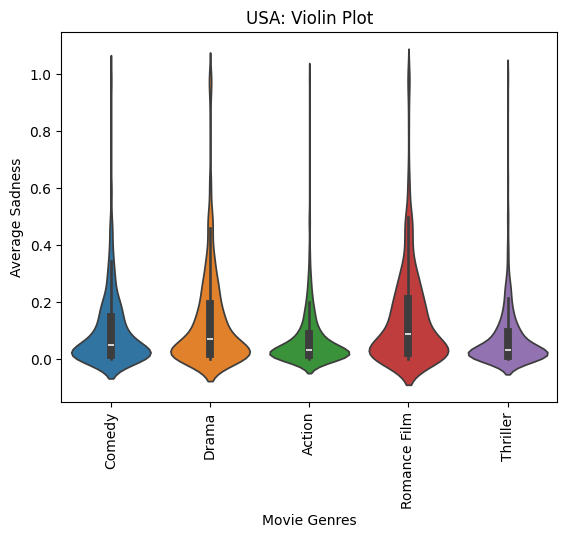

In [120]:
violin(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "sadness", title="USA: Violin Plot", xlabel="Movie Genres", ylabel="Average Sadness")

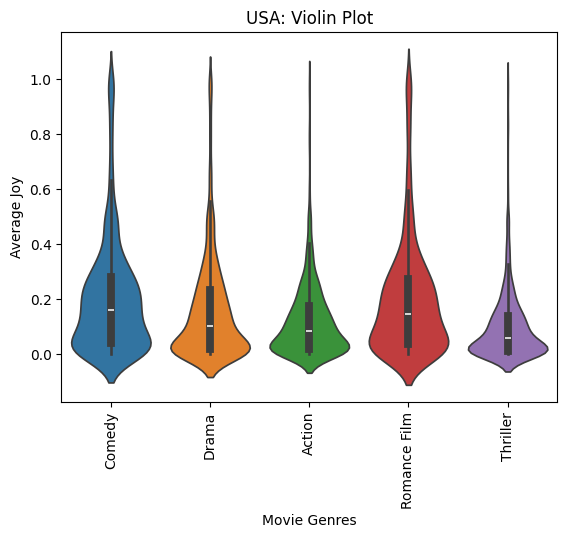

In [121]:
violin(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "joy", title="USA: Violin Plot", xlabel="Movie Genres", ylabel="Average Joy")

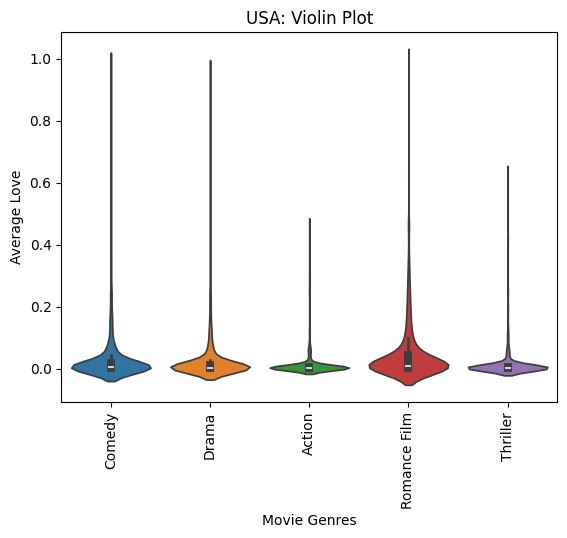

In [122]:
violin(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "love", title="USA: Violin Plot", xlabel="Movie Genres", ylabel="Average Love")

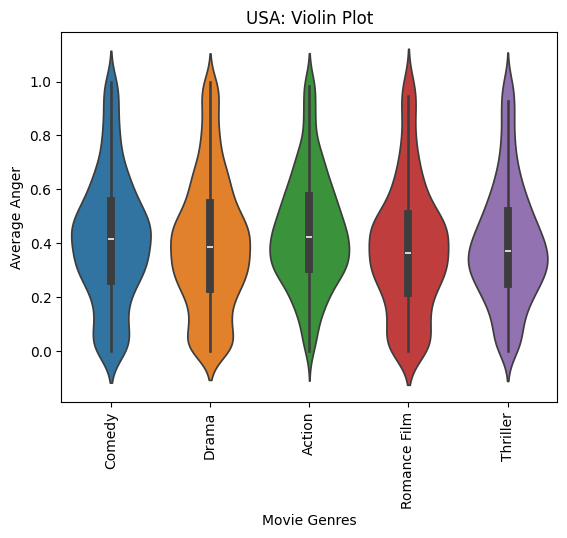

In [123]:
violin(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "anger", title="USA: Violin Plot", xlabel="Movie Genres", ylabel="Average Anger")

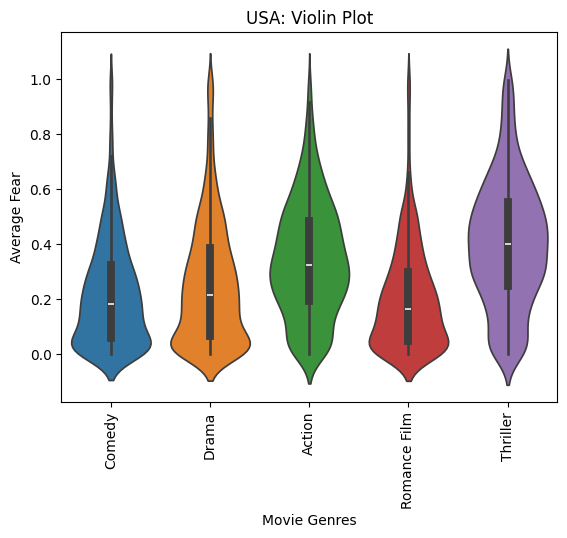

In [124]:
violin(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "fear", title="USA: Violin Plot", xlabel="Movie Genres", ylabel="Average Fear")

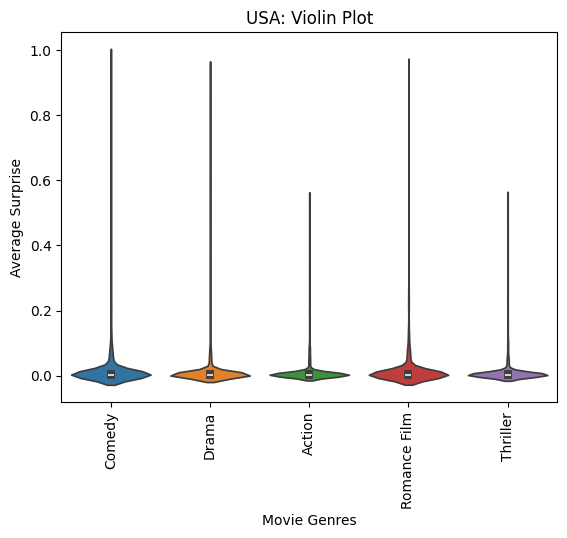

In [125]:
violin(american_movie_metadata_with_music_and_emotions_data_by_genre, "Movie_Genres", "surprise", title="USA: Violin Plot", xlabel="Movie Genres", ylabel="Average Surprise")

On looking at the violin plots above, we observe a higher fraction of sadness in romance, drama and comedy genres. This could be attributed to the genres’ focus on more emotional depth than action and thriller genres which tend to instead prioritise excitement and suspense. Then, as expected, joy is present in a greater number of comedy and romance movies due to the genres’ emphasis on humour and positive relationships as compared to the other three genres: action, thriller and drama. Love and surprise are again only present for a very small fraction for all movies across all the genres because these genres often emphasise other emotions (as was the case for India). Still, a fraction of the romance movies have a higher love content than what is present in movies of other genres which could be due to the relationship and emotional intimacy of love in this movie genre. Anger is notably higher and uniformly distributed across genres. Finally, fear is also well present in all these genres with the higher fraction found in thriller movies followed by action movies, indicating their emphasis on suspenseful and more intense storytelling.

Let us now turn to analyse the lineplots of emotions and music!

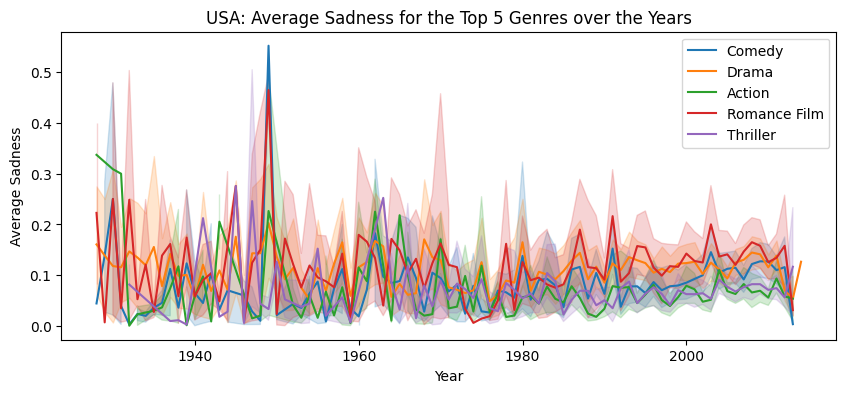

In [126]:
plt.figure(figsize = (10,4)) 
sadness_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="sadness", hue="Movie_Genres", title=f"USA: Average Sadness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Sadness", remove_outliers=True)

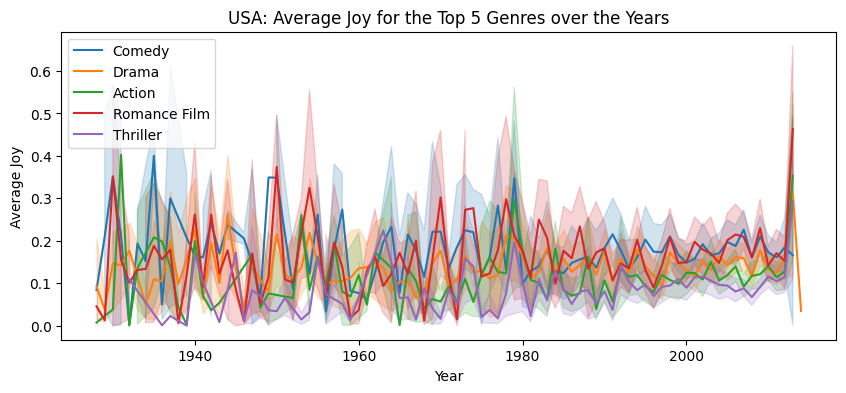

In [127]:
plt.figure(figsize = (10,4)) 
joy_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="joy", hue="Movie_Genres", title=f"USA: Average Joy for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Joy", remove_outliers=True)

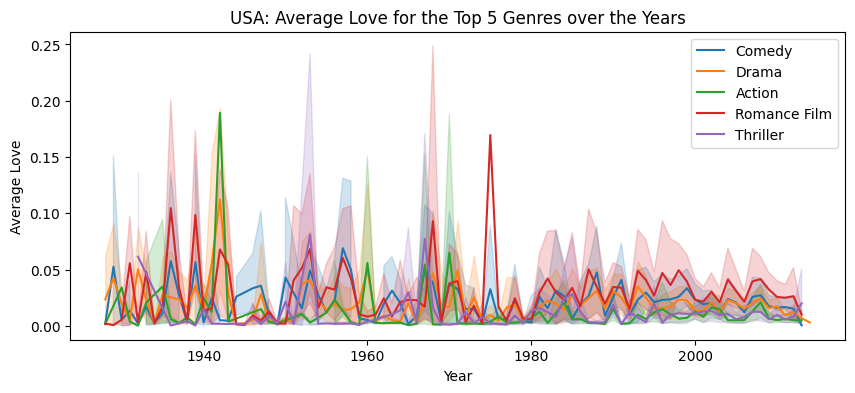

In [128]:
plt.figure(figsize = (10,4)) 
love_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="love", hue="Movie_Genres", title=f"USA: Average Love for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Love", remove_outliers=True)

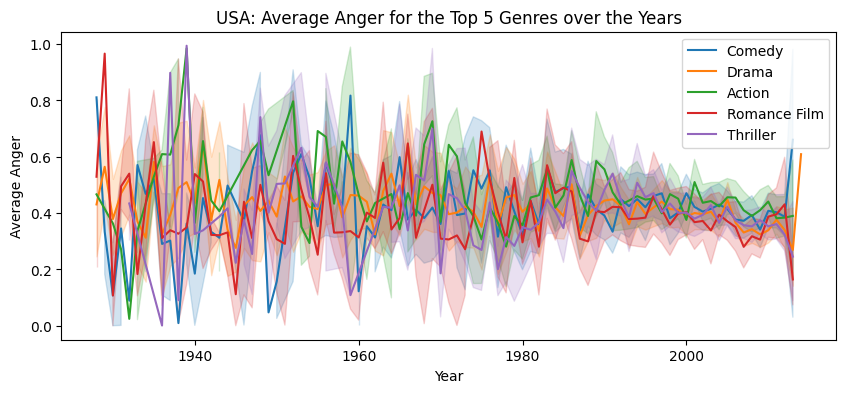

In [129]:
plt.figure(figsize = (10,4)) 
anger_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="anger", hue="Movie_Genres", title=f"USA: Average Anger for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Anger", remove_outliers=True)

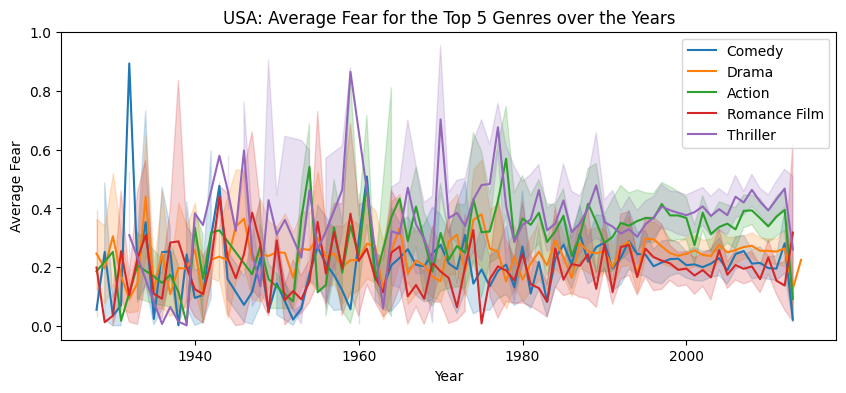

In [130]:
plt.figure(figsize = (10,4)) 
fear_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="fear", hue="Movie_Genres", title=f"USA: Average Fear for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Fear", remove_outliers=True)

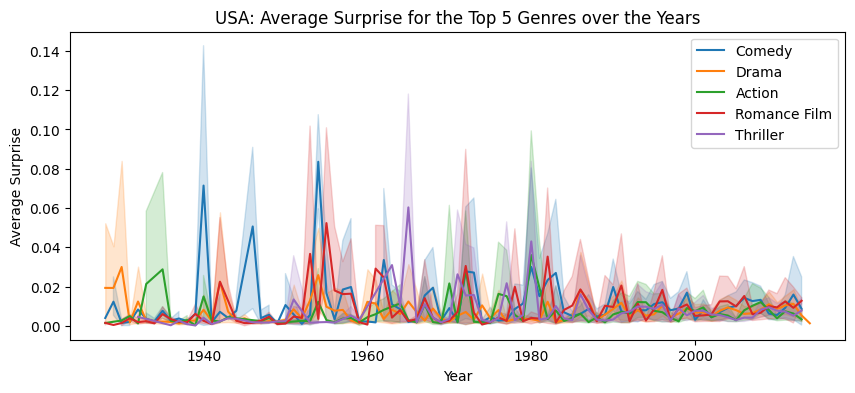

In [131]:
plt.figure(figsize = (10,4)) 
surprise_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="surprise", hue="Movie_Genres", title=f"USA: Average Surprise for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Surprise", remove_outliers=True)

<Axes: title={'center': 'INDIA: Average Track Liveness for the Top 5 Movie Genres over the Years'}, xlabel='Year', ylabel='Average Track Liveness'>

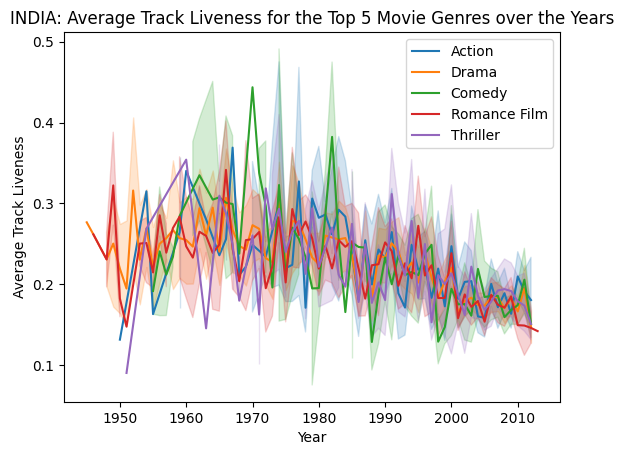

In [132]:
line_html(data=indian_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Liveness", hue="Movie_Genres", title=f"INDIA: Average Track Liveness for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Liveness", remove_outliers=True, filename = "india_liveness.html")

<Axes: title={'center': 'USA: Average Track Acousticness for the Top 5 Movie Genres over the Years'}, xlabel='Year', ylabel='Average Track Acousticness'>

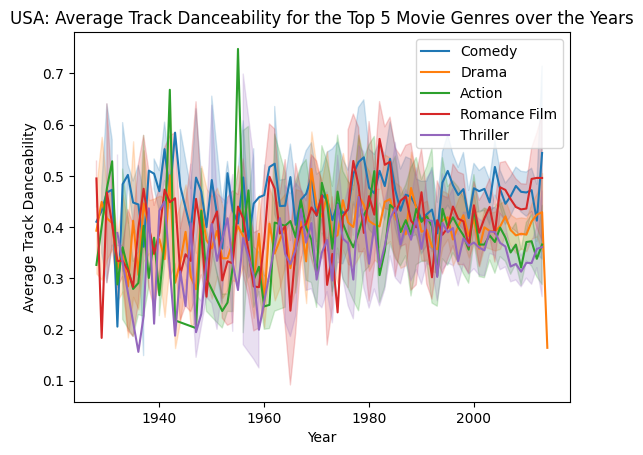

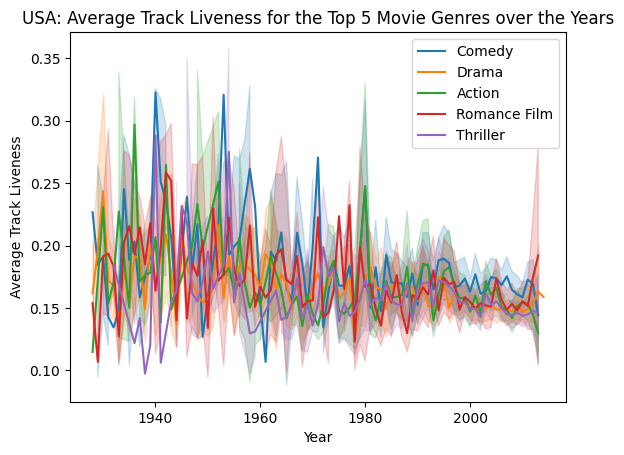

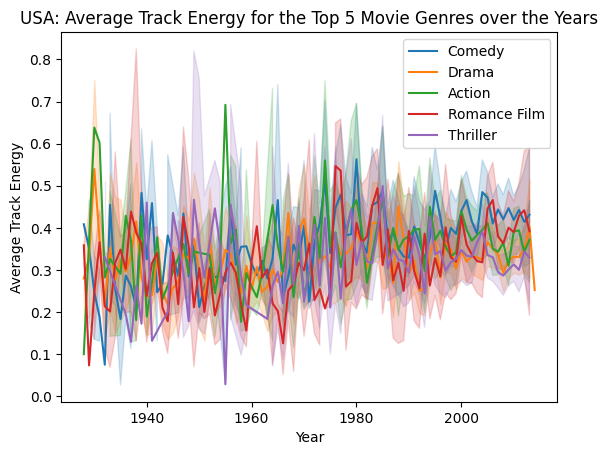

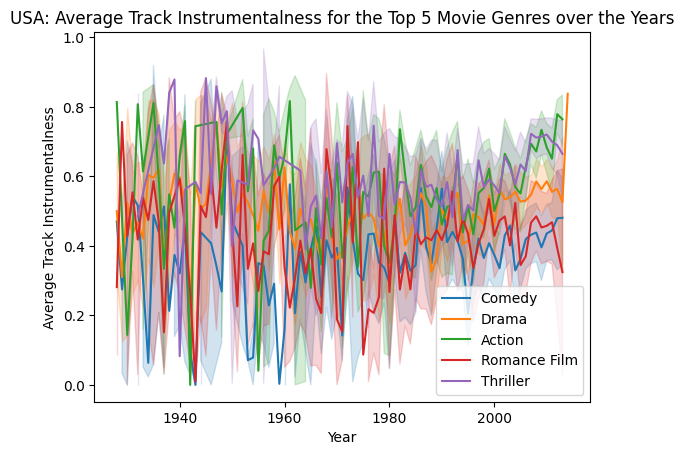

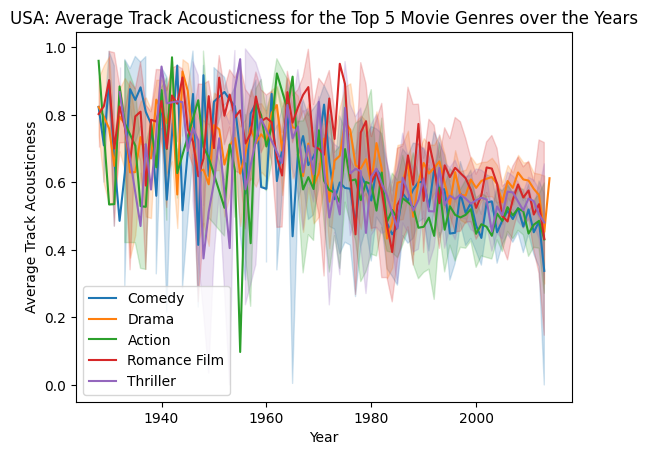

In [133]:
line_html(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Danceability", hue="Movie_Genres", title=f"USA: Average Track Danceability for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Danceability", remove_outliers=True, filename = "usa_danceability.html")
line_html(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Liveness", hue="Movie_Genres", title=f"USA: Average Track Liveness for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Liveness", remove_outliers=True, filename = "usa_liveness.html")
line_html(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Energy", hue="Movie_Genres", title=f"USA: Average Track Energy for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Energy", remove_outliers=True, filename = "usa_energy.html")
line_html(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Instrumentalness", hue="Movie_Genres", title=f"USA: Average Track Instrumentalness for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Instrumentalness", remove_outliers=True, filename = "usa_instrumentalness.html")
line_html(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Acousticness", hue="Movie_Genres", title=f"USA: Average Track Acousticness for the Top 5 Movie Genres over the Years", xlabel="Year", ylabel="Average Track Acousticness", remove_outliers=True, filename = "usa_acousticness.html")

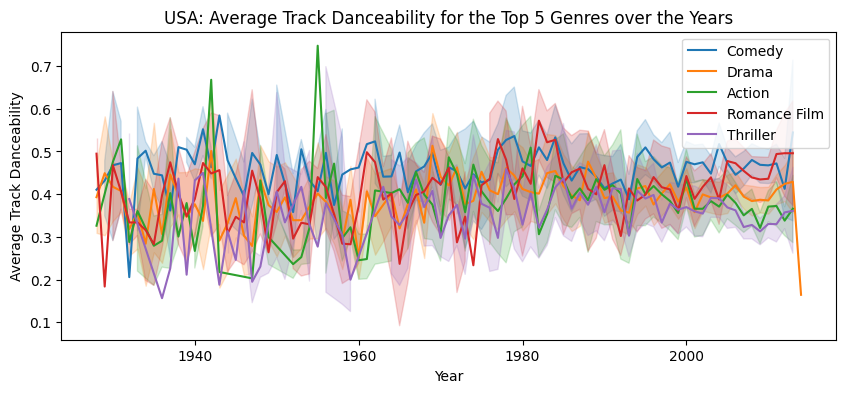

In [134]:
plt.figure(figsize = (10,4)) 
danceability_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Danceability", hue="Movie_Genres", title=f"USA: Average Track Danceability for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Danceability", remove_outliers=True)

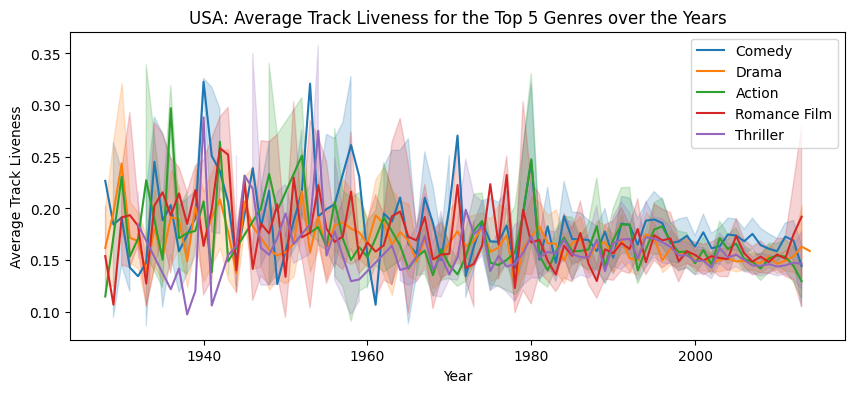

In [135]:
plt.figure(figsize = (10,4)) 
liveness_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Liveness", hue="Movie_Genres", title=f"USA: Average Track Liveness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Liveness", remove_outliers=True)

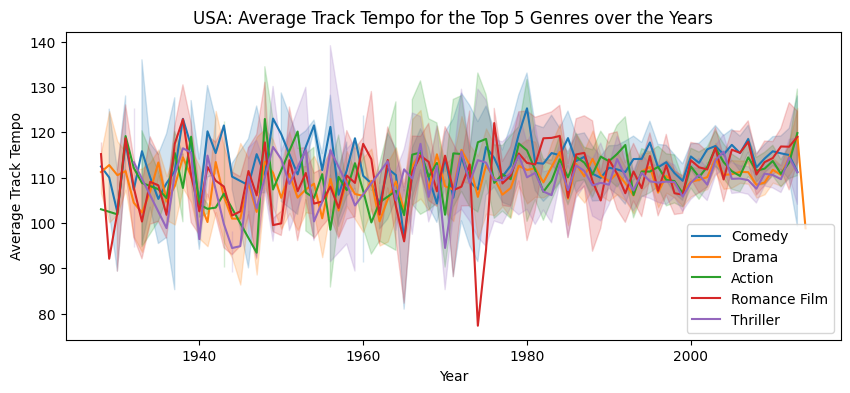

In [136]:
plt.figure(figsize = (10,4)) 
tempo_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Tempo", hue="Movie_Genres", title=f"USA: Average Track Tempo for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Tempo", remove_outliers=True)

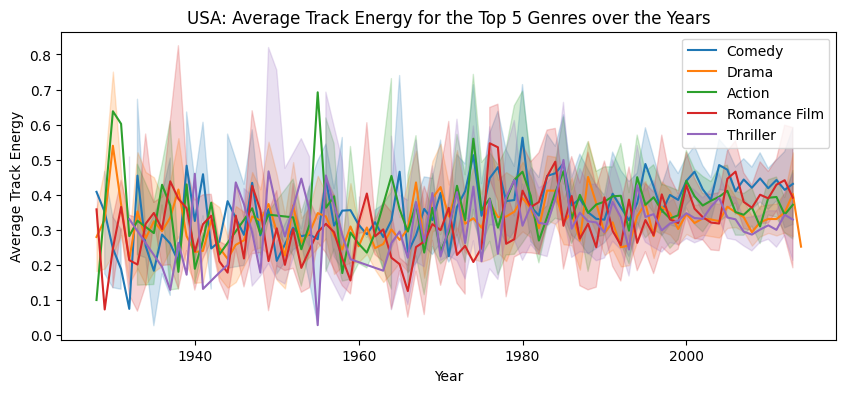

In [137]:
plt.figure(figsize = (10,4)) 
energy_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Energy", hue="Movie_Genres", title=f"USA: Average Track Energy for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Energy", remove_outliers=True)

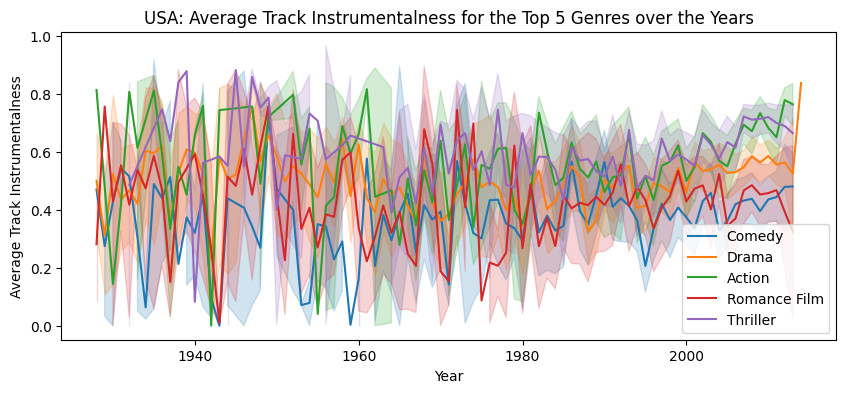

In [138]:
plt.figure(figsize = (10,4)) 
instrumentalness_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Instrumentalness", hue="Movie_Genres", title=f"USA: Average Track Instrumentalness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Instrumentalness", remove_outliers=True)

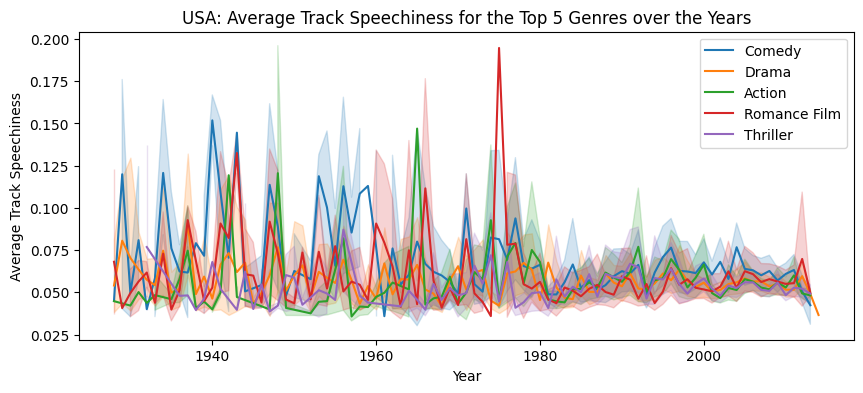

In [139]:
plt.figure(figsize = (10,4)) 
speechiness_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Speechiness", hue="Movie_Genres", title=f"USA: Average Track Speechiness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Speechiness", remove_outliers=True)

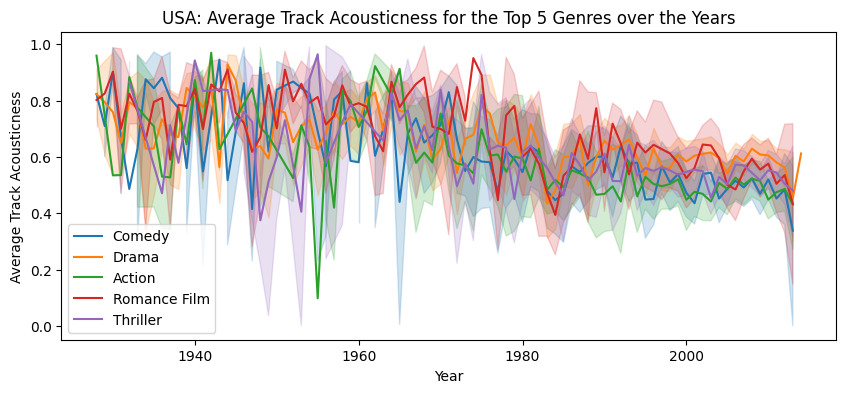

In [140]:
plt.figure(figsize = (10,4)) 
acousticness_and_years_america = line(data=american_movie_metadata_with_music_and_emotions_data_by_genre, x="Movie_Release_Year", y="Track_Acousticness", hue="Movie_Genres", title=f"USA: Average Track Acousticness for the Top 5 Genres over the Years", xlabel="Year", ylabel="Average Track Acousticness", remove_outliers=True)

The time series for US movies exhibit distinctive trends in musical attributes across genres, yet notably, these remain less pronounced than the trends which we could observe in Indian movies. The most perceptible trend is the decay of acousticness across genres since 1970 which could have arisen due to the new era of digital and electronic movie production methods. Furthermore, since 1980, converging speechiness trends suggest a shared emphasis on intelligible and explicit lyrics across movies of different genres. Also, since the 90s an increase in instrumentalness scores is notably higher for thriller and action genres indicating the presence and the will to heighten the suspense and intensity as compared to that in movies of other genres. The trends for energy and tempo attributes show a slight increase in their scores suggesting the American movie industry is now favouring more dynamic compositions!

In [141]:
#Not considering love and surprise since they are quite close to zero anyway
emotions_and_years_america_net = [sadness_and_years_america, joy_and_years_america, anger_and_years_america, fear_and_years_america]
music_and_years_america_net = [danceability_and_years_america, liveness_and_years_america, tempo_and_years_america, energy_and_years_america, instrumentalness_and_years_america, speechiness_and_years_america, acousticness_and_years_america]
emotions_net = ['Sadness','Joy','Anger','Fear']
music_net = ['Danceability','Liveness','Tempo','Energy','Instrumentalness','Speechiness','Acousticness']
genre_net = ['Action','Drama','Comedy','Romance Film','Thriller']

#Run the cointegration tests for American movies
america_coint_test_res_df = run_emotion_music_cointegration_tests(emotions_and_years_america_net, music_and_years_america_net, emotions_net, music_net, genre_net)

#Display the results of the cointegration
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(america_coint_test_res_df)

p-value  Cointegrated
Movie Emotion Music Feature    Movie Genre                             
Sadness       Danceability     Action        1.671695e-15             1
                               Drama         1.201855e-12             1
                               Comedy        4.967641e-11             1
                               Romance Film  2.781189e-19             1
                               Thriller      5.001761e-01             0
              Liveness         Action        4.706511e-16             1
                               Drama         4.328420e-13             1
                               Comedy        1.606703e-10             1
                               Romance Film  5.029615e-18             1
                               Thriller      6.565843e-01             0
              Tempo            Action        2.396970e-16             1
                               Drama         5.076041e-12             1
                               Comedy        2.974385e-11             1
                               Romance Film  1.258643e-19             1
                               Thriller      6.982962e-01             0
              Energy           Action        8.009582e-16             1
                               Drama         1.170115e-12             1
                               Comedy        9.908334e-11             1
                               Romance Film  1.596776e-19             1
                               Thriller      3.769821e-01             0
              Instrumentalness Action        1.676802e-11             1
                               Drama         7.344423e-13             1
                               Comedy        3.233930e-11             1
                               Romance Film  8.534204e-20             1
                               Thriller      4.941566e-01             0
              Speechiness      Action        3.135065e-16             1
                               Drama         3.960269e-12             1
                               Comedy        2.878743e-11             1
                               Romance Film  4.192234e-20             1
                               Thriller      4.040383e-01             0
              Acousticness     Action        7.885997e-16             1
                               Drama         6.965246e-13             1
                               Comedy        1.705289e-11             1
                               Romance Film  1.129581e-18             1
                               Thriller      6.656535e-01             0
Joy           Danceability     Action        3.213572e-19             1
                               Drama         7.586612e-16             1
                               Comedy        2.233271e-14             1
                               Romance Film  1.499770e-02             1
                               Thriller      6.003026e-09             1
              Liveness         Action        3.145382e-19             1
                               Drama         2.532854e-17             1
                               Comedy        8.050006e-15             1
                               Romance Film  1.203799e-01             0
                               Thriller      7.014298e-08             1
              Tempo            Action        2.621616e-19             1
                               Drama         1.337448e-16             1
                               Comedy        1.758083e-02             1
                               Romance Film  8.749360e-02             0
                               Thriller      2.907604e-08             1
              Energy           Action        2.676562e-19             1
                               Drama         1.518024e-16             1
                               Comedy        5.392468e-16             1
                               Romance Film  2.672332e-02             1
                  

In [142]:
#Display the time series which are not-cointegrated
no_res_america_coint_test_res_df = america_coint_test_res_df[america_coint_test_res_df['Cointegrated'] == 0]
display(no_res_america_coint_test_res_df)

p-value  Cointegrated
Movie Emotion Music Feature    Movie Genre                         
Sadness       Danceability     Thriller      0.500176             0
              Liveness         Thriller      0.656584             0
              Tempo            Thriller      0.698296             0
              Energy           Thriller      0.376982             0
              Instrumentalness Thriller      0.494157             0
              Speechiness      Thriller      0.404038             0
              Acousticness     Thriller      0.665653             0
Joy           Liveness         Romance Film  0.120380             0
              Tempo            Romance Film  0.087494             0
              Instrumentalness Romance Film  0.227015             0
              Speechiness      Romance Film  0.051263             0
Anger         Tempo            Thriller      0.902503             0
              Speechiness      Thriller      0.558485             0
Fear          Danceability     Comedy        0.084480             0
              Tempo            Comedy        0.099904             0
              Energy           Comedy        0.093246             0
              Instrumentalness Comedy        0.087555             0
              Speechiness      Comedy        0.230865             0
              Acousticness     Comedy        0.055403             0

Regarding the lack of cointegration for music features in thriller movies, this could be due to their shift in style for thematic elements influencing the tempo or instrumentalness of the associated music. On the other hand, if we focus on sadness as an emotional theme, it might experience changes in expression. Thus, emotional portrayal can result in non-stationary relationships, preventing the establishment of a stable long-run connection between thriller music features and sadness. The same case holds true for with anger wherein the absence of cointegration over time may stem from the dynamic evolution of the thriller genre, leading to variations in the utilisation of music features associated with anger.

For romance movies, the lack of cointegration with joy suggests that the temporal evolution of romantic movies and their musical components may not exhibit consistent patterns with the emotion of joy. For example, modern romantic comedies like *“La La Land”* (2016) exhibit diverse musical styles than its predecessors such as *“Casablanca”*(1942) contributing to the absence of a stable long-run connection between these two.

Finally, let's focus on comedy. Its absence of cointegration with fear may be attributed to the inherent nature and purpose of comedy. Comedy movies are primarily intended to evoke laughter and amusement and employ humour to entertain the audience. Movies such as *“Dumb and Dumber”(1994)* or *“Superbad”(2007)* can be classified as very lighthearted. On the other hand, the emotion of fear typically involves a sense of threat, danger or suspense which contrasts with comedic intent such as the very famous Alfred Hitchcock’s *“Psycho”*.

# RQ3: How does Music Drive Movies Towards Success
<a id="17"></a>

Box office revenue is a good indication of a film's success. We'll now take a closer look at the potential links between music features and the corresponding movie's revenue.

## Initial Pre-Processing and Analysis
<a id="18"></a>

To do this, we need to identify the music features that seem to correlate with the movie's box office revenue. For the language and country categories, since a given movie maybe produced in multiple countries and/or multiple languages, we consider the number of languages and countries for a given movie while affecting the paired matching.

In [143]:
#Converting dictionary to a list
movies_with_box_office_revenue['Movie_Languages'] = movies_with_box_office_revenue['Movie_Languages'].apply(lambda x: list(x.values()))
movies_with_box_office_revenue['Movie_Countries'] = movies_with_box_office_revenue['Movie_Countries'].apply(lambda x: list(x.values()))
movies_with_box_office_revenue['Movie_Genres'] = movies_with_box_office_revenue['Movie_Genres'].apply(lambda x: list(x.values()))

display(movies_with_box_office_revenue)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year
0,975900,Ghosts of Mars,2001-08-24,2.315268e+07,98.0,[English Language],[United States of America],"[Thriller, Science Fiction, Horror, Adventure,...",2001.0
1,10408933,Alexander's Ragtime Band,1938-08-16,7.472043e+07,106.0,[English Language],[United States of America],"[Musical, Comedy, Black-and-white]",1938.0
2,171005,Henry V,1989-11-08,2.398142e+07,137.0,[English Language],[United Kingdom],"[Costume drama, War film, Epic, Period piece, ...",1989.0
3,77856,Mary Poppins,1964-08-27,9.655040e+08,139.0,[English Language],[United States of America],"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0
4,612710,New Rose Hotel,1999-10-01,3.780449e+04,92.0,[English Language],[United States of America],"[Thriller, Science Fiction, Future noir, Indie...",1999.0
...,...,...,...,...,...,...,...,...,...
8322,54540,Coming to America,1988-06-29,7.143263e+08,117.0,[English Language],[United States of America],"[Romantic comedy, Comedy of manners, Drama, Co...",1988.0
8323,7761830,Spaced Invaders,1990-01-01,3.441456e+07,100.0,[English Language],[United States of America],"[Alien Film, Science Fiction, Family Film, Com...",1990.0
8324,1918494,State and Main,2000-08-26,1.180217e+07,106.0,"[Italian Language, English Language]","[France, United States of America]","[Parody, Americana, Comedy]",2000.0
8325,664006,Guilty as Sin,1993-06-04,4.635133e+07,107.0,[],[United States of America],"[Thriller, Erotic thriller, Psychological thri...",1993.0


In [144]:
#Convert type of Movie_Box_Office_Revenue to int
movies_with_box_office_revenue['Movie_Box_Office_Revenue'] = movies_with_box_office_revenue['Movie_Box_Office_Revenue'].astype('int')

In [145]:
display(movies_with_box_office_revenue)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year
0,975900,Ghosts of Mars,2001-08-24,23152682,98.0,[English Language],[United States of America],"[Thriller, Science Fiction, Horror, Adventure,...",2001.0
1,10408933,Alexander's Ragtime Band,1938-08-16,74720425,106.0,[English Language],[United States of America],"[Musical, Comedy, Black-and-white]",1938.0
2,171005,Henry V,1989-11-08,23981422,137.0,[English Language],[United Kingdom],"[Costume drama, War film, Epic, Period piece, ...",1989.0
3,77856,Mary Poppins,1964-08-27,965504029,139.0,[English Language],[United States of America],"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0
4,612710,New Rose Hotel,1999-10-01,37804,92.0,[English Language],[United States of America],"[Thriller, Science Fiction, Future noir, Indie...",1999.0
...,...,...,...,...,...,...,...,...,...
8322,54540,Coming to America,1988-06-29,714326328,117.0,[English Language],[United States of America],"[Romantic comedy, Comedy of manners, Drama, Co...",1988.0
8323,7761830,Spaced Invaders,1990-01-01,34414555,100.0,[English Language],[United States of America],"[Alien Film, Science Fiction, Family Film, Com...",1990.0
8324,1918494,State and Main,2000-08-26,11802172,106.0,"[Italian Language, English Language]","[France, United States of America]","[Parody, Americana, Comedy]",2000.0
8325,664006,Guilty as Sin,1993-06-04,46351330,107.0,[],[United States of America],"[Thriller, Erotic thriller, Psychological thri...",1993.0


In [146]:
#Merge the dataframes of Movies with the dataframe of Music
movies_with_box_office_revenue_and_music_data = pd.merge(movies_with_box_office_revenue, movie_music_df_avg_by_movie, on='Wikipedia_Movie_ID', how = 'left')
movies_with_box_office_revenue_and_music_data = movies_with_box_office_revenue_and_music_data[movies_with_box_office_revenue_and_music_data['Track_Duration'].notna()].reset_index(drop = True)
display(movies_with_box_office_revenue_and_music_data)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year,Album_Popularity,Track_Duration,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence
0,77856,Mary Poppins,1964-08-27,965504029,139.0,[English Language],[United States of America],"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0,50.0,233823.500000,0.784611,0.495500,0.216147,0.007870,0.167933,-19.369667,0.218728,107.623778,0.480222
1,6305925,The Astronaut Farmer,2006-10-15,16158285,104.0,"[English Language, Spanish Language]",[United States of America],"[Science Fiction, Americana, Drama, Adventure,...",2006.0,3.0,127108.032258,0.862129,0.245465,0.140375,0.822005,0.124184,-19.348581,0.040452,99.217839,0.099100
2,196176,Straw Dogs,1971-11-03,80561981,118.0,[English Language],"[United States of America, United Kingdom]","[Thriller, Drama]",1971.0,1.0,116179.444444,0.673944,0.172493,0.202696,0.844600,0.129556,-19.732370,0.042763,108.229370,0.039748
3,336846,Grease,1978-06-16,1771145761,225.0,[English Language],[United States of America],"[Romantic comedy, LGBT, Musical, Comedy, Roman...",1978.0,72.0,159041.333333,0.526879,0.607083,0.442333,0.098165,0.148725,-12.439667,0.057233,119.415208,0.651596
4,1940449,RoboCop 3,1993-11-05,21468117,105.0,[English Language],[United States of America],"[Crime Fiction, Thriller, Science Fiction, Sup...",1993.0,3.0,190122.777778,0.718444,0.162156,0.168881,0.707278,0.135122,-19.849333,0.041233,116.468778,0.040211
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2721,2472440,Turbulence,1997-01-10,21038767,101.0,[English Language],[United States of America],"[Thriller, Disaster, Action, Action/Adventure]",1997.0,1.0,190176.565217,0.753913,0.180609,0.232565,0.893478,0.118374,-16.447783,0.040657,91.204696,0.048643
2722,22427855,Adam,2009-01-20,3477976,99.0,[English Language],[United States of America],"[Indie, Comedy-drama, Drama, Comedy, Romantic ...",2009.0,8.0,278719.600000,0.337200,0.563400,0.473400,0.000037,0.117800,-8.753600,0.048580,138.392600,0.443000
2723,303933,Twister,1996-05-10,922304422,113.0,[English Language],[United States of America],"[Action/Adventure, Disaster]",1996.0,35.0,254169.285714,0.209633,0.472357,0.638000,0.096721,0.236143,-7.864643,0.054950,129.027714,0.430350
2724,25920477,Source Code,2011-03-11,191685970,93.0,[English Language],"[France, United States of America]","[Thriller, Science Fiction, Action/Adventure, ...",2011.0,0.0,155110.666667,0.756333,0.237667,0.113033,0.842333,0.099600,-25.713667,0.038100,124.033000,0.052833


In [147]:
#Display the null values
movies_with_box_office_revenue_and_music_data.isnull().sum()

Wikipedia_Movie_ID           0
Movie_Name                   0
Movie_Release_Date           0
Movie_Box_Office_Revenue     0
Movie_Runtime               29
Movie_Languages              0
Movie_Countries              0
Movie_Genres                 0
Movie_Release_Year           0
Album_Popularity             0
Track_Duration               0
Track_Acousticness           0
Track_Danceability           0
Track_Energy                 0
Track_Instrumentalness       0
Track_Liveness               0
Track_Loudness               0
Track_Speechiness            0
Track_Tempo                  0
Track_Valence                0
dtype: int64

In [148]:
#Drop all the nan values in the subset of Movie_Runtime
movies_with_box_office_revenue_and_music_data.dropna(subset = ['Movie_Runtime'], inplace = True)
display(movies_with_box_office_revenue_and_music_data)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Languages,Movie_Countries,Movie_Genres,Movie_Release_Year,Album_Popularity,Track_Duration,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence
0,77856,Mary Poppins,1964-08-27,965504029,139.0,[English Language],[United States of America],"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0,50.0,233823.500000,0.784611,0.495500,0.216147,0.007870,0.167933,-19.369667,0.218728,107.623778,0.480222
1,6305925,The Astronaut Farmer,2006-10-15,16158285,104.0,"[English Language, Spanish Language]",[United States of America],"[Science Fiction, Americana, Drama, Adventure,...",2006.0,3.0,127108.032258,0.862129,0.245465,0.140375,0.822005,0.124184,-19.348581,0.040452,99.217839,0.099100
2,196176,Straw Dogs,1971-11-03,80561981,118.0,[English Language],"[United States of America, United Kingdom]","[Thriller, Drama]",1971.0,1.0,116179.444444,0.673944,0.172493,0.202696,0.844600,0.129556,-19.732370,0.042763,108.229370,0.039748
3,336846,Grease,1978-06-16,1771145761,225.0,[English Language],[United States of America],"[Romantic comedy, LGBT, Musical, Comedy, Roman...",1978.0,72.0,159041.333333,0.526879,0.607083,0.442333,0.098165,0.148725,-12.439667,0.057233,119.415208,0.651596
4,1940449,RoboCop 3,1993-11-05,21468117,105.0,[English Language],[United States of America],"[Crime Fiction, Thriller, Science Fiction, Sup...",1993.0,3.0,190122.777778,0.718444,0.162156,0.168881,0.707278,0.135122,-19.849333,0.041233,116.468778,0.040211
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2721,2472440,Turbulence,1997-01-10,21038767,101.0,[English Language],[United States of America],"[Thriller, Disaster, Action, Action/Adventure]",1997.0,1.0,190176.565217,0.753913,0.180609,0.232565,0.893478,0.118374,-16.447783,0.040657,91.204696,0.048643
2722,22427855,Adam,2009-01-20,3477976,99.0,[English Language],[United States of America],"[Indie, Comedy-drama, Drama, Comedy, Romantic ...",2009.0,8.0,278719.600000,0.337200,0.563400,0.473400,0.000037,0.117800,-8.753600,0.048580,138.392600,0.443000
2723,303933,Twister,1996-05-10,922304422,113.0,[English Language],[United States of America],"[Action/Adventure, Disaster]",1996.0,35.0,254169.285714,0.209633,0.472357,0.638000,0.096721,0.236143,-7.864643,0.054950,129.027714,0.430350
2724,25920477,Source Code,2011-03-11,191685970,93.0,[English Language],"[France, United States of America]","[Thriller, Science Fiction, Action/Adventure, ...",2011.0,0.0,155110.666667,0.756333,0.237667,0.113033,0.842333,0.099600,-25.713667,0.038100,124.033000,0.052833


We have 2697 movies with (inflation adjusted) box office revenue and music data...this is sufficient for our analysis!

In [149]:
#Create new categories, where the number of languages and the number of countries is displayed
movies_with_box_office_revenue_and_music_data['num_movies_languages'] = movies_with_box_office_revenue_and_music_data['Movie_Languages'].apply(len)
movies_with_box_office_revenue_and_music_data['num_movies_countries'] = movies_with_box_office_revenue_and_music_data['Movie_Countries'].apply(len)
movies_with_box_office_revenue_and_music_data.drop(columns = ['Movie_Countries', 'Movie_Languages'], inplace = True)
display(movies_with_box_office_revenue_and_music_data)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Genres,Movie_Release_Year,Album_Popularity,Track_Duration,Track_Acousticness,Track_Danceability,Track_Energy,Track_Instrumentalness,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,num_movies_languages,num_movies_countries
0,77856,Mary Poppins,1964-08-27,965504029,139.0,"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0,50.0,233823.500000,0.784611,0.495500,0.216147,0.007870,0.167933,-19.369667,0.218728,107.623778,0.480222,1,1
1,6305925,The Astronaut Farmer,2006-10-15,16158285,104.0,"[Science Fiction, Americana, Drama, Adventure,...",2006.0,3.0,127108.032258,0.862129,0.245465,0.140375,0.822005,0.124184,-19.348581,0.040452,99.217839,0.099100,2,1
2,196176,Straw Dogs,1971-11-03,80561981,118.0,"[Thriller, Drama]",1971.0,1.0,116179.444444,0.673944,0.172493,0.202696,0.844600,0.129556,-19.732370,0.042763,108.229370,0.039748,1,2
3,336846,Grease,1978-06-16,1771145761,225.0,"[Romantic comedy, LGBT, Musical, Comedy, Roman...",1978.0,72.0,159041.333333,0.526879,0.607083,0.442333,0.098165,0.148725,-12.439667,0.057233,119.415208,0.651596,1,1
4,1940449,RoboCop 3,1993-11-05,21468117,105.0,"[Crime Fiction, Thriller, Science Fiction, Sup...",1993.0,3.0,190122.777778,0.718444,0.162156,0.168881,0.707278,0.135122,-19.849333,0.041233,116.468778,0.040211,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2721,2472440,Turbulence,1997-01-10,21038767,101.0,"[Thriller, Disaster, Action, Action/Adventure]",1997.0,1.0,190176.565217,0.753913,0.180609,0.232565,0.893478,0.118374,-16.447783,0.040657,91.204696,0.048643,1,1
2722,22427855,Adam,2009-01-20,3477976,99.0,"[Indie, Comedy-drama, Drama, Comedy, Romantic ...",2009.0,8.0,278719.600000,0.337200,0.563400,0.473400,0.000037,0.117800,-8.753600,0.048580,138.392600,0.443000,1,1
2723,303933,Twister,1996-05-10,922304422,113.0,"[Action/Adventure, Disaster]",1996.0,35.0,254169.285714,0.209633,0.472357,0.638000,0.096721,0.236143,-7.864643,0.054950,129.027714,0.430350,1,1
2724,25920477,Source Code,2011-03-11,191685970,93.0,"[Thriller, Science Fiction, Action/Adventure, ...",2011.0,0.0,155110.666667,0.756333,0.237667,0.113033,0.842333,0.099600,-25.713667,0.038100,124.033000,0.052833,1,2


In [150]:
#We dont want to plot the Loudness and the Valance, as we saw in the first scatterplot, that they are correlated
toplot = toplot.drop(['Track_Loudness', 'Track_Valence'], axis=1)

Album_Popularity


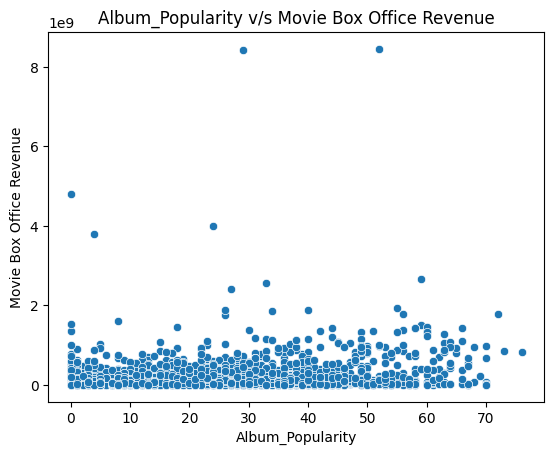

Correlation Coefficient: 0.32527841141020614
p-value: 1.687603488230545e-67
Track_Duration


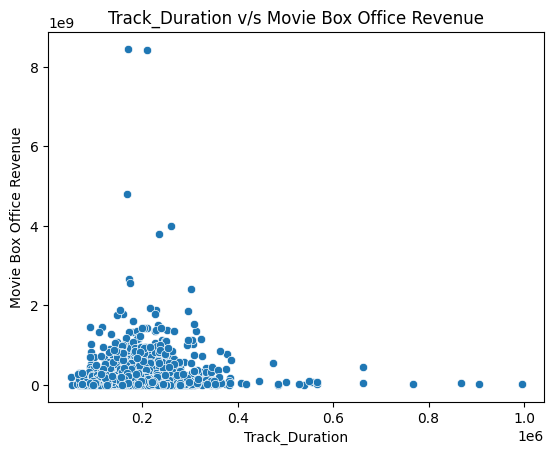

Correlation Coefficient: 0.08094776468758226
p-value: 2.5674068965230125e-05
Track_Acousticness


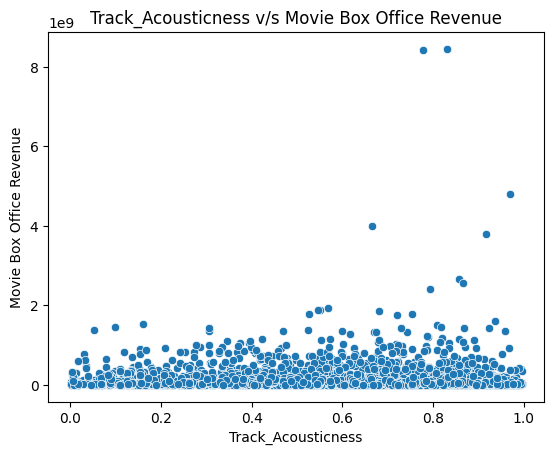

Correlation Coefficient: -0.0742157750686447
p-value: 0.00011443285430749278
Track_Danceability


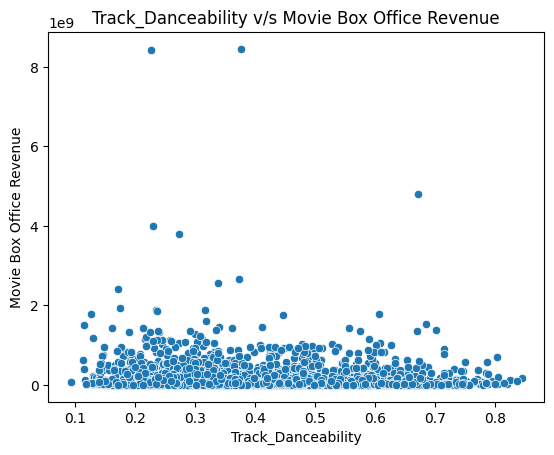

Correlation Coefficient: -0.05665858905676252
p-value: 0.0032459607234760503
Track_Energy


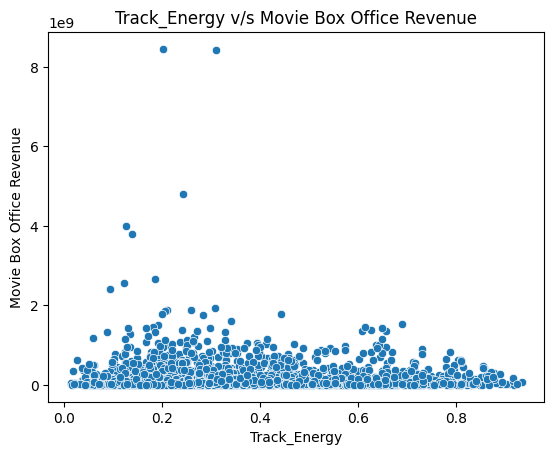

Correlation Coefficient: 0.0573714467652747
p-value: 0.0028775474292411216
Track_Instrumentalness


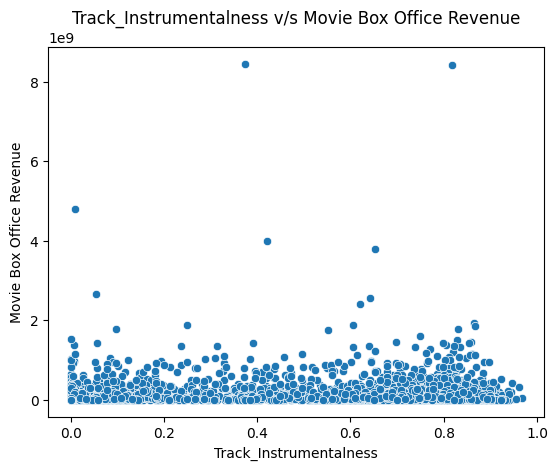

Correlation Coefficient: 0.006582423898299725
p-value: 0.7325857498096033
Track_Liveness


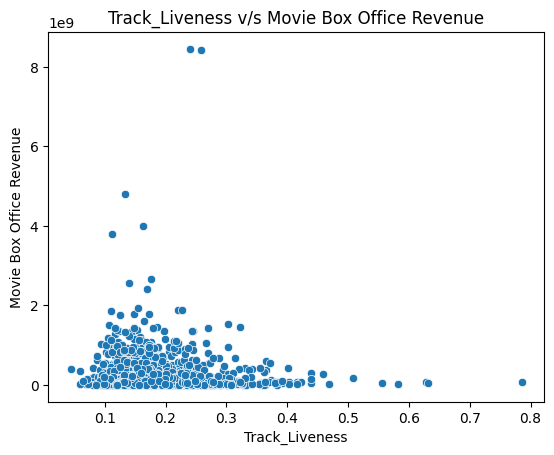

Correlation Coefficient: 0.11689136822780218
p-value: 1.1394055953953435e-09
Track_Speechiness


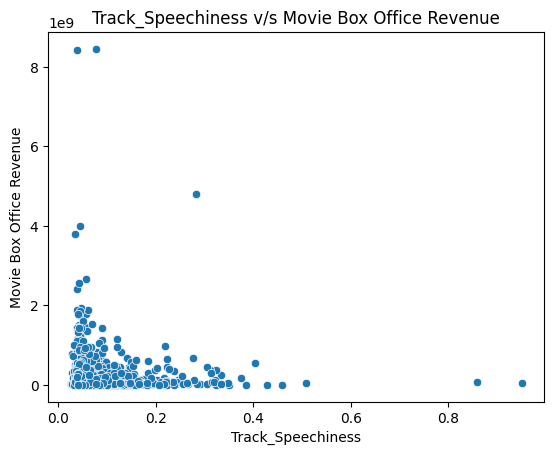

Correlation Coefficient: 0.004536213233115902
p-value: 0.8138442935274565
Track_Tempo


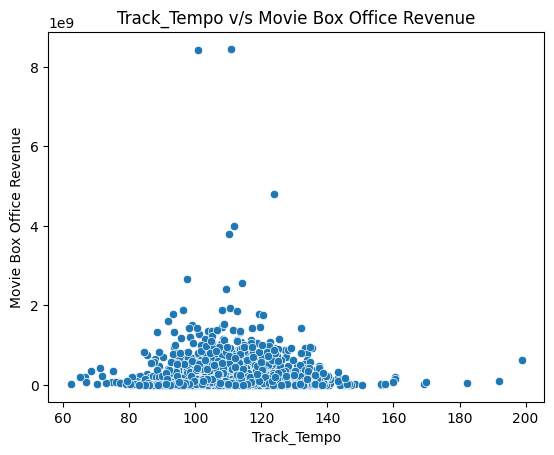

Correlation Coefficient: 0.02290524284966032
p-value: 0.23438674808161167


In [151]:
#Plot the different music features to the Movie Box Office Revenue. We check if they are correlated with the Spearsmans correlation coefficient and display the results. We then define the correlated features 
import scipy.stats
features_correlated = []
for i in toplot.columns:
    print(i)
    scatter(data=movies_with_box_office_revenue_and_music_data, x=i, y="Movie_Box_Office_Revenue", ylabel="Movie Box Office Revenue", xlabel= i, title=f"{i} v/s Movie Box Office Revenue")
    stat, p_value = scipy.stats.spearmanr(movies_with_box_office_revenue_and_music_data[i],movies_with_box_office_revenue_and_music_data['Movie_Box_Office_Revenue'])
    print(f'Correlation Coefficient: {stat}')
    print(f'p-value: {p_value}')
    if p_value < 0.05:
        features_correlated.append(i)

In [152]:
#Display correlated features
features_correlated

['Album_Popularity',
 'Track_Duration',
 'Track_Acousticness',
 'Track_Danceability',
 'Track_Energy',
 'Track_Liveness']

The above music features are correlated with the box office revenue of a movie and hence, are potential determinants of a movie's success. Let's us now look at them more closely.

### Thresholding, T-Tests and Confidence Intervals
<a id="19"></a>


In [153]:
#Define threshold
threshold_arr = [0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
threshold_sig = []

To do this, we experiment with a threshold between 0.3 to 0.9 in steps of 0.1 and form treatment and control groups according to the quantile of the feature at the threshold. We then determine if there is a significant difference in the Movie Box Office Revenue between the control and the treatment group (i.e. CIs that remain above zero). If this is the case, we store this threshold. We then choose the threshold with the greatest difference in the Mean Box Office Revenue between the treatment and control groups, with checking that the limits of the confidence interval aren't negative. With this procedure we obtain the optimal thresholds. 

In [154]:
# define a function bootstrap_confidence_interval. It uses the bootstrapping method to determine the confidence interval of the differences in the mean box office revenues
# of the treatment and the control group array. The difference in the mean box office revenues is stored, and the threshhold with the highes difference is used in the end. 
# If any limit of the CI is negative, this threshhold is removed
def bootstrap_confidence_interval(data1, data2, iterations=1000):
    mean_diffs = []
    observed_diff = np.mean(data1) - np.mean(data2)

    for _ in range(iterations):
        bootstrap_sample1 = np.random.choice(data1, size=len(data1), replace=True)
        bootstrap_sample2 = np.random.choice(data2, size=len(data2), replace=True)

        mean_bootstrap_sample1 = np.mean(bootstrap_sample1)
        mean_bootstrap_sample2 = np.mean(bootstrap_sample2)

        diff = mean_bootstrap_sample1 - mean_bootstrap_sample2

        mean_diffs.append(diff)

    lower_limit, upper_limit = np.percentile(mean_diffs, [2.5, 97.5])
    return lower_limit, upper_limit

In [155]:
# Loop through features and thresholds
threshold_sig = {}
final_thresholds = {}
significant_thresholds_mean_revenue_diff  = []

for i in features_correlated:
    significant_thresholds = []

    for j in threshold_arr:
        movies_with_box_office_revenue_and_music_data_copy = movies_with_box_office_revenue_and_music_data.copy()
        movies_with_box_office_revenue_and_music_data_copy[i] = (movies_with_box_office_revenue_and_music_data_copy[i] > movies_with_box_office_revenue_and_music_data_copy[i].quantile(j)).astype(int)
        
        treatment = movies_with_box_office_revenue_and_music_data_copy['Movie_Box_Office_Revenue'][movies_with_box_office_revenue_and_music_data_copy[i] == 0]
        control = movies_with_box_office_revenue_and_music_data_copy['Movie_Box_Office_Revenue'][movies_with_box_office_revenue_and_music_data_copy[i] == 1]

        
        highest_threshold = 0
        t_statistic, p_value = scipy.stats.ttest_ind(treatment, control)

        # Take only threshhold where statistically significant
        if p_value < 0.05:
            lower_limit, upper_limit = bootstrap_confidence_interval(control, treatment)
            if lower_limit < 0:
                break

            try_diff = abs(control.mean() - treatment.mean())
            
            if try_diff > highest_threshold:
                highest_threshold = try_diff  
                final_thresholds[i] = j

            significant_thresholds.append(j)

        if significant_thresholds:
            threshold_sig[i] = significant_thresholds
            
print(threshold_sig)
print(final_thresholds)

{'Album_Popularity': [0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9], 'Track_Duration': [0.3, 0.4, 0.5, 0.6, 0.7], 'Track_Liveness': [0.3, 0.4, 0.5, 0.6]}
{'Album_Popularity': 0.9, 'Track_Duration': 0.7, 'Track_Liveness': 0.6}


In [156]:
#Convert the categories where the thresholds were taken to a list and print them
final_features_correlated=list(final_thresholds.keys())
print(final_features_correlated)

['Album_Popularity', 'Track_Duration', 'Track_Liveness']


### Paired Matching
<a id="20"></a>

To establish causal links, we need to neutralize the effect of potential confounders (runtime, year of release, language and country (we have seen that genre doesn't influence on music features)) using paired matching. 

In [157]:
paired_matching=movies_with_box_office_revenue_and_music_data.copy()
for i in final_features_correlated:
    paired_matching[i+"_treatment"] = paired_matching[i].apply(lambda x: int(x > final_thresholds[i]))

display(paired_matching)

,Wikipedia_Movie_ID,Movie_Name,Movie_Release_Date,Movie_Box_Office_Revenue,Movie_Runtime,Movie_Genres,Movie_Release_Year,Album_Popularity,Track_Duration,Track_Acousticness,...,Track_Liveness,Track_Loudness,Track_Speechiness,Track_Tempo,Track_Valence,num_movies_languages,num_movies_countries,Album_Popularity_treatment,Track_Duration_treatment,Track_Liveness_treatment
0,77856,Mary Poppins,1964-08-27,965504029,139.0,"[Children's/Family, Musical, Fantasy, Comedy, ...",1964.0,50.0,233823.500000,0.784611,...,0.167933,-19.369667,0.218728,107.623778,0.480222,1,1,1,1,0
1,6305925,The Astronaut Farmer,2006-10-15,16158285,104.0,"[Science Fiction, Americana, Drama, Adventure,...",2006.0,3.0,127108.032258,0.862129,...,0.124184,-19.348581,0.040452,99.217839,0.099100,2,1,1,1,0
2,196176,Straw Dogs,1971-11-03,80561981,118.0,"[Thriller, Drama]",1971.0,1.0,116179.444444,0.673944,...,0.129556,-19.732370,0.042763,108.229370,0.039748,1,2,1,1,0
3,336846,Grease,1978-06-16,1771145761,225.0,"[Romantic comedy, LGBT, Musical, Comedy, Roman...",1978.0,72.0,159041.333333,0.526879,...,0.148725,-12.439667,0.057233,119.415208,0.651596,1,1,1,1,0
4,1940449,RoboCop 3,1993-11-05,21468117,105.0,"[Crime Fiction, Thriller, Science Fiction, Sup...",1993.0,3.0,190122.777778,0.718444,...,0.135122,-19.849333,0.041233,116.468778,0.040211,1,1,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2721,2472440,Turbulence,1997-01-10,21038767,101.0,"[Thriller, Disaster, Action, Action/Adventure]",1997.0,1.0,190176.565217,0.753913,...,0.118374,-16.447783,0.040657,91.204696,0.048643,1,1,1,1,0
2722,22427855,Adam,2009-01-20,3477976,99.0,"[Indie, Comedy-drama, Drama, Comedy, Romantic ...",2009.0,8.0,278719.600000,0.337200,...,0.117800,-8.753600,0.048580,138.392600,0.443000,1,1,1,1,0
2723,303933,Twister,1996-05-10,922304422,113.0,"[Action/Adventure, Disaster]",1996.0,35.0,254169.285714,0.209633,...,0.236143,-7.864643,0.054950,129.027714,0.430350,1,1,1,1,0
2724,25920477,Source Code,2011-03-11,191685970,93.0,"[Thriller, Science Fiction, Action/Adventure, ...",2011.0,0.0,155110.666667,0.756333,...,0.099600,-25.713667,0.038100,124.033000,0.052833,1,2,0,1,0


In [158]:
def get_similarity(propensity_score1, propensity_score2):
    '''Calculate similarity for instances with given propensity scores
        (given function from ADA exercices)
    '''
    return 1-np.abs(propensity_score1-propensity_score2)

def propensity_matching(paired_matching_original,MAIN_DATA_PATH,treatment,MATCH=False):
    """
    Apply pair matching if logit regression is converging.
    Return True if the logit regression is converging, otherwise False and treated_df and control_df are null.
    If return True, it return treated_df and control_df, two samples from the orgininal dataframe containing rows with similar propensity scores (>0.95) towards a specific attribute.
    
    
    Parameters:
    - paired_matching_original (DataFrame): The original dataFrame containing the data.
    - MAIN_DATA_PATH (str): The path where to save or read the balanced sample.
    - treatment (str): Column of the dataframe, corresponding to the music feature on which we want the pair matching.
    - MATCH (bool, optional) : False by default, boolean variable that indicates if we want to recalculate the pair matching (it takes time) or if we want to read existing treated and control dataframes. 
    """
    
    
    print("--------------------------------------------\n"+treatment+" pair matching : \n--------------------------------------------")
    
    #standardisation of independant variables before applying logit regression.
    paired_matching=paired_matching_original.copy().reset_index()
    paired_matching["Movie_Runtime"]=(paired_matching["Movie_Runtime"]-paired_matching["Movie_Runtime"].mean())/paired_matching["Movie_Runtime"].std()
    paired_matching["Movie_Release_Year"]=(paired_matching["Movie_Release_Year"]-paired_matching["Movie_Release_Year"].mean())/paired_matching["Movie_Release_Year"].std()
    paired_matching["num_movies_languages"]=(paired_matching["num_movies_languages"]-paired_matching["num_movies_languages"].mean())/paired_matching["num_movies_languages"].std()
    paired_matching["num_movies_countries"]=(paired_matching["num_movies_countries"]-paired_matching["num_movies_countries"].mean())/paired_matching["num_movies_countries"].std()
    
    
    # logit regression for the music feature
    formula = treatment + " ~  Movie_Runtime + num_movies_languages + num_movies_countries + Movie_Release_Year"
    
    mod = smf.logit(formula=formula, data=paired_matching)
    
    try:
        res = mod.fit()
    except Exception as e:
        print(e)
        return 0,0,False
    
    print(res)
    
    print(res.summary())
    
    #get propensity score for each row towards the music feature
    paired_matching["propensity_score"] = res.predict(paired_matching)
    
    #path to save or read the balanced sample
    path=MATCHED_TREATMENT_PATH=MAIN_DATA_PATH+"\\balanced_"+treatment+".csv"
    
    if MATCH:
    
        # separate control and treatment dataframe using music feature as condition
        treatment_df = paired_matching[paired_matching[treatment] == 1]
        control_df = paired_matching[paired_matching[treatment] == 0]
    
        # Create an empty undirected graph
        G = nx.Graph()
    
        # Loop through all the rows of the two dataframes
        for control_id, control_row in control_df.iterrows():
            for treatment_id, treatment_row in treatment_df.iterrows():
    
                # Calculate the similarity
                similarity = get_similarity(control_row["propensity_score"], treatment_row["propensity_score"])
    
                if (similarity > 0.95):
                    # Add an weighted (by similarity) edge between the two rows
                    G.add_weighted_edges_from([(control_id, treatment_id, similarity)])
    
        #Get the maximum weight matching
        matching = nx.max_weight_matching(G)
    
        # collect matched rows
        matched = [i[0] for i in list(matching)] + [i[1] for i in list(matching)]
    
        # create the balanced dataset and save it 
        balanced_df = paired_matching_original.iloc[matched].copy()
        balanced_df.to_csv(path, index=False)
    
    # read the balanced dataframe already computed to avoid running the matching computation 
    if not MATCH:
        balanced_df = pd.read_csv(path)
        
    
    # split the balanced dataframe into treated and control dataframe
    treated_df = balanced_df.loc[balanced_df[treatment] == 1]
    control_df = balanced_df.loc[balanced_df[treatment] == 0]
    
    
    return treated_df, control_df, True

0
--------------------------------------------
Album_Popularity_treatment pair matching : 
--------------------------------------------
Optimization terminated successfully.
         Current function value: 0.349003
         Iterations 7
                               Logit Regression Results                               
Dep. Variable:     Album_Popularity_treatment   No. Observations:                 2697
Model:                                  Logit   Df Residuals:                     2692
Method:                                   MLE   Df Model:                            4
Date:                        Fri, 22 Dec 2023   Pseudo R-squ.:                 0.02165
Time:                                23:34:38   Log-Likelihood:                -941.26
converged:                               True   LL-Null:                       -962.09
Covariance Type:                    nonrobust   LLR p-value:                 1.967e-08
                           coef    std err          z      P>|z|  

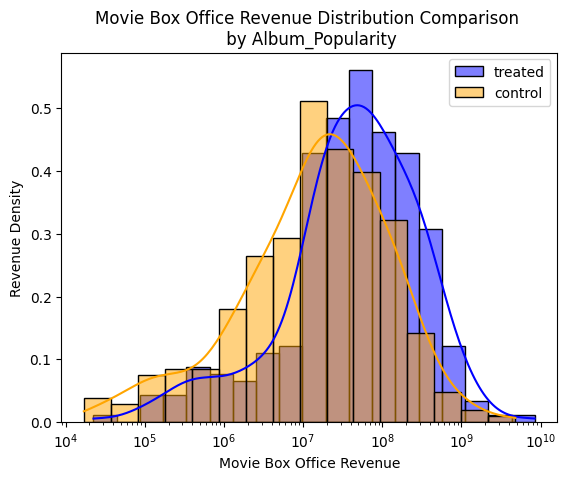

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


1
--------------------------------------------
Track_Duration_treatment pair matching : 
--------------------------------------------
         Current function value: 0.000000
         Iterations: 35
                              Logit Regression Results                              
Dep. Variable:     Track_Duration_treatment   No. Observations:                 2697
Model:                                Logit   Df Residuals:                     2692
Method:                                 MLE   Df Model:                            4
Date:                      Fri, 22 Dec 2023   Pseudo R-squ.:                     inf
Time:                              23:37:00   Log-Likelihood:            -9.6499e-09
converged:                            False   LL-Null:                        0.0000
Covariance Type:                  nonrobust   LLR p-value:                     1.000
                           coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------

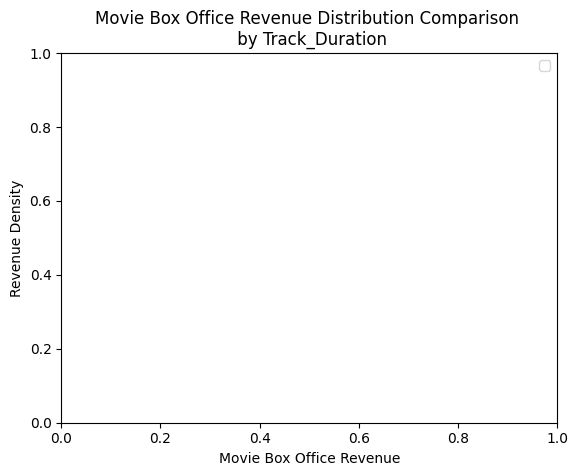

2
--------------------------------------------
Track_Liveness_treatment pair matching : 
--------------------------------------------
Optimization terminated successfully.
         Current function value: 0.007573
         Iterations 12
                              Logit Regression Results                              
Dep. Variable:     Track_Liveness_treatment   No. Observations:                 2697
Model:                                Logit   Df Residuals:                     2692
Method:                                 MLE   Df Model:                            4
Date:                      Fri, 22 Dec 2023   Pseudo R-squ.:                  0.1272
Time:                              23:37:00   Log-Likelihood:                -20.425
converged:                             True   LL-Null:                       -23.402
Covariance Type:                  nonrobust   LLR p-value:                    0.2026
                           coef    std err          z      P>|z|      [0.025      0

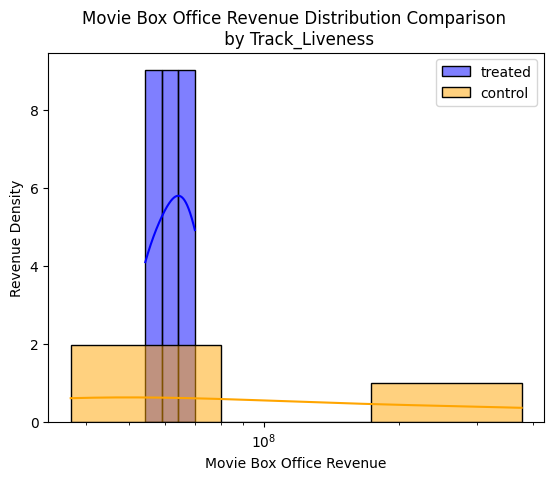

In [159]:
final_features_correlated = ['Album_Popularity', 'Track_Duration' , 'Track_Liveness']

control_df_name=[0]*len(final_features_correlated)
treated_df_name=[0]*len(final_features_correlated)
for i in range(len(final_features_correlated)):
    control_df_name[i]="control_df_"+final_features_correlated[i]
    treated_df_name[i]="treated_df_"+final_features_correlated[i]
    
    
for i in range(len(final_features_correlated)):
    print(i)
    treated_df_name[i], control_df_name[i]=0,0
    treated_df_name[i], control_df_name[i], res_available =propensity_matching(paired_matching,MAIN_DATA_PATH,final_features_correlated[i]+"_treatment",MATCH=True)
    if res_available == False:
        continue 
        
    ax = sns.histplot(treated_df_name[i]['Movie_Box_Office_Revenue'], kde=True, stat='density', color='blue',  label='treated', log_scale = True)
    ax = sns.histplot(control_df_name[i]['Movie_Box_Office_Revenue'], kde=True, stat='density', color='orange',  label='control', log_scale = True)
    ax.set(title='Movie Box Office Revenue Distribution Comparison \n by '+final_features_correlated[i],xlabel='Movie Box Office Revenue', ylabel='Revenue Density')
    plt.legend()
    plt.show()
    
    #commented since used to produce interactive plots
    #fig = go.Figure()
    #fig.add_trace(go.Histogram(
        #x=np.log(treated_df_name[i]['Movie_Box_Office_Revenue']),
        #histnorm='density',
        #name='treated',
        #marker_color='#EB89B5',
        #opacity=0.75
    #))
    #fig.add_trace(go.Histogram(
        #x=np.log(control_df_name[i]['Movie_Box_Office_Revenue']),
        #histnorm='density',
        #name='control',
        #marker_color='#330C73',
        #opacity=0.75
    #))

    #fig.update_layout(

        #title_text='Movie Box Office Revenue Distribution Comparison By '+ final_features_correlated[i].replace('_',' '), 
        #xaxis_title_text='Movie Box Office Revenue (log($))', 
        #yaxis_title_text='Density', 
    #)
    
    #title = 'success_' + final_features_correlated[i]
    
    #filename = slugify(title) + ".html"

    # Automatically create the 'images' folder if it doesn't exist
    #os.makedirs("images", exist_ok=True)
    
    # Append the folder path to the filename
    #full_filename = os.path.join("images_new", filename)

    # Save the plot as an HTML file
    #fig.write_html(full_filename)
    

For the album averaged track duration, results showed that there was incomplete separation or perfect prediction because of which the Maximum Likelihood Estimator didn’t exist and the propensity scores couldn’t be determined.
However, for the album popularity and album averaged track liveness, the propensity scores could be determined.

From the box office revenue distributions shown above, we can now say that a movie whose music comes from a very popular album will have statistically better revenues. The same for movie whose music has lower liveness. To some extent, we can can also say that album popularity consists of a mix of various music features (some with low values and some with high values) and hence, a comprehensive mix of music features which is popular in the eyes of the public earns brownie points for the movies! Thus, we can say that **POPULAR** music drives movies towards success! 